# *The project* :: Houses Prices Regression  Project.

* Regression ML algo ::
    * Its one of the Most Efficient Supervised ML Algo Which its data labelled into input and output data.
    * Used For Regression and Predict Numerical Countinouse data.
    * The are Multiple ML Aglo used For Regressioin ::
        * Linear_Regression.
        * Lasso.
        * Ridge.
        * SVR.
        * Deciction_Tree_Regressor.
        * Random_forest_Regression.
        * XGBoost_Regressor.
        

# Summary
In this notebook you discovered the linear regression algorithm for machine learning.

You covered a lot of ground including:

- The common  regression models (Ridge, Lasso, ElasticNet, ...).
- The representation used by the model.
- Learning algorithms used to estimate the coefficients in the model.
- Rules of thumb to consider when preparing data for use with  regression.
- How to evaluate a  regression model.


## References:
- [Scikit-learn library](https://scikit-learn.org/stable/supervised_learning.html#supervised-learning)
- [Linear Regression for Machine Learning by Jason Brownlee PhD](https://machinelearningmastery.com/linear-regression-for-machine-learning/)

# -  Describtion of Project ::

* Describtion of project ::
    *************************
    * Business_Domain ::
         * Any Business Want To Maximize The Numbers of CLients.
         * That Not Based on Attract New ones Only But Bases also on Retaining the Existing ones.
         * The Current or old Clients Will Cost the Company Less Than The New_Clients
         * The New_Clients Weekly interested in Business Servicies and They consider difficult to work with it But The Retain Clients have the necessary knowldge and info Towardes the Business services.
    * Dataset :: 
         * We Have data belongings to Houses_Prices Services Which Present The Behaviour of the Houses_attributies with its Prices. 
         * We Have dataset from a Sales Houses company. The data contains information about almost Thousand Houses, their demographic characteristics, the Houses bedrooms, bathrooms, Floors, Numbers , sqft_living , sqft_lot , View , Waterfont , grade , year_Bulid , year_renovated , Zipcodes and Sales_Prices of Houses 
         * We Must Known That  Task of Attract New_Clients More difficulte and need more efforts Than thae task of Keep the old Clients who Use Our Business Servicies.
    * Tasks ::
        * *Apply EDA Technice To* :: Describe The Behavior of the data For Extractng Meaningfull Knowledge , insights and Vision From That data To Make The Steckholders of our Business Make More Efficient Decision Which improve and develop The Business
        * Research Of dependences and Formulation of Hypothess.
        * Built ML Model For Predciting New_Values of Houses_Price.
        * Get High Accuracy From the Model Performance To improve Our Business .

# (1) :: Importing Requries Liberaries and Framworks ::

In [1]:
# Importing Liberaries and Framworks ::
import numpy as np      # Apply Linear_Algebra oerations.
import pandas as pd     # For Loading data and Apply Wrangling and Mainpulating on data.
import seaborn as sns   # For Visualizing data.
import warnings as w    # For Ignoring any Warning.
import missingno as mno # Presnt Precentage of Nan Values.
import datasist as ds   # For Apply EDA and Visualization Using Simple Implementation.
import matplotlib.pyplot as plt # For Set Plots , Charts and Maps Labels and Titl.  
from scipy.stats import norm # To make the distribution of data in normal_distribution.
from scipy import stats  # To apply stats operations on data.
%matplotlib inline      


In [2]:
# To ignore any Warning notification.
w.filterwarnings("ignore") 
# To Set Figsize and font_scaler of Plots , Charts and Maps
sns.set( rc = {"figure.figsize" : [50 , 35]} , font_scale=3.5)

In [3]:
# Loding dataset
df = pd.read_csv("houses.csv")
df

,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,price
0,3.0,1.00,1180.0,5650.0,1.0,0.0,0.0,3.0,7.0,1180.0,0.0,1955.0,0.0,98178.0,47.5112,-122.257,1340.0,22.190
1,3.0,2.25,2570.0,7242.0,2.0,0.0,0.0,3.0,7.0,2170.0,400.0,1951.0,1991.0,98125.0,47.7210,-122.319,1690.0,53.800
2,2.0,1.00,770.0,10000.0,1.0,0.0,0.0,3.0,6.0,770.0,0.0,1933.0,0.0,98028.0,47.7379,-122.233,2720.0,18.000
3,4.0,3.00,1960.0,5000.0,1.0,0.0,0.0,5.0,7.0,1050.0,910.0,1965.0,0.0,98136.0,47.5208,-122.393,1360.0,60.400
4,3.0,2.00,1680.0,8080.0,1.0,0.0,0.0,3.0,8.0,1680.0,0.0,1987.0,0.0,98074.0,47.6168,-122.045,1800.0,51.000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
995,4.0,2.50,1860.0,6325.0,2.0,0.0,0.0,4.0,7.0,1860.0,0.0,1991.0,0.0,98038.0,47.3492,-122.030,1860.0,29.100
996,2.0,2.75,1590.0,20917.0,1.5,0.0,0.0,3.0,5.0,1590.0,0.0,1920.0,0.0,98001.0,47.2786,-122.250,1310.0,19.995
997,2.0,1.00,850.0,2340.0,1.0,0.0,0.0,3.0,7.0,850.0,0.0,1922.0,0.0,98105.0,47.6707,-122.328,1300.0,55.350
998,2.0,1.00,1030.0,4188.0,1.0,0.0,0.0,3.0,8.0,1030.0,0.0,1981.0,0.0,98038.0,47.3738,-122.057,1450.0,18.995


* From the Result above we can see some obsrvations ::
    * We have 1000 samples of data.
    * We have 18 features of data.
    * Our Target price of House.
* Data_Features ::
    * *Bedrooms*    :: Number which Fraction value we need to convert it into integer Value.
    * *Bathrooms*   :: Numbers which Fraction value we need to convert it into integer Value.
    * *Sqft_living* :: size of Living area.
    * *sqft_lot*    :: Total size of house area.
    * *floors Number* :: of the house floor which fraction we need to convert it into Integer.
    * *waterfron*     ::t which categorical discrit Number value that refer the house waterfront or not we need to convert it into Integer.
    * *View*          :: which refer to the house View.
    * *condition*     :: which refer to the house condition its Fraction we need to convert it into Integer.
    * *grade*         :: Which refer to the house garde its Fraction we need to cnvert it into Integer.
    * *sqft_above*    :: which refer to the size of area which as same as sqrt_living we need to leave one of them and remove one of them Becouse it will incraese Time of Model Traning .
    * *sqft_basement* :: Which refer to the size of basement.
    * *yr_built*      :: Which refer to the Year Build of the Bulid Creation its Fraction we need to convert it into integer..
    * *yr_renovated*  :: Which refer to the Year Bulid regneration of Bulid its Fraction we need to convert it into integer.
    * *zipcode*       :: Which refer to the Zipcode of the House its Fraction we need to convert it into integer..
    * *lat*           :: Which refer to The Latitude of the houses.
    * *long*          :: Which refer to the Longitude of the houses its value Negative we need to convert it into Positive..
    * *sqft_living15* :: Which refer to the sqft_living15 of houses its Fraction valuse we need toconvert its value into Integer..
    

# *(EDA)* :: Exploratory Data Analysis::
**************************************************
 * Its One of the most important Pase on data Scientist Life_Cycle to identify the Behaviour of data to extract meaningfull Knowledge , insights and Visions from that data to help Steckholders to make more efficient decision to imporove and enhance The Business.

# (2) :: Statitstical_Data_Analysis_Process ::

In [4]:
# Present the dataset columns
df.columns

Index(['bedrooms', 'bathrooms', 'sqft_living', 'sqft_lot', 'floors',
       'waterfront', 'view', 'condition', 'grade', 'sqft_above',
       'sqft_basement', 'yr_built', 'yr_renovated', 'zipcode', 'lat', 'long',
       'sqft_living15', 'price'],
      dtype='object')

In [5]:
# Present all info of dataset .
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1000 entries, 0 to 999
Data columns (total 18 columns):
bedrooms         999 non-null float64
bathrooms        999 non-null float64
sqft_living      999 non-null float64
sqft_lot         999 non-null float64
floors           999 non-null float64
waterfront       999 non-null float64
view             999 non-null float64
condition        999 non-null float64
grade            999 non-null float64
sqft_above       999 non-null float64
sqft_basement    999 non-null float64
yr_built         999 non-null float64
yr_renovated     999 non-null float64
zipcode          999 non-null float64
lat              999 non-null float64
long             999 non-null float64
sqft_living15    999 non-null float64
price            999 non-null float64
dtypes: float64(18)
memory usage: 140.8 KB


* from the Result above we can see some observation ::
    * We have 1000 samples or Record of data.
    * we have 18 Features of data.
    * we see there not Missing data values .
       * Becouse Numbers of non_Null of all Features equalize the orginal numbers of samples.
    * There are Feature as dtype float instesd of Integer dtype.
    

In [6]:
# Present all columns Name , unique_numbers and value_counts of that columns.
for col in df.columns :
    print(f"The Col ({col})\n\nThe unique_Values of :: ({col}) :: {df[col].unique()}\n\nThe value_Counts \
f ({col}) :: \n{df[col].value_counts()}\n-------------\n------------------")

The Col (bedrooms)

The unique_Values of :: (bedrooms) :: [ 3.  2.  4.  5.  1.  6.  7.  0. nan]

The value_Counts f (bedrooms) :: 
3.0    491
4.0    305
2.0    114
5.0     69
6.0     11
1.0      7
0.0      1
7.0      1
Name: bedrooms, dtype: int64
-------------
------------------
The Col (bathrooms)

The unique_Values of :: (bathrooms) :: [1.   2.25 3.   2.   4.5  1.5  2.5  1.75 2.75 3.25 4.   3.5  0.75 4.75
 5.   4.25 3.75 0.   1.25  nan]

The value_Counts f (bathrooms) :: 
2.50    238
1.00    187
1.75    159
2.25    104
2.00     98
1.50     61
2.75     51
3.00     33
3.50     28
3.25     18
0.75      6
4.00      4
4.25      4
4.50      2
5.00      2
0.00      1
4.75      1
3.75      1
1.25      1
Name: bathrooms, dtype: int64
-------------
------------------
The Col (sqft_living)

The unique_Values of :: (sqft_living) :: [1180. 2570.  770. 1960. 1680. 5420. 1715. 1060. 1780. 1890. 3560. 1160.
 1430. 1370. 1810. 2950. 1600. 1200. 1250. 1620. 3050. 2270. 1070. 2450.
 1710. 1400. 1520. 

* From the Result we can see some observations ::
    * Bedrooms :: include zero which non_logic_data_value  , nan_values and its value Fraction that not logic.
    * Bathrooms :: include Fraction_values and nan_values.
    * Sqft_Living :: include Fraction_Values and nan_values.
    * Sqft_lot  :: include Fraction_Values.
    * Floor :: include Fraction_Values and nan_values.
    * Waterfront :: include Fraction_values and nan_values.
    * View :: include Fraction_Values and nan_values.
    * Basement :: include Fraction _values , nan_values and zero values.
    * year_Bulid :: nclude Fraction_values and nan_values.
    * year_renovated :: include Fraction_values and nan_values.
    * Sqft_above :: That column must removed becous its useles features which is reapeted col have the same values of Sqft_Living that means its present he same entity.
    * Zipcode :: include Fracton Values and nan_values.
    * Latitude :: includenan_values only.
    * Logitude :: include Negative_values and nan_valus.
    

In [7]:
# present ther Statistical_describtion of Numerical_features.
df.describe(include = "number")

,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,price
count,999.000000,999.000000,999.000000,999.000000,999.000000,999.000000,999.000000,999.000000,999.000000,999.000000,999.000000,999.000000,999.000000,999.000000,999.000000,999.000000,999.000000,999.000000
mean,3.349349,2.045796,2051.397397,14707.242242,1.446947,0.008008,0.237237,3.464464,7.605606,1750.233233,301.164164,1969.030030,81.830831,98074.441441,47.549720,-122.207406,1986.813814,52.071452
std,0.852367,0.721983,888.351113,28975.077254,0.517420,0.089173,0.765472,0.689521,1.160734,790.466905,451.023402,28.198607,395.767918,52.545832,0.141558,0.139564,670.723475,33.974907
min,0.000000,0.000000,380.000000,649.000000,1.000000,0.000000,0.000000,1.000000,4.000000,380.000000,0.000000,1900.000000,0.000000,98001.000000,47.177500,-122.490000,830.000000,8.000000
25%,3.000000,1.500000,1405.000000,5419.000000,1.000000,0.000000,0.000000,3.000000,7.000000,1190.000000,0.000000,1952.000000,0.000000,98032.000000,47.443000,-122.322500,1490.000000,30.980000
50%,3.000000,2.000000,1900.000000,8040.000000,1.000000,0.000000,0.000000,3.000000,7.000000,1540.000000,0.000000,1974.000000,0.000000,98058.000000,47.563600,-122.218000,1850.000000,43.500000
75%,4.000000,2.500000,2475.000000,11508.500000,2.000000,0.000000,0.000000,4.000000,8.000000,2135.000000,580.000000,1992.000000,0.000000,98116.000000,47.673400,-122.118000,2360.000000,63.446250
max,7.000000,5.000000,6070.000000,315374.000000,3.500000,1.000000,4.000000,5.000000,12.000000,6070.000000,2060.000000,2015.000000,2014.000000,98199.000000,47.777600,-121.709000,4760.000000,308.000000


In [8]:
# present ther Statistical_describtion of Numerical_features.
df.describe()

,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,price
count,999.000000,999.000000,999.000000,999.000000,999.000000,999.000000,999.000000,999.000000,999.000000,999.000000,999.000000,999.000000,999.000000,999.000000,999.000000,999.000000,999.000000,999.000000
mean,3.349349,2.045796,2051.397397,14707.242242,1.446947,0.008008,0.237237,3.464464,7.605606,1750.233233,301.164164,1969.030030,81.830831,98074.441441,47.549720,-122.207406,1986.813814,52.071452
std,0.852367,0.721983,888.351113,28975.077254,0.517420,0.089173,0.765472,0.689521,1.160734,790.466905,451.023402,28.198607,395.767918,52.545832,0.141558,0.139564,670.723475,33.974907
min,0.000000,0.000000,380.000000,649.000000,1.000000,0.000000,0.000000,1.000000,4.000000,380.000000,0.000000,1900.000000,0.000000,98001.000000,47.177500,-122.490000,830.000000,8.000000
25%,3.000000,1.500000,1405.000000,5419.000000,1.000000,0.000000,0.000000,3.000000,7.000000,1190.000000,0.000000,1952.000000,0.000000,98032.000000,47.443000,-122.322500,1490.000000,30.980000
50%,3.000000,2.000000,1900.000000,8040.000000,1.000000,0.000000,0.000000,3.000000,7.000000,1540.000000,0.000000,1974.000000,0.000000,98058.000000,47.563600,-122.218000,1850.000000,43.500000
75%,4.000000,2.500000,2475.000000,11508.500000,2.000000,0.000000,0.000000,4.000000,8.000000,2135.000000,580.000000,1992.000000,0.000000,98116.000000,47.673400,-122.118000,2360.000000,63.446250
max,7.000000,5.000000,6070.000000,315374.000000,3.500000,1.000000,4.000000,5.000000,12.000000,6070.000000,2060.000000,2015.000000,2014.000000,98199.000000,47.777600,-121.709000,4760.000000,308.000000


# (3) :: Wrangling and Mainpluting data

In [9]:
# Get The Record Of the House which max price ::
df[df["price"] == df["price"].max()]

,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,price
300,4.0,5.0,4550.0,18641.0,1.0,1.0,4.0,3.0,10.0,2600.0,1950.0,2002.0,0.0,98074.0,47.6053,-122.077,4550.0,308.0


In [10]:
# Get The Num of bedrooms Of the House which max price ::
df[df["price"] == df["price"].max()]["bedrooms"]

300    4.0
Name: bedrooms, dtype: float64

In [11]:
# Get The Num of bathrooms Of the House which max price ::
df[df["price"] == df["price"].max()]["bathrooms"]

300    5.0
Name: bathrooms, dtype: float64

In [12]:
# Get The Num of sqft_living Of the House which max price ::
df[df["price"] == df["price"].max()]["sqft_living"]

300    4550.0
Name: sqft_living, dtype: float64

In [13]:
# Get The Num of sqft_lot Of the House which max price ::
df[df["price"] == df["price"].max()]["sqft_lot"]

300    18641.0
Name: sqft_lot, dtype: float64

In [14]:
# Get The Num of floors Of the House which max price ::
df[df["price"] == df["price"].max()]["floors"]

300    1.0
Name: floors, dtype: float64

In [15]:
# Get The Num of waterfront Of the House which max price ::
df[df["price"] == df["price"].max()]["waterfront"]

300    1.0
Name: waterfront, dtype: float64

In [16]:
# Get The Num of view Of the House which max price ::
df[df["price"] == df["price"].max()]["view"]

300    4.0
Name: view, dtype: float64

In [17]:
# Get The Num of grade Of the House which max price ::
df[df["price"] == df["price"].max()]["grade"]

300    10.0
Name: grade, dtype: float64

In [18]:
# Get The Num of sqft_basement Of the House which max price ::
df[df["price"] == df["price"].max()]["sqft_basement"]

300    1950.0
Name: sqft_basement, dtype: float64

In [19]:
# Get The Num of yr_built Of the House which max price ::
df[df["price"] == df["price"].max()]["yr_built"]

300    2002.0
Name: yr_built, dtype: float64

In [20]:
# Get The Num of yr_renovated Of the House which max price ::
df[df["price"] == df["price"].max()]["yr_renovated"]

300    0.0
Name: yr_renovated, dtype: float64

In [21]:
# Get The Num of zipcode Of the House which max price ::
df[df["price"] == df["price"].max()]["zipcode"]

300    98074.0
Name: zipcode, dtype: float64

In [22]:
# Get The Num of lat Of the House which max price ::
df[df["price"] == df["price"].max()]["lat"]

300    47.6053
Name: lat, dtype: float64

In [23]:
# Get The Num of long Of the House which max price ::
df[df["price"] == df["price"].max()]["long"]

300   -122.077
Name: long, dtype: float64

In [24]:
# Get The Num of sqft_living15 Of the House which max price ::
df[df["price"] == df["price"].max()]["sqft_living15"]

300    4550.0
Name: sqft_living15, dtype: float64

In [25]:
# Get The Record Of the House which min price ::
df[df["price"] == df["price"].min()]

,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,price
465,1.0,0.75,430.0,5050.0,1.0,0.0,0.0,2.0,4.0,430.0,0.0,1912.0,0.0,98014.0,47.6499,-121.909,1200.0,8.0


In [26]:
# Get The Num of bedrooms Of the House which max price ::
df[df["price"] == df["price"].min()]["bedrooms"]

465    1.0
Name: bedrooms, dtype: float64

In [27]:
# Get The Num of bathrooms Of the House which max price ::
df[df["price"] == df["price"].min()]["bathrooms"]

465    0.75
Name: bathrooms, dtype: float64

In [28]:
# Get The Num of sqft_living Of the House which max price ::
df[df["price"] == df["price"].min()]["sqft_living"]

465    430.0
Name: sqft_living, dtype: float64

In [29]:
# Get The Num of sqft_lot Of the House which max price ::
df[df["price"] == df["price"].min()]["sqft_lot"]

465    5050.0
Name: sqft_lot, dtype: float64

In [30]:
# Get The Num of floors Of the House which max price ::
df[df["price"] == df["price"].min()]["floors"]

465    1.0
Name: floors, dtype: float64

In [31]:
# Get The Num of waterfront Of the House which max price ::
df[df["price"] == df["price"].min()]["waterfront"]

465    0.0
Name: waterfront, dtype: float64

In [32]:
# Get The Num of view Of the House which max price ::
df[df["price"] == df["price"].min()]["view"]

465    0.0
Name: view, dtype: float64

In [33]:
# Get The Num of condition Of the House which max price ::
df[df["price"] == df["price"].min()]["condition"]

465    2.0
Name: condition, dtype: float64

In [34]:
# Get The Num of grade Of the House which max price ::
df[df["price"] == df["price"].min()]["grade"]

465    4.0
Name: grade, dtype: float64

In [35]:
# Get The Num of sqft_basement Of the House which max price ::
df[df["price"] == df["price"].min()]["sqft_basement"]

465    0.0
Name: sqft_basement, dtype: float64

In [36]:
# Get The Num of yr_built Of the House which max price ::
df[df["price"] == df["price"].min()]["yr_built"]

465    1912.0
Name: yr_built, dtype: float64

In [37]:
# Get The Num of yr_renovated Of the House which max price ::
df[df["price"] == df["price"].min()]["yr_renovated"]

465    0.0
Name: yr_renovated, dtype: float64

In [38]:
# Get The Num of zipcode Of the House which max price ::
df[df["price"] == df["price"].min()]["zipcode"]

465    98014.0
Name: zipcode, dtype: float64

In [39]:
# Get The Num of lat Of the House which max price ::
df[df["price"] == df["price"].min()]["lat"]

465    47.6499
Name: lat, dtype: float64

In [40]:
# Get The Num of long Of the House which max price ::
df[df["price"] == df["price"].min()]["long"]

465   -121.909
Name: long, dtype: float64

In [41]:
# Get The Num of sqft_living15 Of the House which max price ::
df[df["price"] == df["price"].min()]["sqft_living15"]

465    1200.0
Name: sqft_living15, dtype: float64

In [42]:
df.groupby("floors").describe().transpose()

floors                 1.0         1.5         2.0         2.5        3.0  \
bedrooms count  528.000000   93.000000  354.000000    5.000000  18.000000   
         mean     3.153409    3.612903    3.590395    4.000000   3.000000   
         std      0.820253    0.872680    0.802982    0.707107   0.685994   
         min      1.000000    2.000000    1.000000    3.000000   2.000000   
         25%      3.000000    3.000000    3.000000    4.000000   3.000000   
...                    ...         ...         ...         ...        ...   
price    min      8.000000   17.500000   16.350000   37.900000  28.000000   
         25%     26.868750   37.875000   36.496250   40.560000  44.100000   
         50%     37.800000   48.500000   52.850000   93.000000  51.922500   
         75%     51.275000   66.700000   76.187500  139.000000  62.748750   
         max    308.000000  290.000000  240.000000  225.000000  72.950000   

floors            3.5  
bedrooms count    1.0  
         mean     0.0  
         std      NaN  
         min      0.0  
         25%      0.0  
...               ...  
price    min    110.0  
         25%    110.0  
         50%    110.0  
         75%    110.0  
         max    110.0  

[136 rows x 6 columns]

In [43]:
df.groupby("view").describe().transpose()

view                   0.0         1.0         2.0         3.0         4.0
bedrooms count  899.000000   15.000000   46.000000   26.000000   13.000000
         mean     3.331479    4.133333    3.369565    3.576923    3.153846
         std      0.823661    1.125463    1.082357    0.808608    1.214232
         min      1.000000    3.000000    0.000000    2.000000    1.000000
         25%      3.000000    3.000000    3.000000    3.000000    2.000000
...                    ...         ...         ...         ...         ...
price    min      8.000000   33.500000   26.750000   39.750000   36.990000
         25%     29.945000   61.000000   44.650000   56.125000   84.000000
         50%     41.900000   83.990000   59.125000   71.250000  131.000000
         75%     58.500000  124.000000   90.600000  121.500000  238.000000
         max    225.000000  225.000000  290.000000  225.000000  308.000000

[136 rows x 5 columns]

In [44]:
df.groupby("grade").describe().transpose()

grade             4.0        5.0        6.0         7.0         8.0   \
bedrooms count   2.000  13.000000  91.000000  445.000000  266.000000   
         mean    1.000   2.307692   2.802198    3.231461    3.451128   
         std     0.000   0.947331   0.805809    0.784362    0.791141   
         min     1.000   1.000000   1.000000    0.000000    1.000000   
         25%     1.000   2.000000   2.000000    3.000000    3.000000   
...                ...        ...        ...         ...         ...   
price    min     8.000  13.000000  15.700000   14.750000   18.850000   
         25%    13.475  24.500000  21.000000   27.500000   36.500000   
         50%    18.950  31.500000  27.425000   37.495000   50.050000   
         75%    24.425  42.500000  35.750000   46.600000   64.875000   
         max    29.900  79.500000  61.500000  127.000000  307.000000   

grade                 9.0         10.0        11.0        12.0  
bedrooms count  112.000000   47.000000   18.000000    5.000000  
         mean     3.785714    3.808511    4.444444    4.000000  
         std      0.728179    0.711346    0.983524    0.707107  
         min      2.000000    2.000000    3.000000    3.000000  
         25%      3.000000    3.000000    4.000000    4.000000  
...                    ...         ...         ...         ...  
price    min     25.995000   40.500000   90.000000  110.000000  
         25%     57.787500   79.250000  104.750000  155.000000  
         50%     72.150000   89.000000  129.000000  158.000000  
         75%     88.000000  107.500000  139.500000  213.000000  
         max    240.000000  308.000000  290.000000  225.000000  

[136 rows x 9 columns]

In [45]:
df.groupby("yr_built").describe().transpose()

yr_built           1900.0     1901.0  1902.0  1903.0     1904.0     1905.0  \
bedrooms count   6.000000   2.000000     1.0     1.0   3.000000    5.00000   
         mean    3.333333   3.500000     5.0     3.0   3.666667    3.80000   
         std     1.211060   0.707107     NaN     NaN   0.577350    1.30384   
         min     2.000000   3.000000     5.0     3.0   3.000000    2.00000   
         25%     2.250000   3.250000     5.0     3.0   3.500000    3.00000   
...                   ...        ...     ...     ...        ...        ...   
price    min    48.500000  38.500000    65.0    64.0  41.000000   57.00000   
         25%    53.875000  44.250000    65.0    64.0  42.250000   79.50000   
         50%    58.000000  50.000000    65.0    64.0  43.500000   89.00000   
         75%    61.750000  55.750000    65.0    64.0  53.750000  205.00000   
         max    74.050000  61.500000    65.0    64.0  64.000000  225.00000   

yr_built           1907.0     1908.0    1909.0    1910.0  ...      2006.0  \
bedrooms count   2.000000   5.000000   4.00000   5.00000  ...   13.000000   
         mean    2.500000   2.600000   2.75000   3.20000  ...    3.307692   
         std     0.707107   0.894427   0.50000   1.30384  ...    0.751068   
         min     2.000000   2.000000   2.00000   2.00000  ...    2.000000   
         25%     2.250000   2.000000   2.75000   2.00000  ...    3.000000   
...                   ...        ...       ...       ...  ...         ...   
price    min    43.750000  31.500000  37.50000  42.50000  ...   20.863300   
         25%    48.062500  38.115600  37.78125  49.30000  ...   33.500000   
         50%    52.375000  40.500000  45.56250  54.20000  ...   46.100000   
         75%    56.687500  55.070000  56.61250  85.08300  ...   60.990000   
         max    61.000000  93.000000  66.70000  91.50000  ...  225.000000   

yr_built            2007.0     2008.0     2009.0     2010.0  2011.0  \
bedrooms count    9.000000   8.000000   4.000000   6.000000    1.00   
         mean     2.888889   3.000000   3.000000   2.833333    4.00   
         std      1.166667   0.755929   0.816497   0.752773     NaN   
         min      1.000000   2.000000   2.000000   2.000000    4.00   
         25%      2.000000   2.750000   2.750000   2.250000    4.00   
...                    ...        ...        ...        ...     ...   
price    min     20.000000  25.995000  26.600000  42.000000   85.99   
         25%     37.250000  37.312500  30.650000  55.835000   85.99   
         50%     46.500000  42.200000  33.950000  68.095000   85.99   
         75%     62.500000  44.037500  50.175000  69.585000   85.99   
         max    105.000000  55.700000  93.000000  91.000000   85.99   

yr_built           2012.0   2013.0     2014.0  2015.0  
bedrooms count   3.000000   3.0000  10.000000    1.00  
         mean    3.333333   4.0000   3.500000    3.00  
         std     0.577350   1.0000   0.849837     NaN  
         min     3.000000   3.0000   3.000000    3.00  
         25%     3.000000   3.5000   3.000000    3.00  
...                   ...      ...        ...     ...  
price    min    34.750000  60.4950  37.900000   72.95  
         25%    35.125000  71.2425  52.721250   72.95  
         50%    35.500000  81.9900  59.272700   72.95  
         75%    37.900000  82.9900  79.440575   72.95  
         max    40.300000  83.9900  88.000000   72.95  

[136 rows x 114 columns]

In [46]:
df.groupby("zipcode").describe().transpose()

zipcode          98001.0    98002.0   98003.0     98004.0     98005.0  \
bedrooms count  16.00000   8.000000  16.00000   13.000000    8.000000   
         mean    3.31250   3.000000   3.31250    3.692308    3.750000   
         std     0.60208   0.534522   0.79320    0.854850    0.707107   
         min     2.00000   2.000000   3.00000    2.000000    3.000000   
         25%     3.00000   3.000000   3.00000    3.000000    3.000000   
...                  ...        ...       ...         ...         ...   
price    min    19.60000  18.900000  19.90000   72.750000   48.000000   
         25%    22.22125  21.050000  21.90000   92.700000   63.967500   
         50%    24.15000  22.900000  24.27500  109.000000   81.997500   
         75%    29.15000  23.800000  28.47125  132.000000   90.245000   
         max    48.00000  26.600000  47.20000  290.000000  158.000000   

zipcode            98006.0    98007.0    98008.0    98010.0    98011.0  ...  \
bedrooms count   32.000000   4.000000   9.000000   7.000000  11.000000  ...   
         mean     3.968750   3.750000   4.222222   3.142857   3.636364  ...   
         std      0.860771   0.957427   1.301708   0.377964   0.924416  ...   
         min      2.000000   3.000000   3.000000   3.000000   2.000000  ...   
         25%      3.000000   3.000000   3.000000   3.000000   3.000000  ...   
...                    ...        ...        ...        ...        ...  ...   
price    min     36.500000  43.165000  34.500000  18.500000  27.000000  ...   
         25%     55.567500  46.037500  42.000000  23.550000  38.200000  ...   
         50%     73.350000  56.622500  49.000000  28.834900  45.200000  ...   
         75%    103.500000  69.312500  65.000000  39.750000  54.350000  ...   
         max    225.000000  78.500000  95.100000  72.000000  62.800000  ...   

zipcode           98146.0  98148.0    98155.0    98166.0    98168.0  \
bedrooms count  11.000000    2.000   9.000000   16.00000  13.000000   
         mean    3.090909    3.000   3.111111    3.31250   2.923077   
         std     0.943880    0.000   0.600925    0.79320   0.954074   
         min     2.000000    3.000   2.000000    2.00000   1.000000   
         25%     2.500000    3.000   3.000000    3.00000   2.000000   
...                   ...      ...        ...        ...        ...   
price    min    17.850000   22.800  23.000000   18.02500  17.180000   
         25%    23.625000   24.325  32.999900   28.01875  21.000000   
         50%    33.500000   25.850  40.550000   35.24995  24.500000   
         75%    41.447500   27.375  47.500000   65.12500  26.995000   
         max    57.800000   28.900  55.000000  213.00000  34.050000   

zipcode           98177.0    98178.0    98188.0    98198.0     98199.0  
bedrooms count  10.000000  16.000000   7.000000  14.000000    7.000000  
         mean    3.100000   3.062500   3.000000   2.857143    3.142857  
         std     1.100505   0.928709   0.816497   1.167321    0.899735  
         min     2.000000   2.000000   2.000000   1.000000    2.000000  
         25%     2.000000   2.000000   2.500000   2.000000    3.000000  
...                   ...        ...        ...        ...         ...  
price    min    32.610000  16.500000  13.000000  15.700000   33.100000  
         25%    35.537500  20.156875  23.900000  21.475000   55.425000  
         50%    45.000000  24.245000  24.500000  25.750000   65.000000  
         75%    46.656250  30.292500  26.125000  27.673750  110.000000  
         max    66.000000  44.500000  46.900000  32.500000  145.000000  

[136 rows x 69 columns]

In [47]:
# Create Pivote_Table Using tat data ::

Pivot_T1 = pd.pivot_table(df , index = "yr_built" , columns = "zipcode" , values = "price")
Pivot_T1

zipcode,98001.0,98002.0,98003.0,98004.0,98005.0,98006.0,98007.0,98008.0,98010.0,98011.0,...,98146.0,98148.0,98155.0,98166.0,98168.0,98177.0,98178.0,98188.0,98198.0,98199.0
yr_built,,,,,,,,,,,,,,,,,,,,,
1900.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1901.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1902.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1903.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1904.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2011.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2012.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2013.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [48]:
# Create Pivote_Table Using tat data ::

Pivot_T1 = pd.pivot_table(df , index = "yr_built" , columns = "grade" , values = "price")
Pivot_T1

grade,4.0,5.0,6.0,7.0,8.0,9.0,10.0,11.0,12.0
yr_built,,,,,,,,,
1900.0,NaN,NaN,56.5,55.875,74.050,NaN,NaN,NaN,NaN
1901.0,NaN,NaN,50.0,NaN,NaN,NaN,NaN,NaN,NaN
1902.0,NaN,NaN,NaN,NaN,65.000,NaN,NaN,NaN,NaN
1903.0,NaN,NaN,NaN,NaN,64.000,NaN,NaN,NaN,NaN
1904.0,NaN,NaN,NaN,42.250,64.000,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...
2011.0,NaN,NaN,NaN,NaN,NaN,85.99000,NaN,NaN,NaN
2012.0,NaN,NaN,NaN,NaN,37.900,34.75000,NaN,NaN,NaN
2013.0,NaN,NaN,NaN,NaN,60.495,82.99000,NaN,NaN,NaN


In [49]:
# Create Pivote_Table Using tat data ::

Pivot_T1 = pd.pivot_table(df , index = "yr_built" , columns = "yr_renovated" , values = "price")
Pivot_T1

yr_renovated,0.0,1945.0,1954.0,1957.0,1974.0,1977.0,1978.0,1981.0,1983.0,1984.0,...,1995.0,1999.0,2002.0,2003.0,2005.0,2008.0,2010.0,2011.0,2013.0,2014.0
yr_built,,,,,,,,,,,,,,,,,,,,,
1900.0,56.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,74.05,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1901.0,50.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1902.0,65.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1903.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,64.0,NaN
1904.0,64.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,41.0,NaN,NaN,NaN,NaN,43.5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2011.0,85.990000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2012.0,36.850000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2013.0,75.491667,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [50]:
# Create Pivote_Table Using tat data ::

Pivot_T1 = pd.pivot_table(df , index = "yr_built" , columns = "floors" , values = "price")
Pivot_T1

floors,1.0,1.5,2.0,2.5,3.0,3.5
yr_built,,,,,,
1900.0,54.0000,57.333333,74.05000,NaN,NaN,NaN
1901.0,38.5000,61.500000,NaN,NaN,NaN,NaN
1902.0,NaN,65.000000,NaN,NaN,NaN,NaN
1903.0,NaN,64.000000,NaN,NaN,NaN,NaN
1904.0,NaN,42.250000,64.00000,NaN,NaN,NaN
...,...,...,...,...,...,...
2011.0,NaN,NaN,85.99000,NaN,NaN,NaN
2012.0,NaN,NaN,36.85000,NaN,NaN,NaN
2013.0,72.2425,NaN,81.99000,NaN,NaN,NaN


In [51]:
# Create Pivote_Table Using tat data ::

Pivot_T1 = pd.pivot_table(df , index = "yr_built" , columns = "view" , values = "price")
Pivot_T1

view,0.0,1.0,2.0,3.0,4.0
yr_built,,,,,
1900.0,59.008333,NaN,NaN,NaN,NaN
1901.0,50.000000,NaN,NaN,NaN,NaN
1902.0,65.000000,NaN,NaN,NaN,NaN
1903.0,64.000000,NaN,NaN,NaN,NaN
1904.0,49.500000,NaN,NaN,NaN,NaN
...,...,...,...,...,...
2011.0,85.990000,NaN,NaN,NaN,NaN
2012.0,36.850000,NaN,NaN,NaN,NaN
2013.0,71.242500,83.99,NaN,NaN,NaN


In [52]:
# Create Pivote_Table Using tat data ::

Pivot_T1 = pd.pivot_table(df , index = "yr_built" , columns = "waterfront" , values = "price")
Pivot_T1

waterfront,0.0,1.0
yr_built,,
1900.0,59.008333,NaN
1901.0,50.000000,NaN
1902.0,65.000000,NaN
1903.0,64.000000,NaN
1904.0,49.500000,NaN
...,...,...
2011.0,85.990000,NaN
2012.0,36.850000,NaN
2013.0,75.491667,NaN


In [53]:
Con_Matrix = df.corr()
Con_Matrix

,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,price
bedrooms,1.000000,0.482798,0.559241,0.080920,0.185199,-0.050026,0.032564,0.056094,0.380440,0.473182,0.272198,0.130048,0.045829,-0.188933,-0.002473,0.117745,0.405484,0.306886
bathrooms,0.482798,1.000000,0.722383,0.151901,0.465510,0.064334,0.149843,-0.079503,0.664543,0.655316,0.274319,0.501625,0.034624,-0.259597,0.043276,0.272425,0.617032,0.487360
sqft_living,0.559241,0.722383,1.000000,0.228735,0.351308,0.101884,0.295227,0.006140,0.776031,0.861978,0.458924,0.294729,0.051350,-0.228496,0.128400,0.227880,0.807157,0.704948
sqft_lot,0.080920,0.151901,0.228735,1.000000,-0.010792,0.039220,0.055195,-0.023364,0.138684,0.250410,0.011653,0.118462,-0.017932,-0.134003,0.012487,0.286567,0.273712,0.146680
floors,0.185199,0.465510,0.351308,-0.010792,1.000000,-0.012500,-0.013728,-0.201886,0.422261,0.550499,-0.272861,0.398802,0.031372,-0.047269,0.086412,0.162511,0.289369,0.239497
waterfront,-0.050026,0.064334,0.101884,0.039220,-0.012500,1.000000,0.397841,0.053522,0.078947,0.058085,0.098874,-0.013246,0.037573,0.027472,-0.026438,-0.061491,0.112337,0.317311
view,0.032564,0.149843,0.295227,0.055195,-0.013728,0.397841,1.000000,0.089078,0.235101,0.144443,0.328337,-0.039324,0.041248,0.045996,0.031193,-0.094165,0.317280,0.445190
condition,0.056094,-0.079503,0.006140,-0.023364,-0.201886,0.053522,0.089078,1.000000,-0.061347,-0.086372,0.163470,-0.317137,-0.074066,0.030537,-0.060439,-0.158939,-0.046798,0.073413
grade,0.380440,0.664543,0.776031,0.138684,0.422261,0.078947,0.235101,-0.061347,1.000000,0.754809,0.205613,0.431182,0.001580,-0.207707,0.140159,0.215286,0.744724,0.647845
sqft_above,0.473182,0.655316,0.861978,0.250410,0.550499,0.058085,0.144443,-0.086372,0.754809,1.000000,-0.054825,0.390261,0.024989,-0.253745,0.059706,0.340541,0.763250,0.582805


# (4) :: Visualization_data Task ::
****************************************************************
* Its on of the most important phases on the data scientist life_cycle which visulize data using visualize element like plots , charts and heatmap to identify Pattern , Trends and outliers of data.

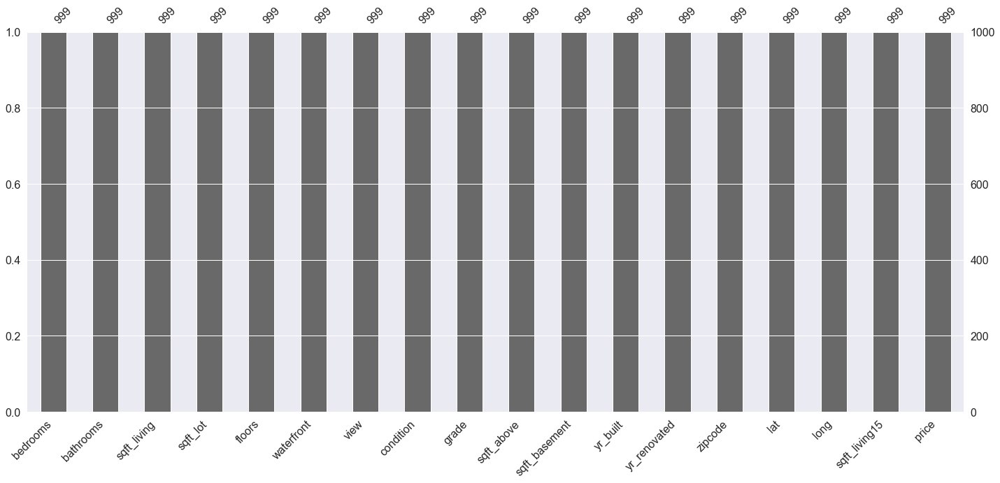

In [54]:
# Present missing_data_values_Precentage ::
df.isnull().sum()
mno.bar(df)

Text(0.5, 1, 'Confusion_Matrix of data')

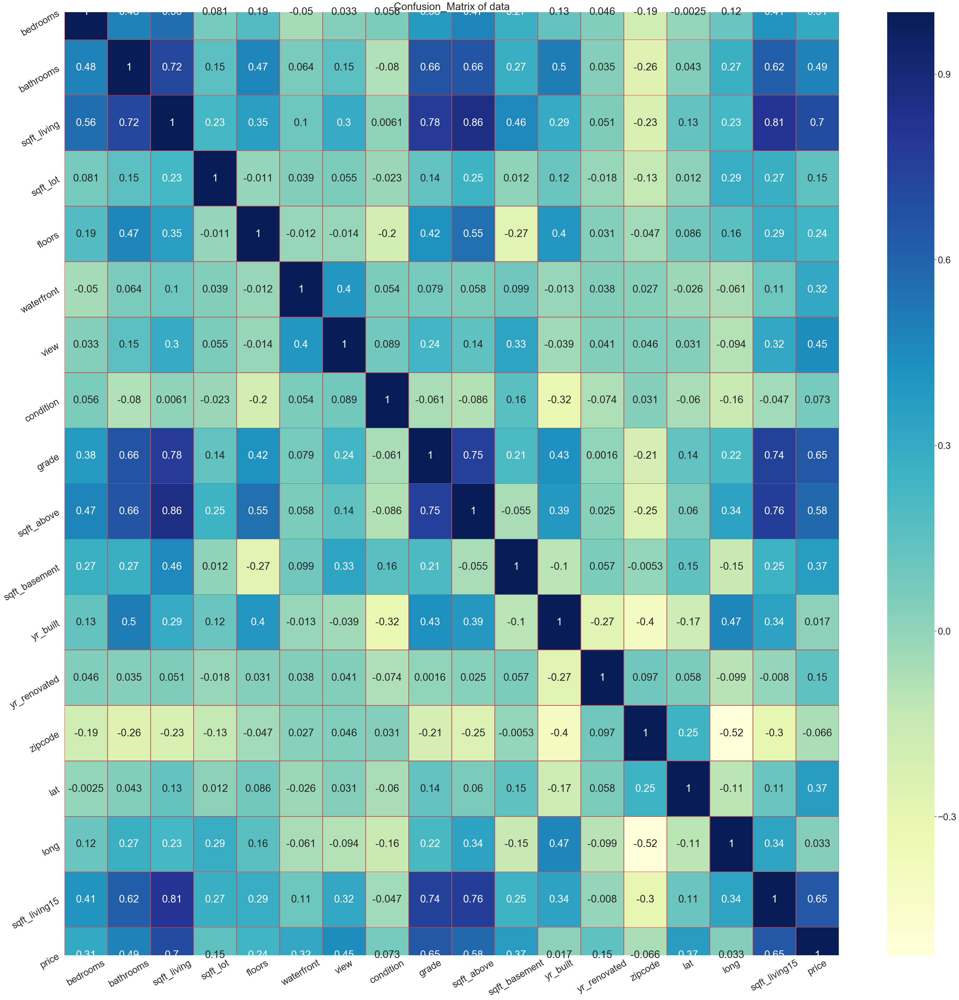

In [55]:
# Visualize The Feathure Correlations ::
sns.set( rc = {"figure.figsize" : [50 , 50]} , font_scale=2.5)
sns.heatmap(Con_Matrix , annot=True , cmap="YlGnBu" , linecolor="r" , linewidths=0.5)
plt.xticks(rotation = 30)
plt.yticks(rotation = 30)
plt.title("Confusion_Matrix of data")
# RdGy_r, RdPu, RdPu_r, RdYlBu, RdYlBu_r, RdYlGn, RdYlGn_r, Reds, Reds_r

In [56]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1000 entries, 0 to 999
Data columns (total 18 columns):
bedrooms         999 non-null float64
bathrooms        999 non-null float64
sqft_living      999 non-null float64
sqft_lot         999 non-null float64
floors           999 non-null float64
waterfront       999 non-null float64
view             999 non-null float64
condition        999 non-null float64
grade            999 non-null float64
sqft_above       999 non-null float64
sqft_basement    999 non-null float64
yr_built         999 non-null float64
yr_renovated     999 non-null float64
zipcode          999 non-null float64
lat              999 non-null float64
long             999 non-null float64
sqft_living15    999 non-null float64
price            999 non-null float64
dtypes: float64(18)
memory usage: 140.8 KB


In [57]:
# To Present bedrooms of Clients ::
bedrooms = df["bedrooms"].value_counts()
bedrooms

3.0    491
4.0    305
2.0    114
5.0     69
6.0     11
1.0      7
0.0      1
7.0      1
Name: bedrooms, dtype: int64

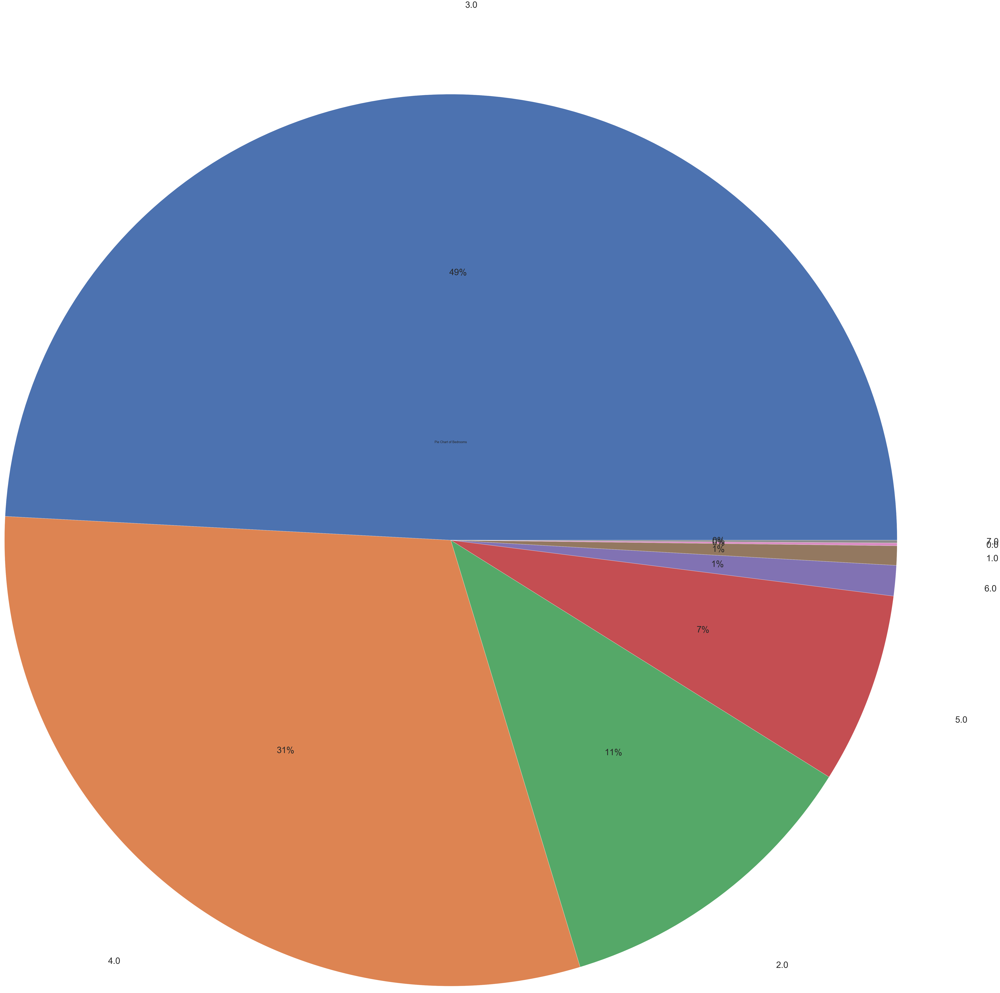

In [58]:
# Visualize Comparing aMonge Male and Female ::
sns.set( rc = {"figure.figsize" : [20 ,20]} , font_scale=1.5)
bedrooms.plot.pie(autopct = "%1.0f%%" , radius =5.8 , labeldistance = 1.2 , fontsize = 50)
plt.title("Pie Chart of Bedrooms")
plt.show()

In [59]:
# To Present bedrooms of Clients ::
bathrooms = df["bathrooms"].value_counts()
bathrooms

2.50    238
1.00    187
1.75    159
2.25    104
2.00     98
1.50     61
2.75     51
3.00     33
3.50     28
3.25     18
0.75      6
4.00      4
4.25      4
4.50      2
5.00      2
0.00      1
4.75      1
3.75      1
1.25      1
Name: bathrooms, dtype: int64

In [60]:
# Visualize Comparing aMonge Male and Female ::
sns.set( rc = {"figure.figsize" : [20 ,40]} , font_scale=1.5)
bathrooms.plot.pie(autopct = "%1.0f%%" , radius = 7.5 , labeldistance = 1.2 , fontsize = 70 , explode = [0,0,0,0,0,0,0,0,0,0,0,0,0.9,0.7,0.5,0.3,0.1,0.8,0.6])
plt.title("Pie Chart of Bedrooms")
plt.show()

In [61]:
# To Present bedrooms of Clients ::
floors = df["floors"].value_counts()
floors

1.0    528
2.0    354
1.5     93
3.0     18
2.5      5
3.5      1
Name: floors, dtype: int64

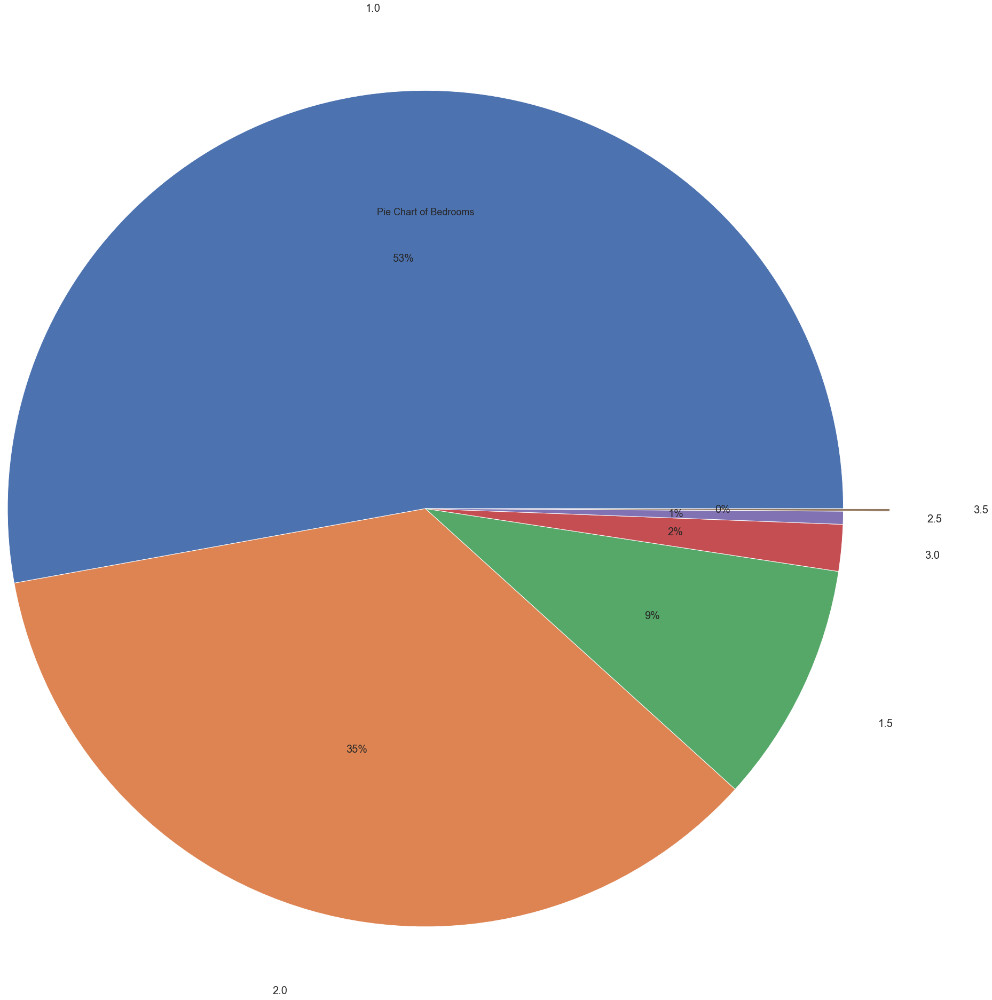

In [62]:
# Visualize Comparing aMonge Male and Female ::
sns.set( rc = {"figure.figsize" : [20 ,20]} , font_scale=1.5)
floors.plot.pie(autopct = "%1.0f%%" , radius = 1.8 , labeldistance = 1.2 , fontsize = 20 , explode = [0,0,0,0,0,0.2])
plt.title("Pie Chart of Bedrooms")
plt.show()

In [63]:
# To Present bedrooms of Clients ::
waterfronts = df["waterfront"].value_counts()
waterfronts

0.0    991
1.0      8
Name: waterfront, dtype: int64

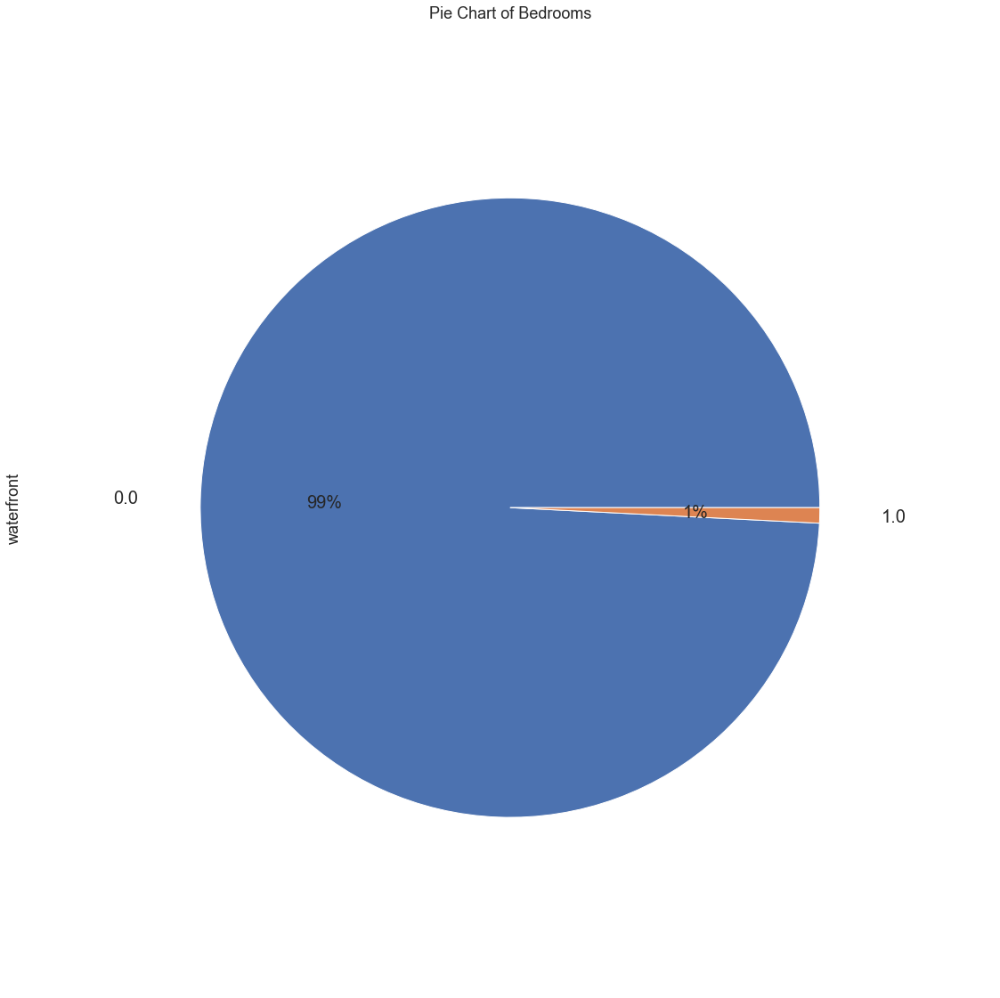

In [64]:
# Visualize Comparing aMonge Male and Female ::
sns.set( rc = {"figure.figsize" : [20 ,20]} , font_scale=1.5)
waterfronts.plot.pie(autopct = "%1.0f%%" , radius = 0.8 , labeldistance = 1.2 , fontsize = 20)
plt.title("Pie Chart of Bedrooms")
plt.show()

In [65]:
# To Present bedrooms of Clients ::
views = df["view"].value_counts()
views

0.0    899
2.0     46
3.0     26
1.0     15
4.0     13
Name: view, dtype: int64

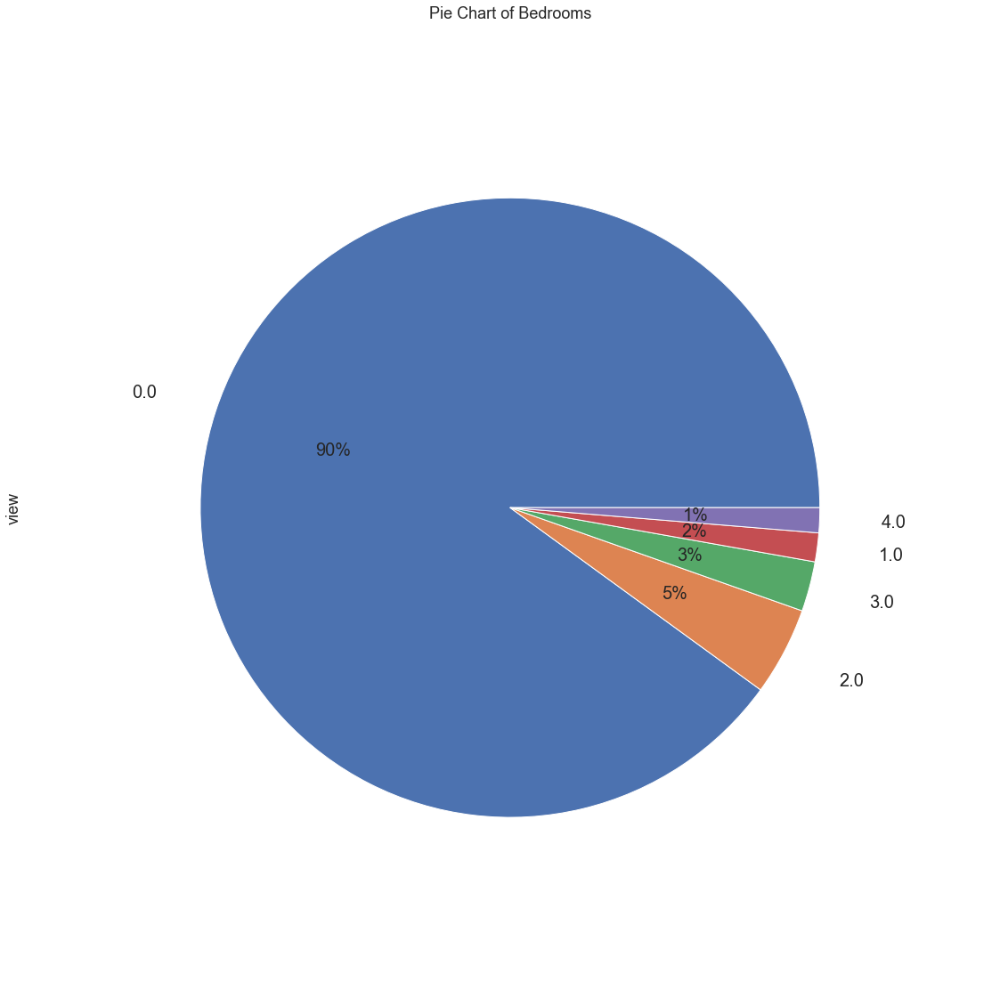

In [66]:
# Visualize Comparing aMonge Male and Female ::
sns.set( rc = {"figure.figsize" : [20 ,20]} , font_scale=1.5)
views.plot.pie(autopct = "%1.0f%%" , radius = 0.8 , labeldistance = 1.2 , fontsize = 20)
plt.title("Pie Chart of Bedrooms")
plt.show()

In [67]:
# To Present bedrooms of Clients ::
grades = df["grade"].value_counts()
grades

7.0     445
8.0     266
9.0     112
6.0      91
10.0     47
11.0     18
5.0      13
12.0      5
4.0       2
Name: grade, dtype: int64

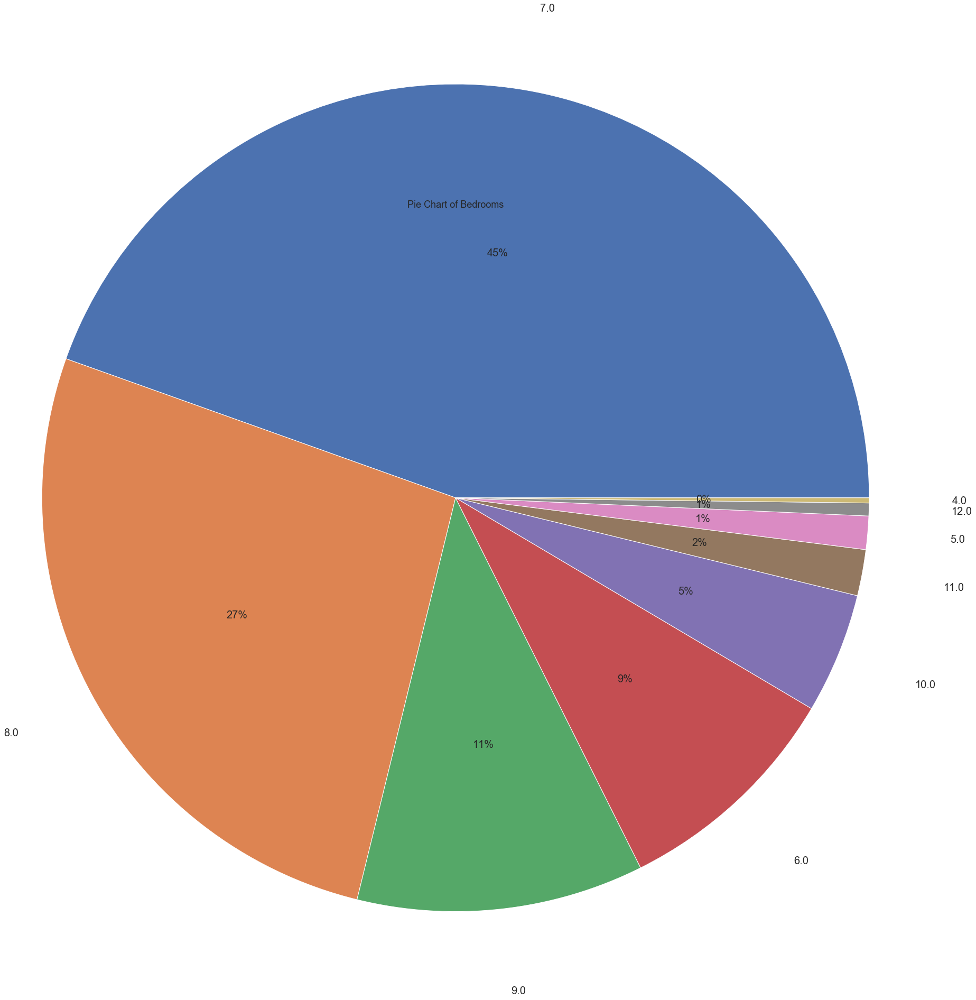

In [68]:
# Visualize Comparing aMonge Male and Female ::
sns.set( rc = {"figure.figsize" : [20 ,20]} , font_scale=1.5)
grades.plot.pie(autopct = "%1.0f%%" , radius = 1.8 , labeldistance = 1.2 , fontsize = 20)
plt.title("Pie Chart of Bedrooms")
plt.show()

In [69]:
# To Present bedrooms of Clients ::
yr_builts = df["yr_built"].value_counts()
yr_builts

2005.0    25
1954.0    25
1979.0    20
1977.0    20
1968.0    19
          ..
1902.0     1
1945.0     1
2015.0     1
1934.0     1
1903.0     1
Name: yr_built, Length: 114, dtype: int64

In [70]:
# Visualize Comparing aMonge Male and Female ::
sns.set( rc = {"figure.figsize" : [20 ,20]} , font_scale=1.5)
yr_builts.plot.pie(autopct = "%1.0f%%" , radius = 10 , labeldistance = 1.2 , fontsize = 80)
plt.title("Pie Chart of Bedrooms")
plt.show()

In [71]:
# To Present bedrooms of Clients ::
yr_renovateds = df["yr_renovated"].value_counts()
yr_renovateds

0.0       958
2002.0      3
2013.0      3
2014.0      3
2005.0      3
2003.0      3
1991.0      3
1978.0      2
1999.0      2
1994.0      2
1990.0      2
1984.0      2
1988.0      1
2008.0      1
1957.0      1
2011.0      1
1945.0      1
1981.0      1
1974.0      1
1983.0      1
1992.0      1
2010.0      1
1977.0      1
1995.0      1
1954.0      1
Name: yr_renovated, dtype: int64

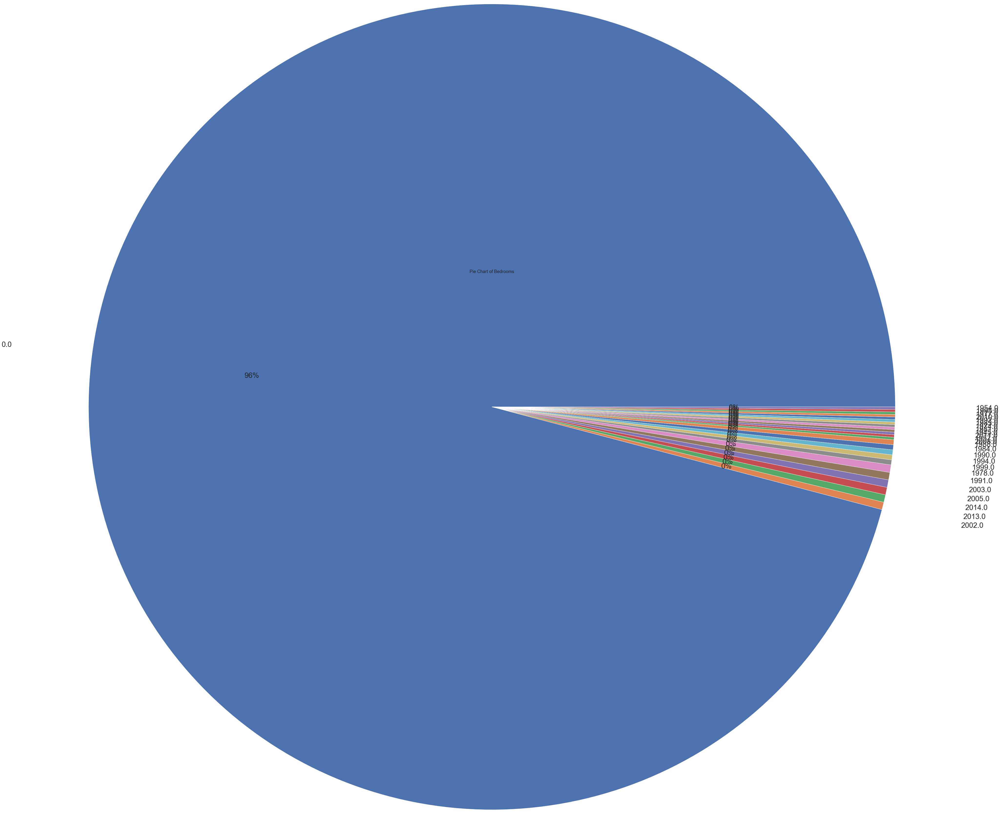

In [72]:
# Visualize Comparing aMonge Male and Female ::
sns.set( rc = {"figure.figsize" : [20 ,20]} , font_scale=1.5)
yr_renovateds.plot.pie(autopct = "%1.0f%%" , radius = 3.8 , labeldistance = 1.2 , fontsize = 30)
plt.title("Pie Chart of Bedrooms")
plt.show()

In [73]:
# To Present bedrooms of Clients ::
zipcodes = df["zipcode"].value_counts()
zipcodes

98038.0    38
98006.0    32
98023.0    30
98052.0    29
98058.0    27
           ..
98070.0     5
98014.0     4
98007.0     4
98109.0     2
98148.0     2
Name: zipcode, Length: 69, dtype: int64

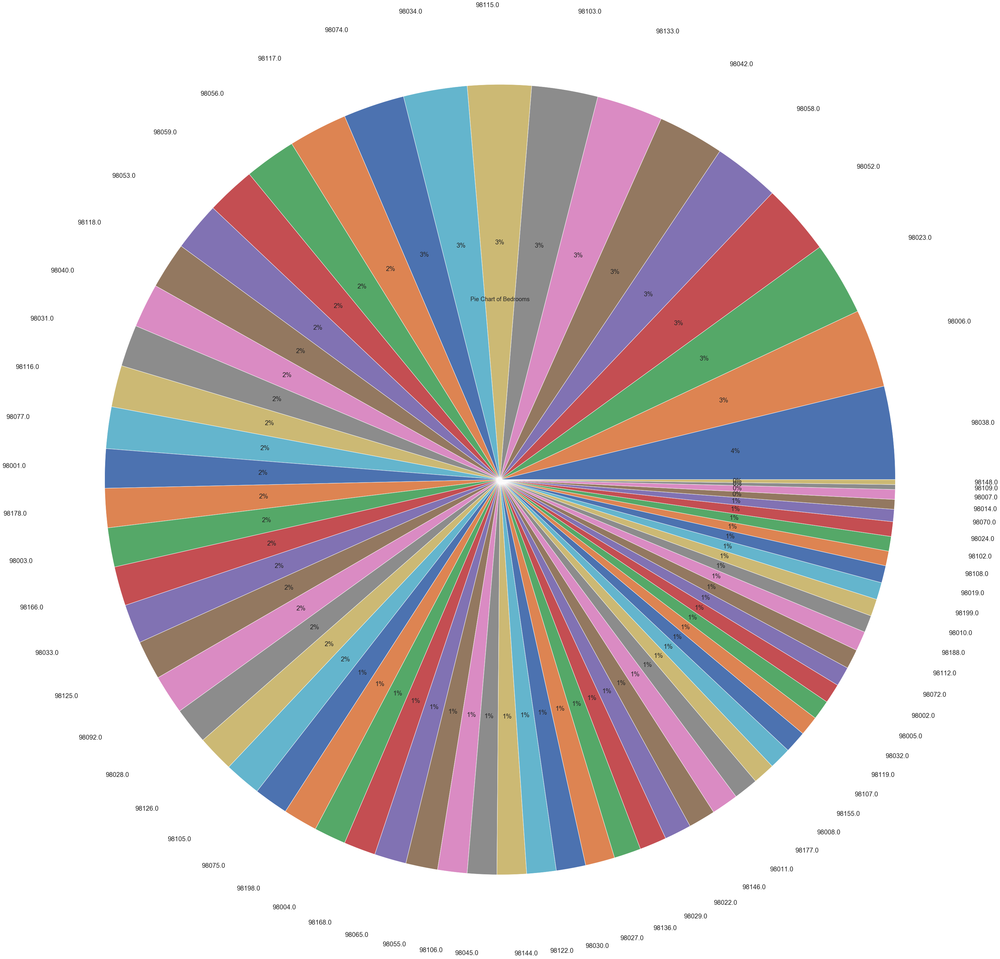

In [74]:
# Visualize Comparing aMonge Male and Female ::
sns.set( rc = {"figure.figsize" : [20 ,20]} , font_scale=1.5)
zipcodes.plot.pie(autopct = "%1.0f%%" , radius = 2.8 , labeldistance = 1.2 , fontsize = 20)
plt.title("Pie Chart of Bedrooms")
plt.show()

Text(0.5, 1.0, 'Kde Plot of sqft_living')

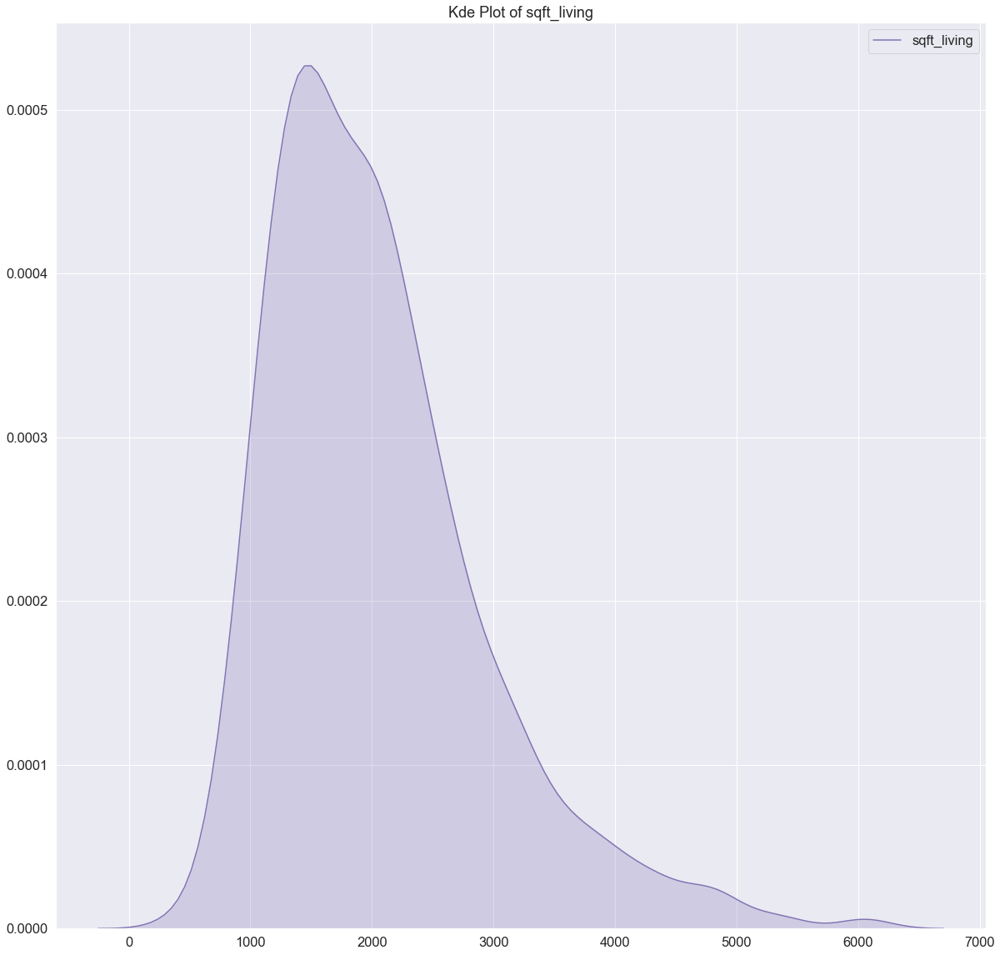

In [75]:
sns.kdeplot(df["sqft_living"] , shade=True , color="m")
plt.title("Kde Plot of sqft_living")

Text(0.5, 1.0, 'Kde Plot of sqft_lot')

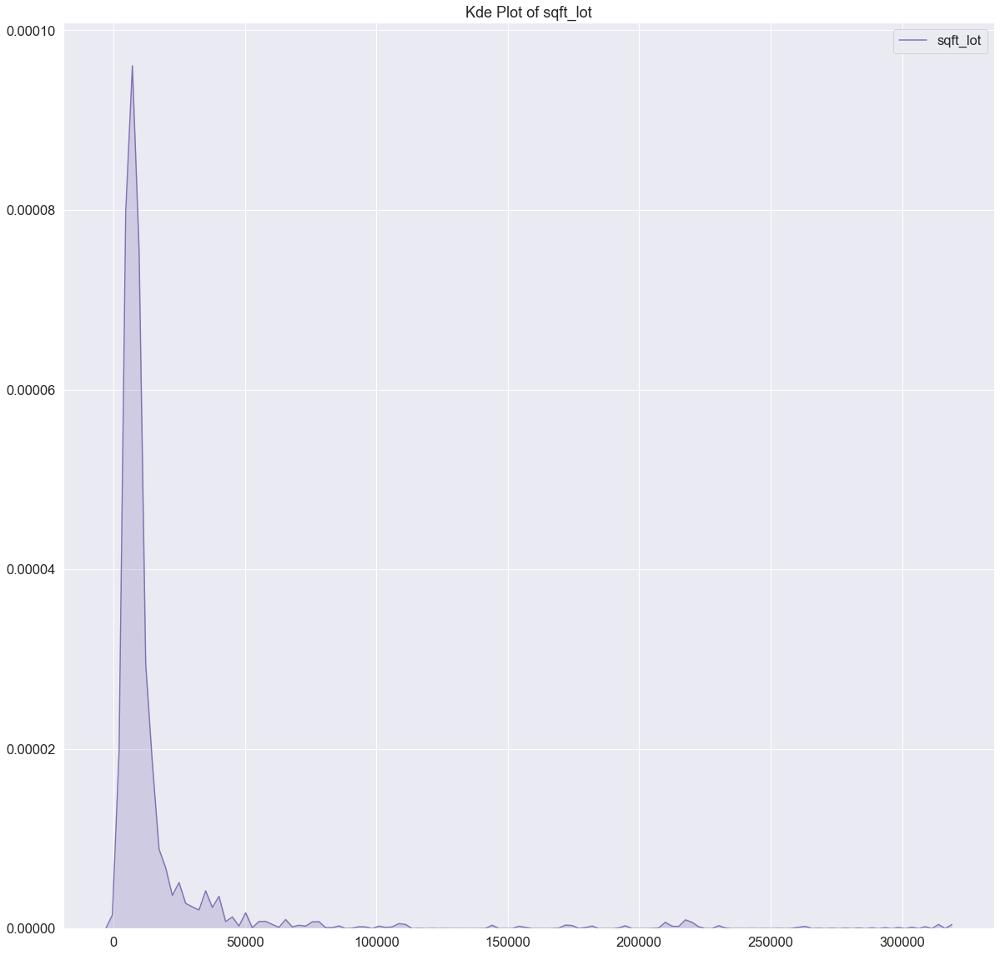

In [76]:
sns.kdeplot(df["sqft_lot"] , shade=True , color="m")
plt.title("Kde Plot of sqft_lot")

Text(0.5, 1.0, 'Kde Plot of price')

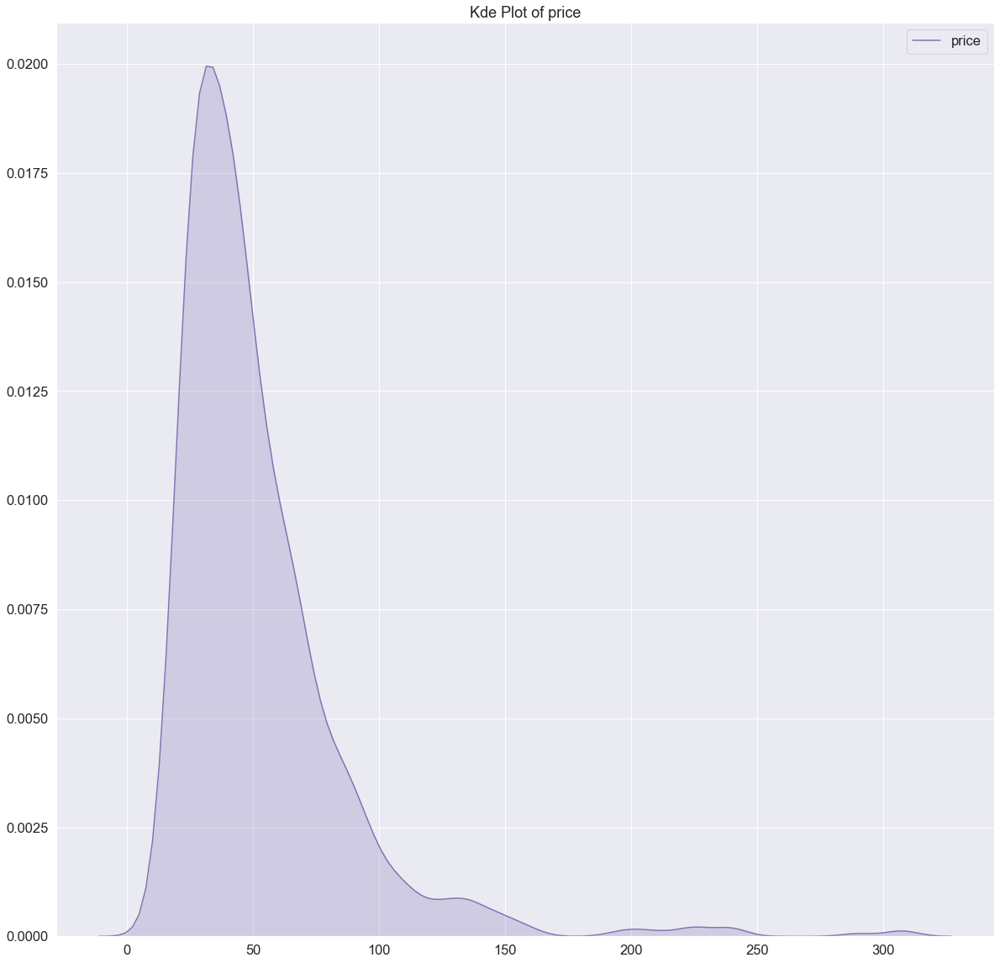

In [77]:
sns.kdeplot(df["price"] , shade=True , color="m")
plt.title("Kde Plot of price")

Text(0.5, 1, 'Regular Plot of TotalCharges and tenure')

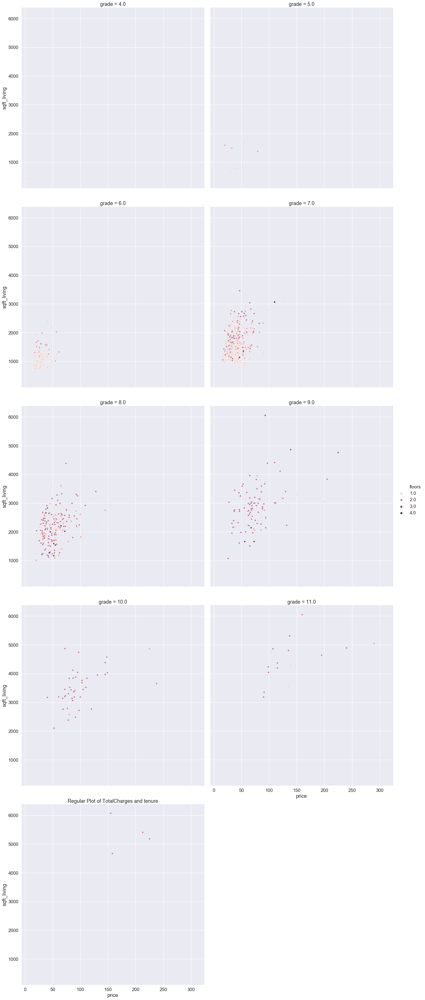

In [78]:
sns.set( rc = {"figure.figsize" : [50 , 35]} , font_scale=1.5)

sns.relplot( x = "price"  , y = "sqft_living" ,data=df , hue="floors" ,height=10 , col = "grade" , col_wrap=2)
plt.title("Regular Plot of TotalCharges and tenure")

Text(0.5, 1, 'Regular Plot of TotalCharges and tenure')

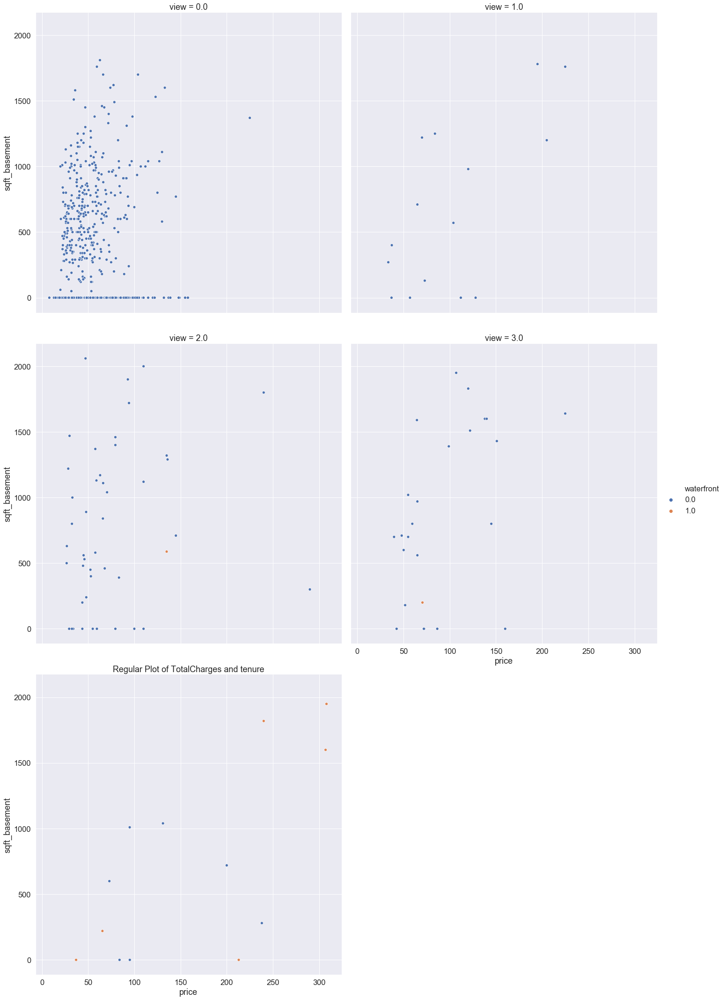

In [79]:
sns.set( rc = {"figure.figsize" : [50 , 35]} , font_scale=1.5)

sns.relplot( x = "price"  , y = "sqft_basement" ,data=df , hue="waterfront" ,height=10 , col = "view" , col_wrap=2)
plt.title("Regular Plot of TotalCharges and tenure")

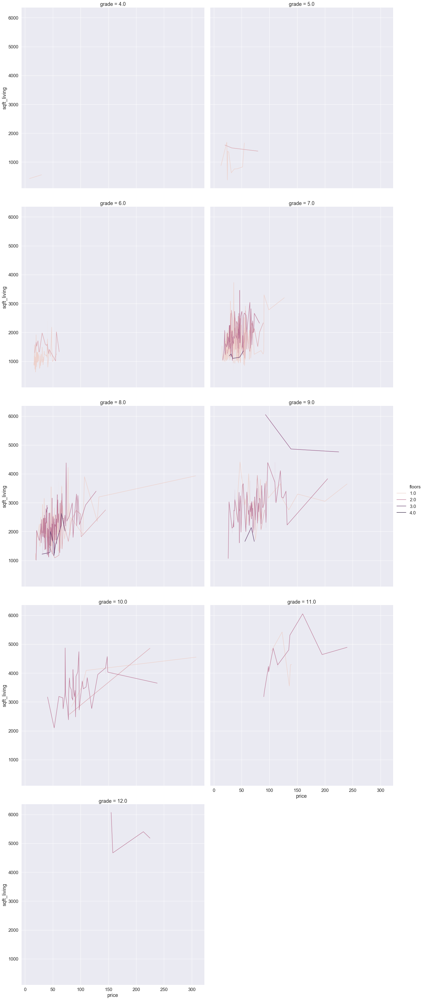

In [80]:
sns.relplot( x = "price"  , y = "sqft_living" ,data=df , hue="floors" ,height=10 , col = "grade" , col_wrap=2 ,kind="line")

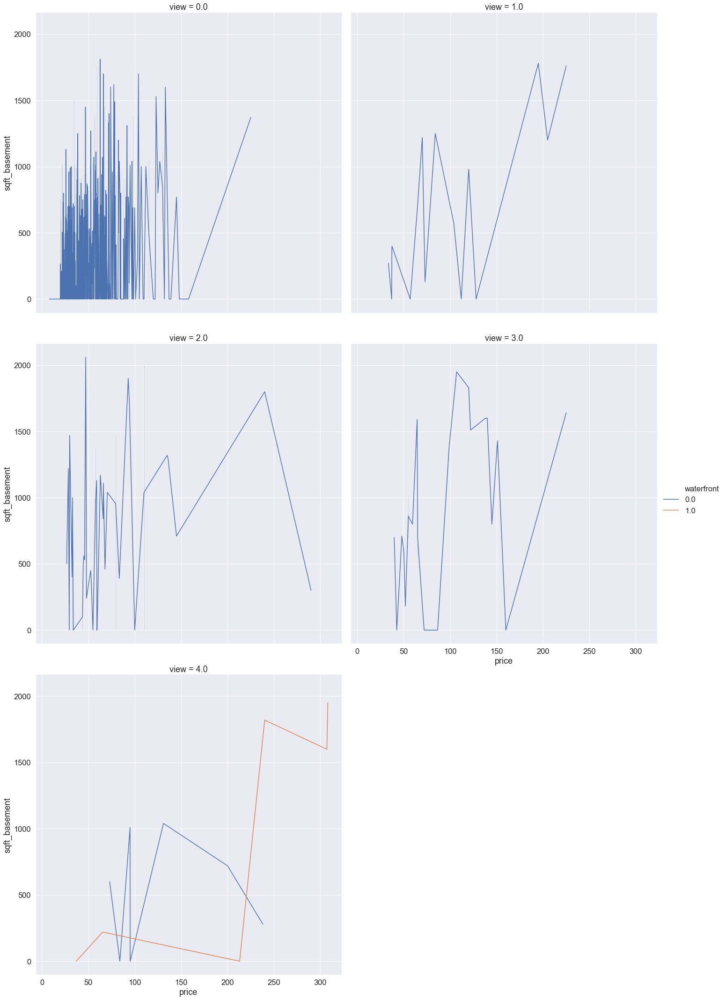

In [81]:
sns.relplot( x = "price"  , y = "sqft_basement" ,data=df , hue="waterfront" ,height=10 , col = "view" , col_wrap=2 ,kind="line")

Text(0.5, 1, 'Joint Plot of  price and sqft_living')

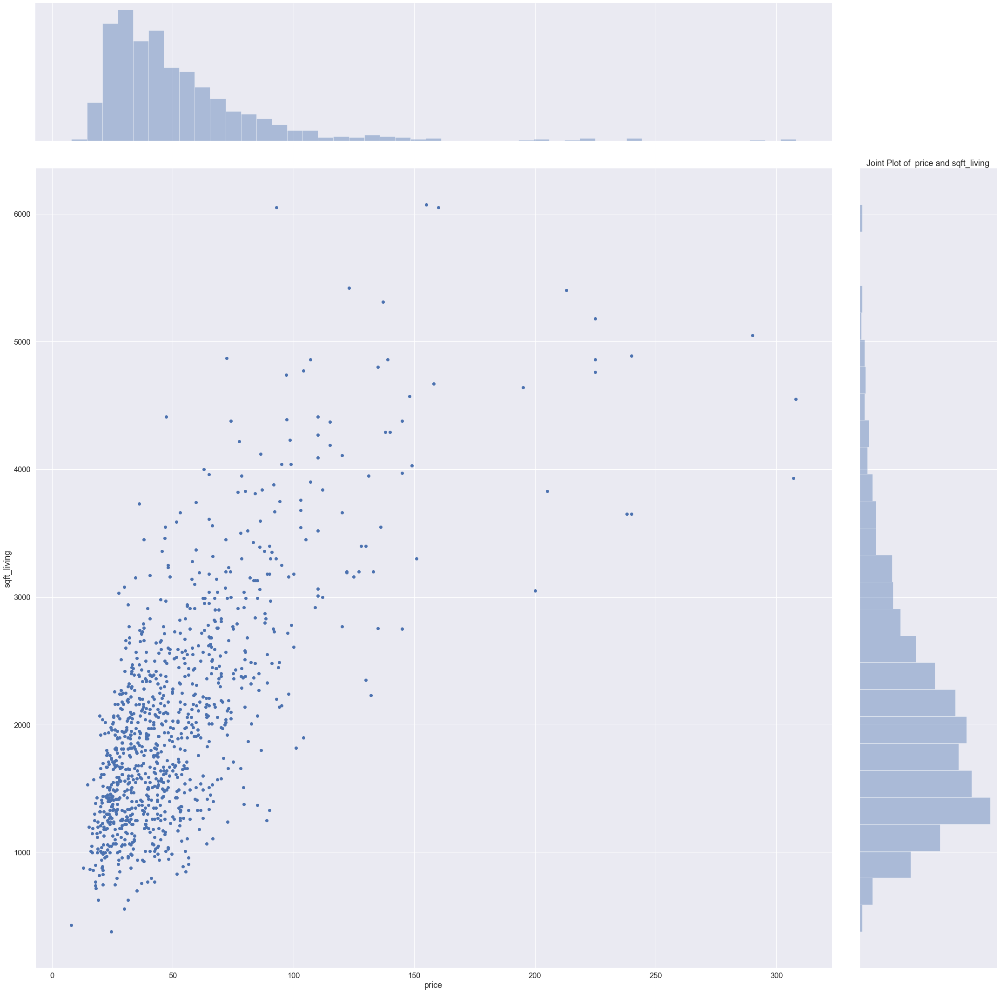

In [82]:
sns.set(rc ={"figure.figsize" : [20,20]} , font_scale=1.5)
sns.jointplot( x = "price" , y = "sqft_living" , data = df , kind = "scatter" , height=30  )
plt.title("Joint Plot of  price and sqft_living")

Text(0.5, 1, 'Joint Plot of  price and sqft_living')

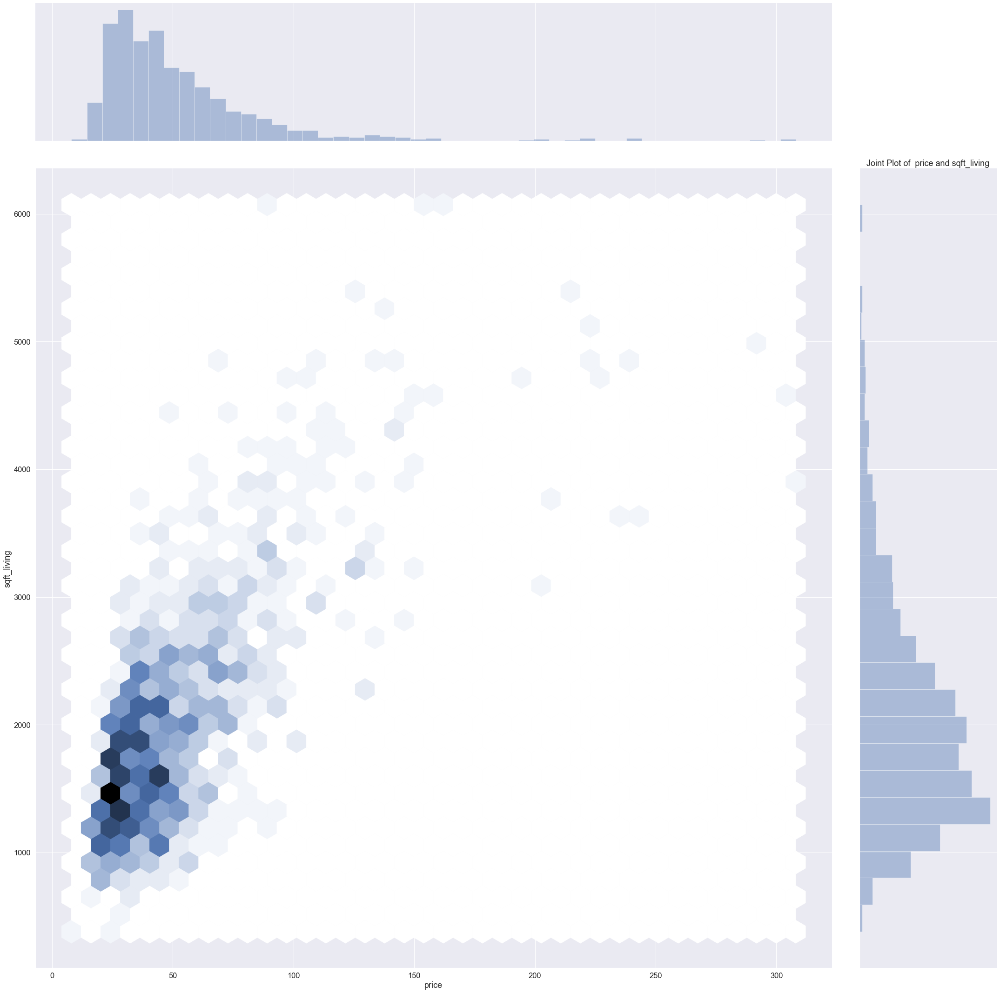

In [83]:
sns.set(rc ={"figure.figsize" : [20,20]} , font_scale=1.5)
sns.jointplot( x = "price" , y = "sqft_living" , data = df , kind = "hex" , height=30  )
plt.title("Joint Plot of  price and sqft_living")

Text(0.5, 1, 'Joint Plot of  price and sqft_living')

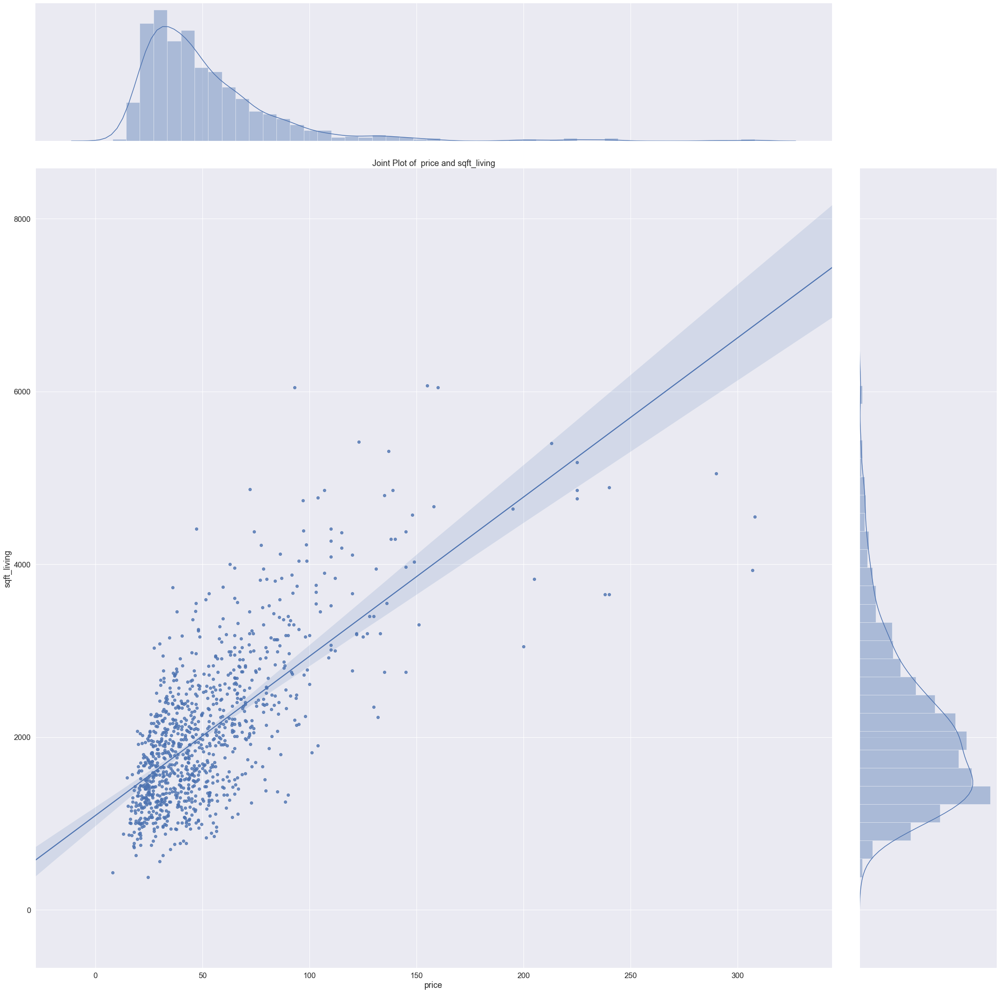

In [84]:
sns.set(rc ={"figure.figsize" : [20,20]} , font_scale=1.5)
sns.jointplot( x = "price" , y = "sqft_living" , data = df , kind = "reg" , height=30  )
plt.title("Joint Plot of  price and sqft_living")

Text(0.5, 1, 'Joint Plot of  price and sqft_basement')

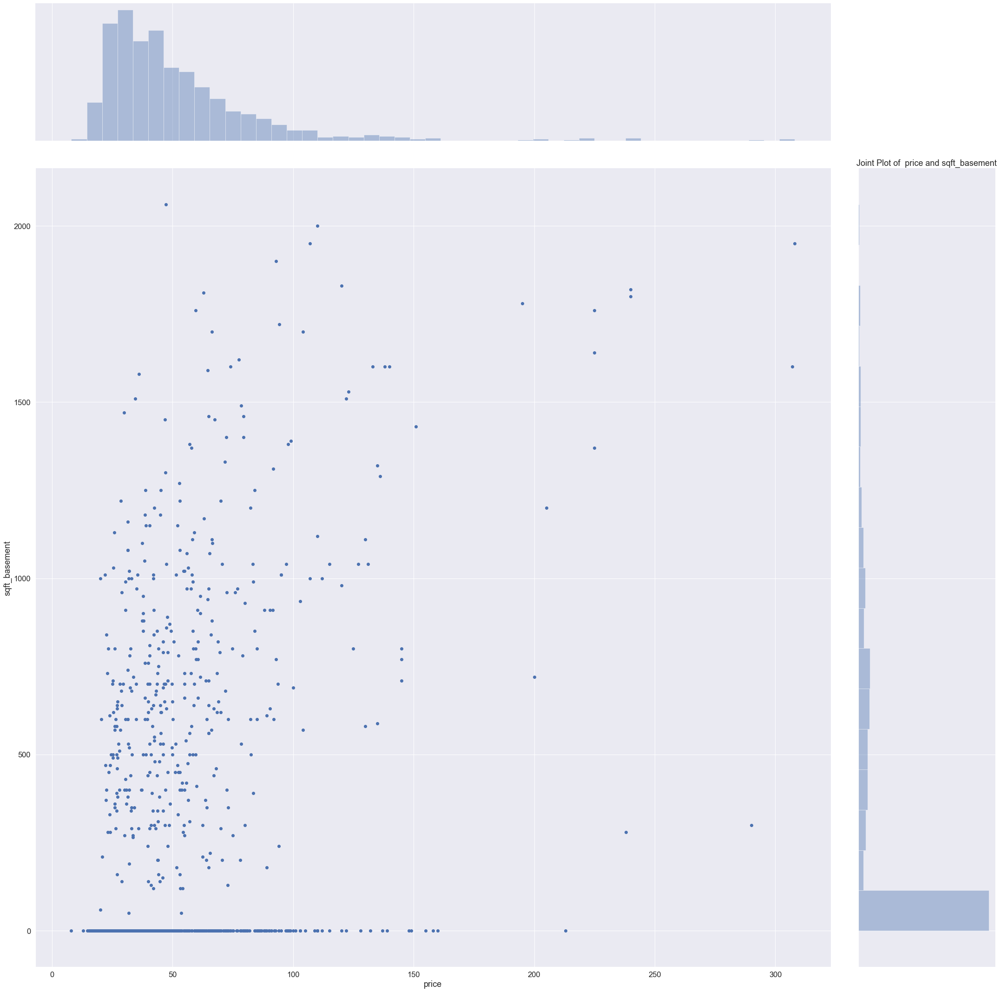

In [85]:
sns.jointplot( x = "price" , y = "sqft_basement" , data = df , kind = "scatter" , height=30 )
plt.title("Joint Plot of  price and sqft_basement")

Text(0.5, 1, 'Joint Plot of  price and sqft_basement')

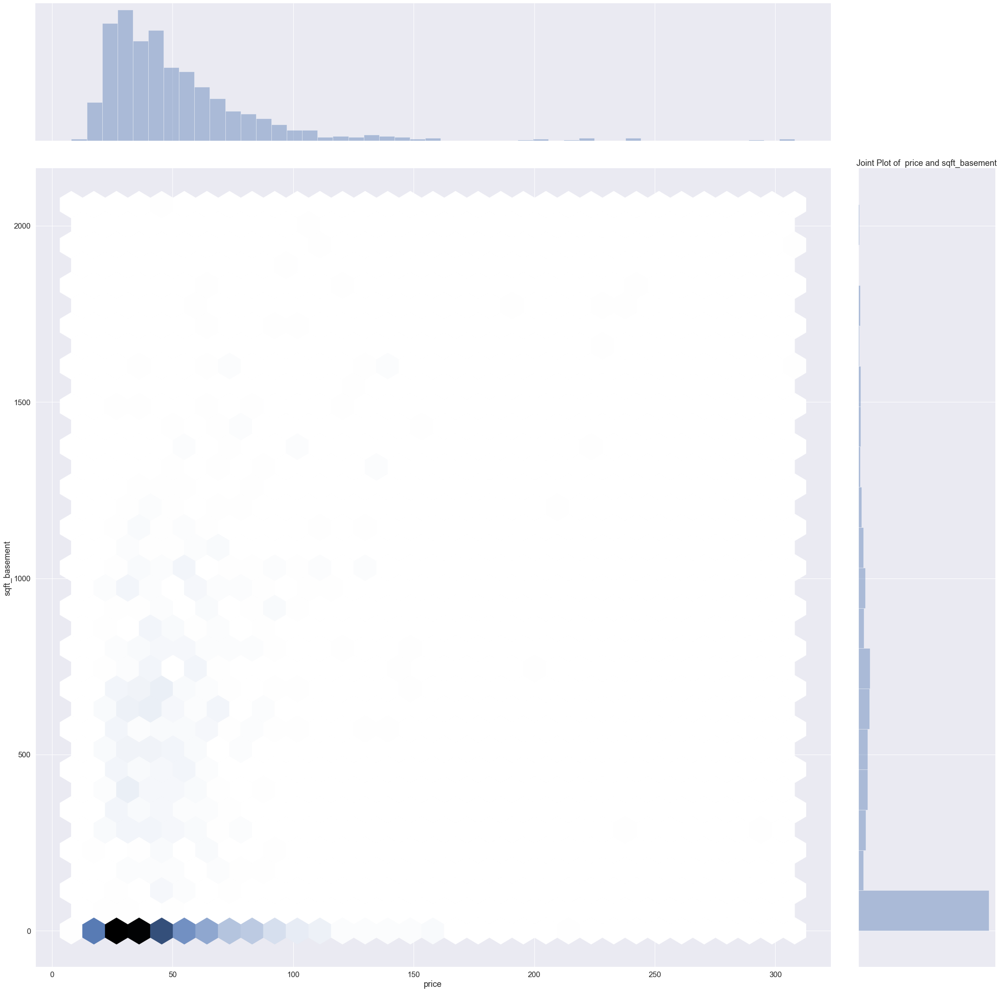

In [86]:
sns.jointplot( x = "price" , y = "sqft_basement" , data = df , kind = "hex" , height=30 )
plt.title("Joint Plot of  price and sqft_basement")

Text(0.5, 1, 'Joint Plot of  price and sqft_basement')

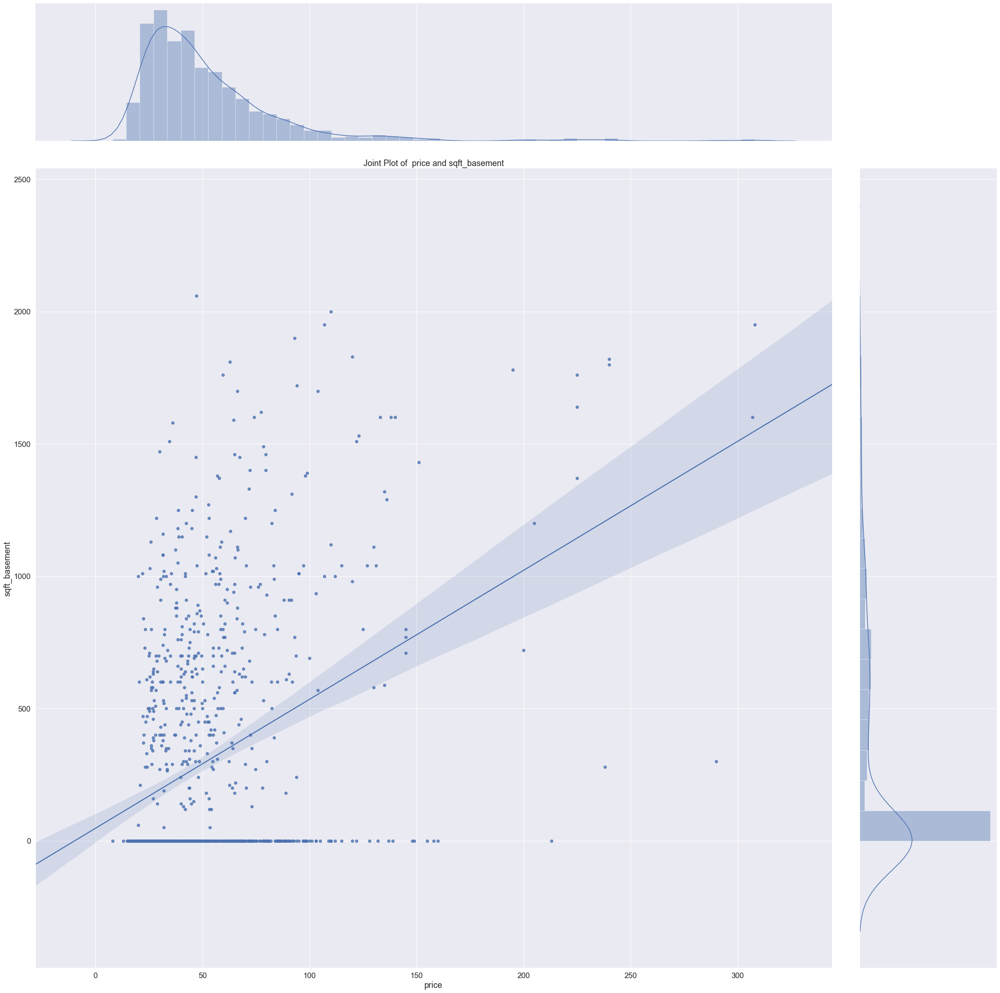

In [87]:
sns.jointplot( x = "price" , y = "sqft_basement" , data = df , kind = "reg" , height=30 )
plt.title("Joint Plot of  price and sqft_basement")

Text(0.5, 1, 'Pair Plot of df')

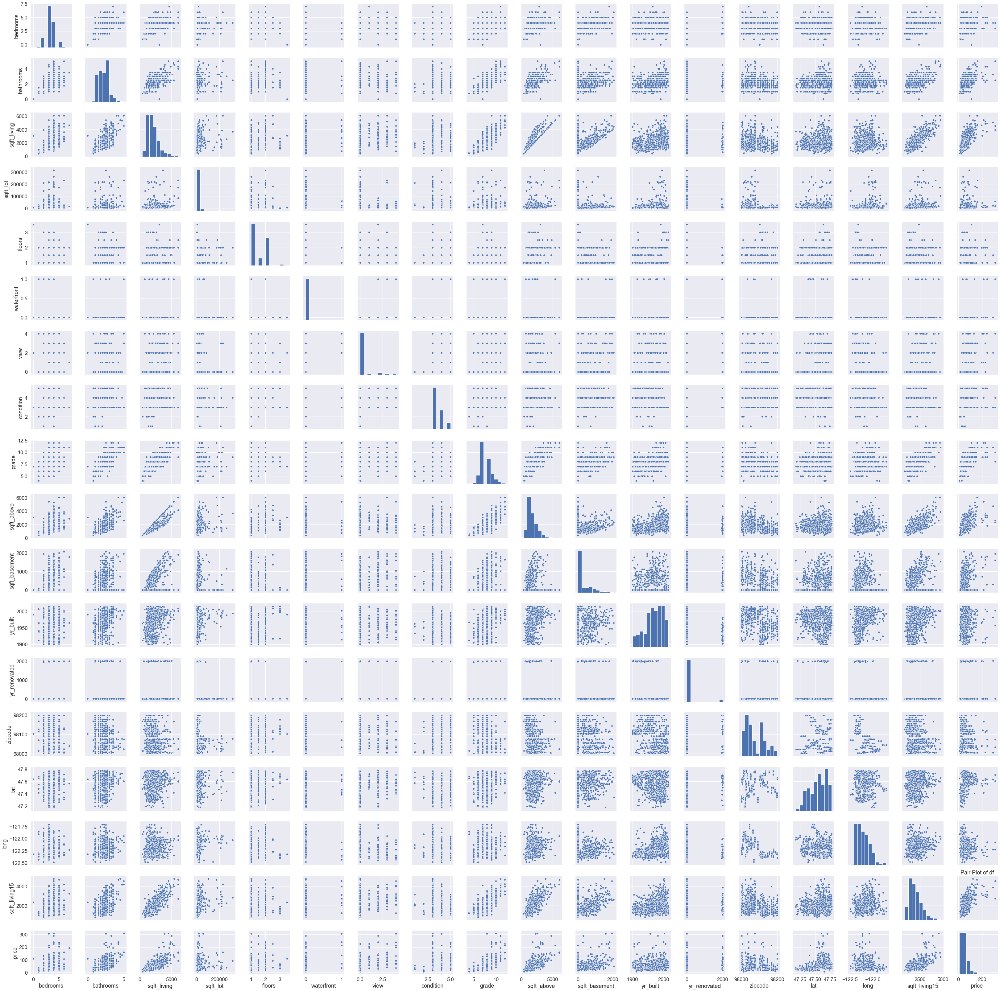

In [88]:
sns.pairplot(df)
plt.title("Pair Plot of df")

Text(0.5, 1.0, 'Strip Plot of floors and price')

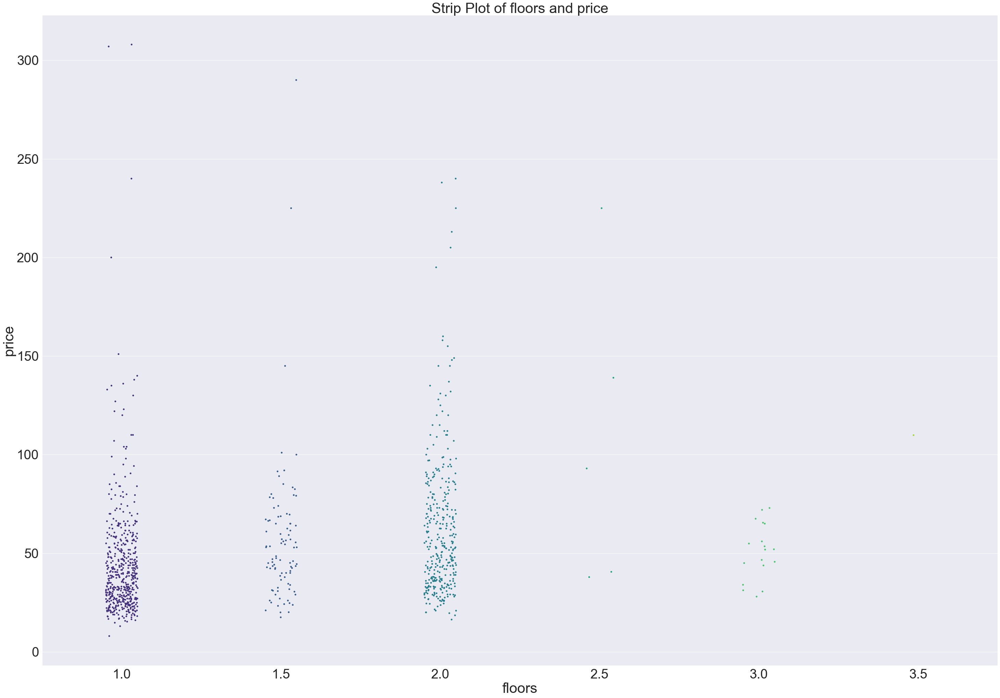

In [89]:
sns.set( rc = {"figure.figsize" : [50 , 35]} , font_scale=3.5)

sns.stripplot( x = "floors" , y = "price" , data = df , palette="viridis")
plt.title("Strip Plot of floors and price")

Text(0.5, 1.0, 'Strip Plot of waterfront and price')

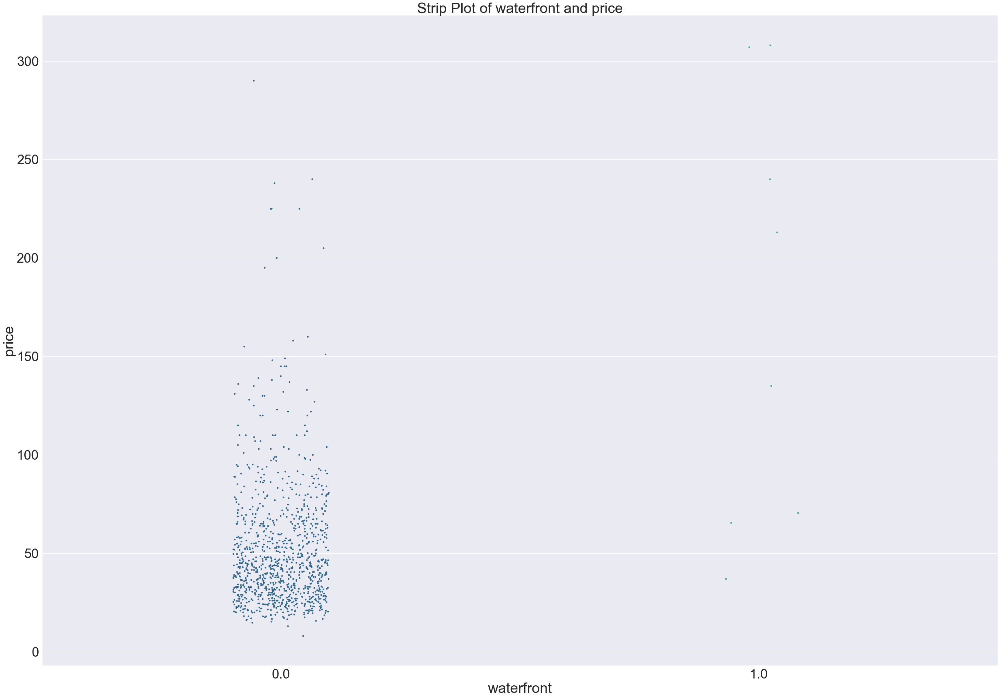

In [90]:
sns.set( rc = {"figure.figsize" : [50 , 35]} , font_scale=3.5)

sns.stripplot( x = "waterfront" , y = "price" , data = df , palette="viridis")
plt.title("Strip Plot of waterfront and price")

Text(0.5, 1.0, 'Strip Plot of view and price')

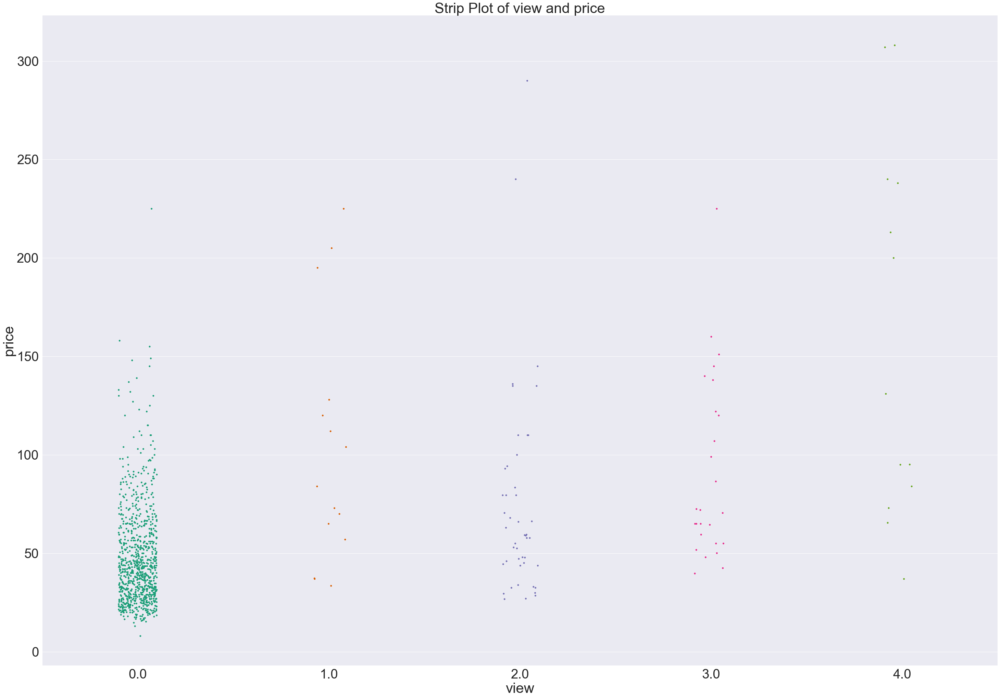

In [91]:
sns.set( rc = {"figure.figsize" : [50 , 35]} , font_scale=3.5)

sns.stripplot( x = "view" , y = "price" , data = df , palette="Dark2")
plt.title("Strip Plot of view and price")

Text(0.5, 1.0, 'Strip Plot of grade and price')

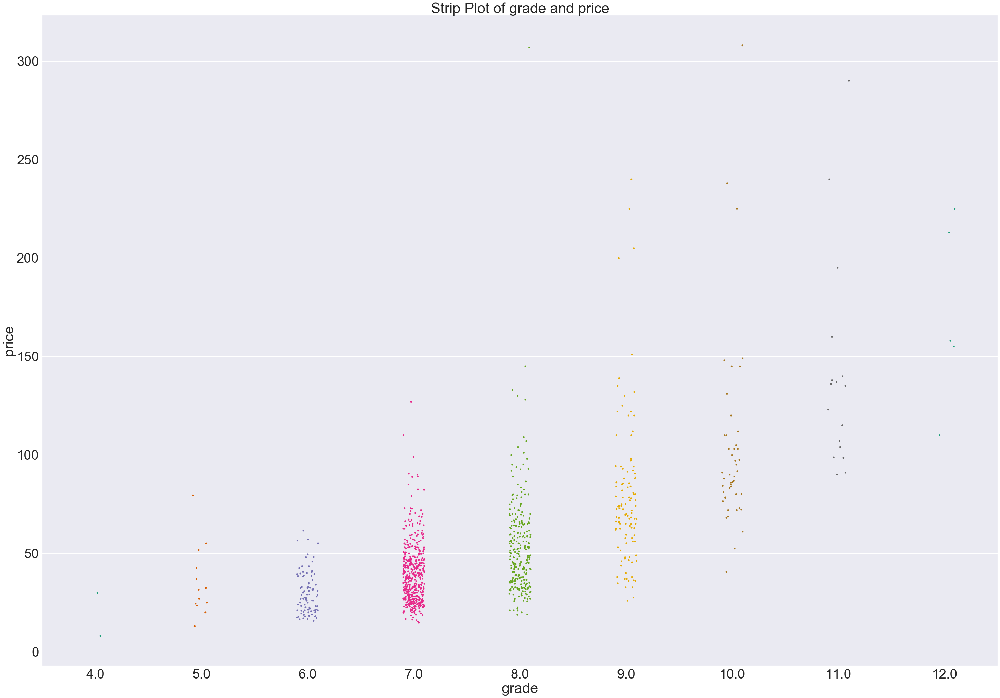

In [92]:
sns.set( rc = {"figure.figsize" : [50 , 35]} , font_scale=3.5)

sns.stripplot( x = "grade" , y = "price" , data = df , palette="Dark2")
plt.title("Strip Plot of grade and price")

(array([  0,   1,   2,   3,   4,   5,   6,   7,   8,   9,  10,  11,  12,
         13,  14,  15,  16,  17,  18,  19,  20,  21,  22,  23,  24,  25,
         26,  27,  28,  29,  30,  31,  32,  33,  34,  35,  36,  37,  38,
         39,  40,  41,  42,  43,  44,  45,  46,  47,  48,  49,  50,  51,
         52,  53,  54,  55,  56,  57,  58,  59,  60,  61,  62,  63,  64,
         65,  66,  67,  68,  69,  70,  71,  72,  73,  74,  75,  76,  77,
         78,  79,  80,  81,  82,  83,  84,  85,  86,  87,  88,  89,  90,
         91,  92,  93,  94,  95,  96,  97,  98,  99, 100, 101, 102, 103,
        104, 105, 106, 107, 108, 109, 110, 111, 112, 113]),
 <a list of 114 Text xticklabel objects>)

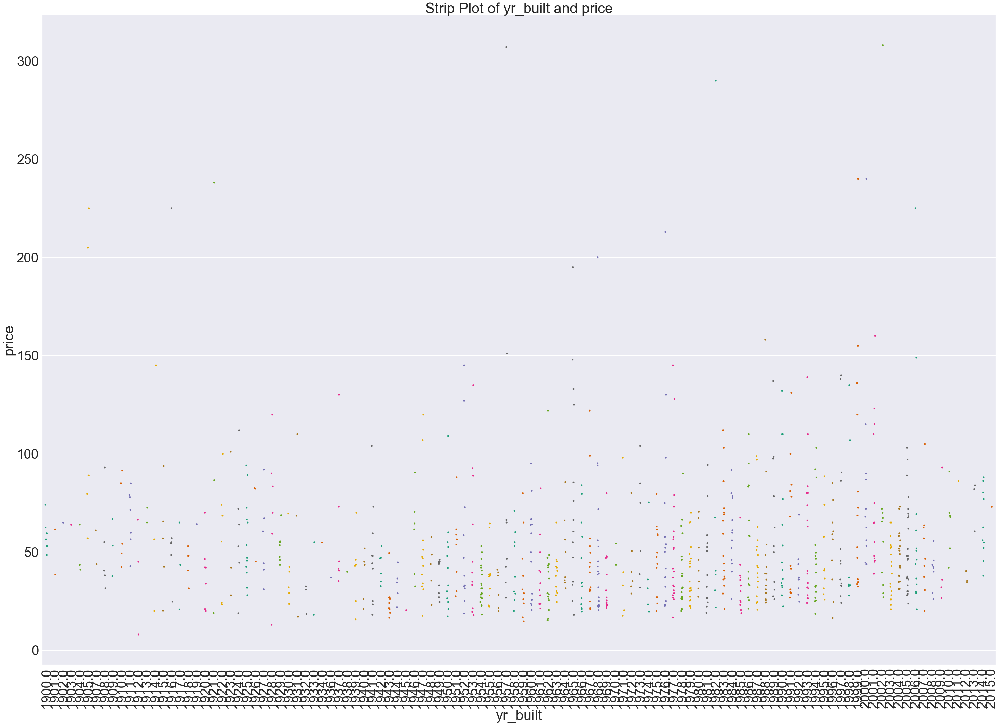

In [93]:
sns.set( rc = {"figure.figsize" : [50 , 35]} , font_scale=3.5)

sns.stripplot( x = "yr_built" , y = "price" , data = df , palette="Dark2")
plt.title("Strip Plot of yr_built and price")
plt.xticks(rotation = 90)

(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
        17, 18, 19, 20, 21, 22, 23, 24]),
 <a list of 25 Text xticklabel objects>)

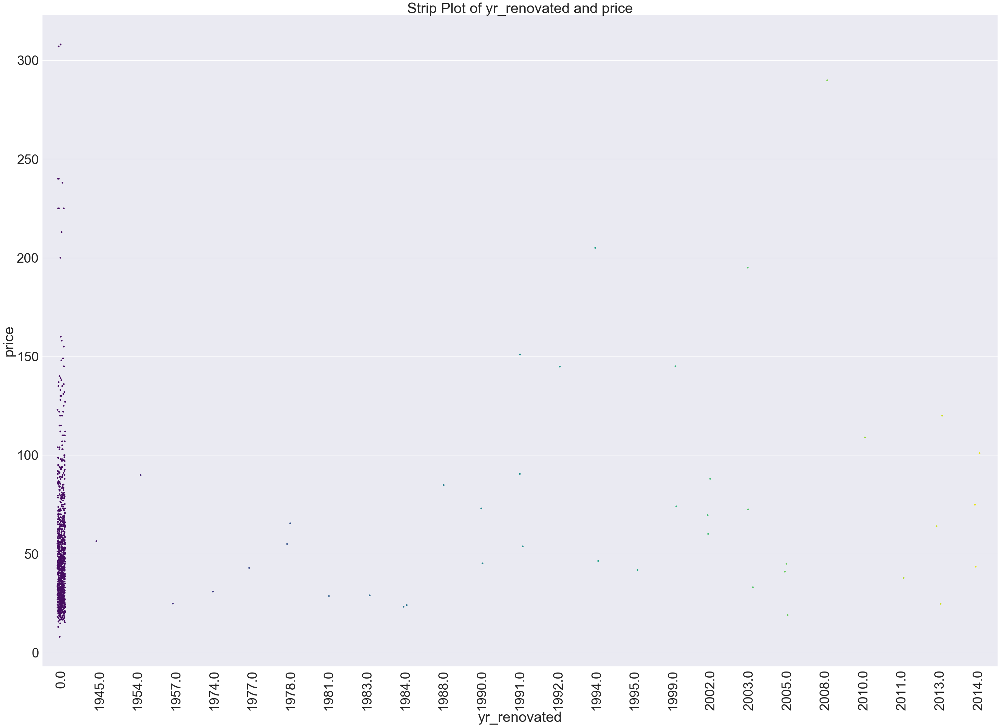

In [94]:
sns.set( rc = {"figure.figsize" : [50 , 35]} , font_scale=3.5)

sns.stripplot( x = "yr_renovated" , y = "price" , data = df , palette="viridis")
plt.title("Strip Plot of yr_renovated and price")
plt.xticks(rotation = 90)

Text(0.5, 1.0, 'Swarm Plot of bedrooms and price')

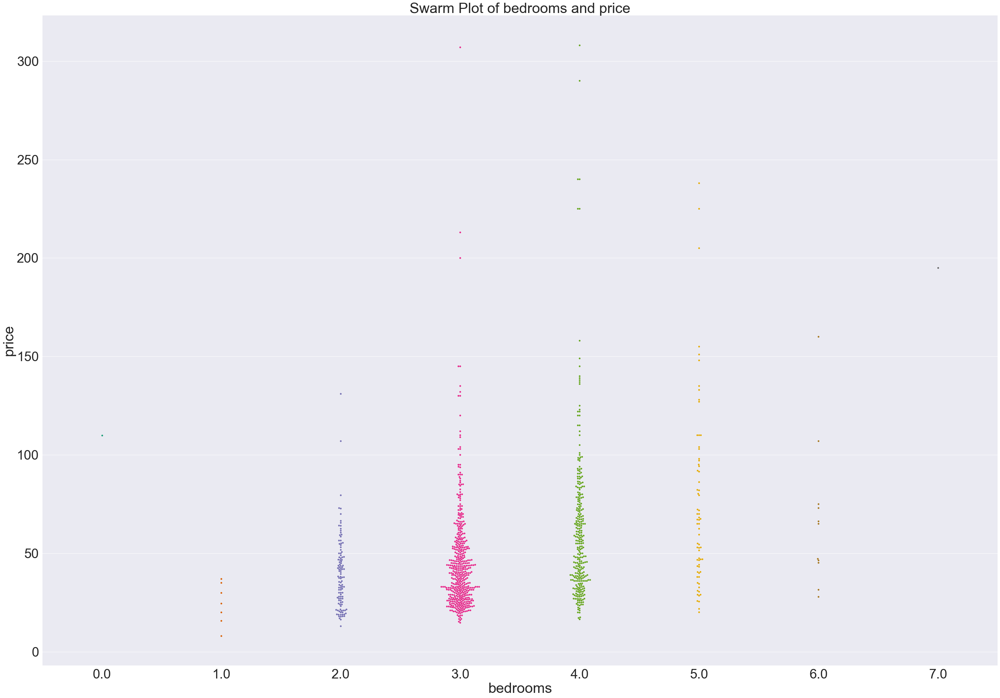

In [95]:
sns.swarmplot( x = "bedrooms" , y = "price" , data = df , palette="Dark2")
plt.title("Swarm Plot of bedrooms and price")

Text(0.5, 1.0, 'Swarm Plot of bathrooms and price')

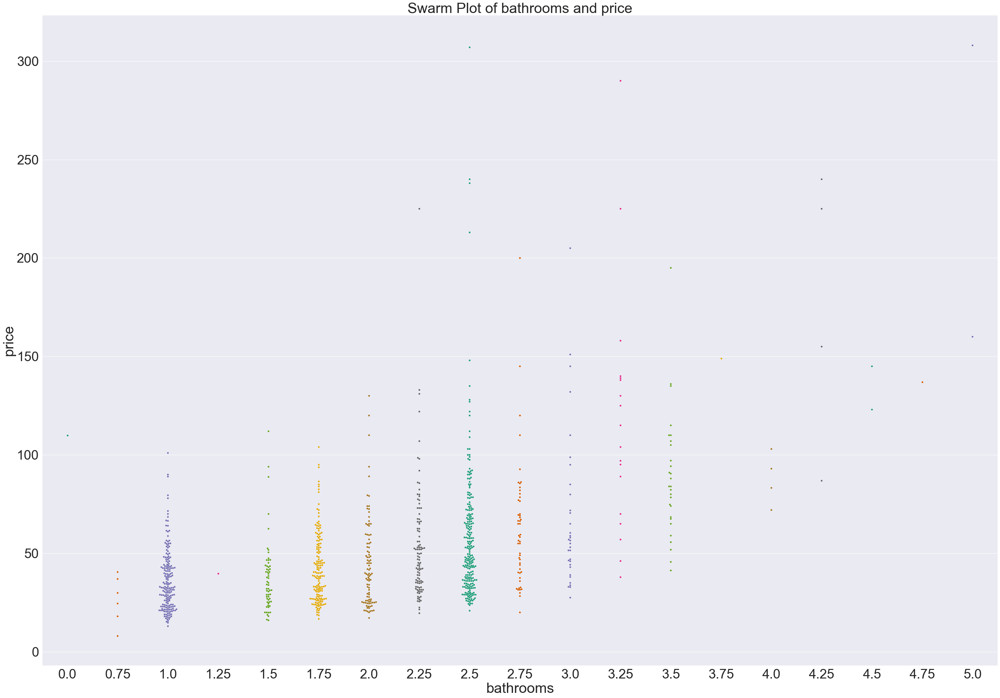

In [96]:
sns.swarmplot( x = "bathrooms" , y = "price" , data = df , palette="Dark2")
plt.title("Swarm Plot of bathrooms and price")

Text(0.5, 1.0, 'Swarm Plot of floors and price')

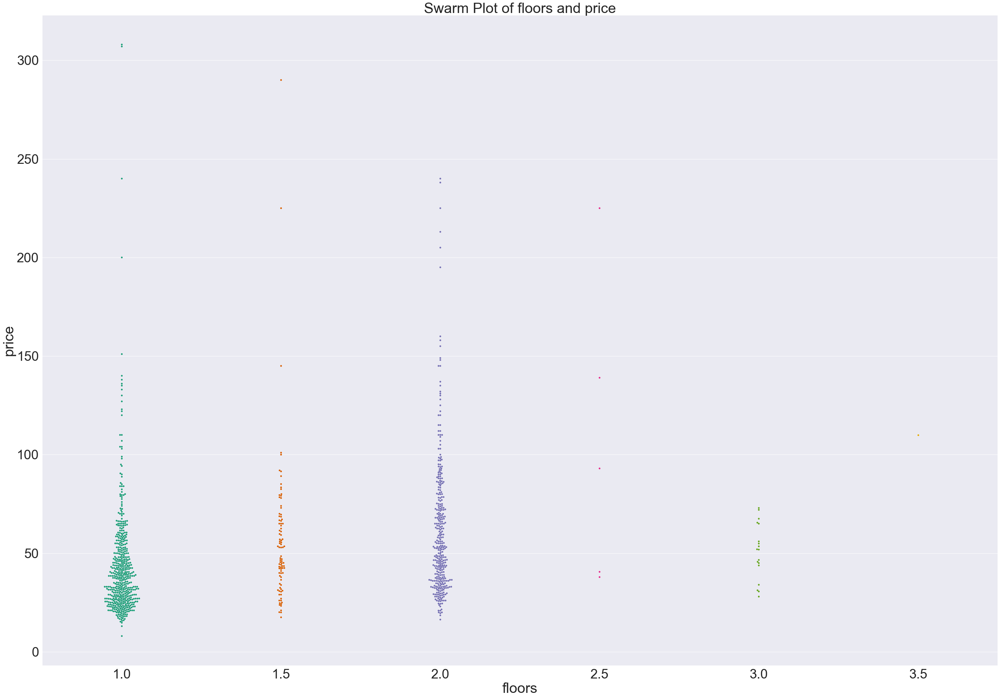

In [97]:
sns.swarmplot( x = "floors" , y = "price" , data = df , palette="Dark2")
plt.title("Swarm Plot of floors and price")

Text(0.5, 1.0, 'Swarm Plot of waterfront and price')

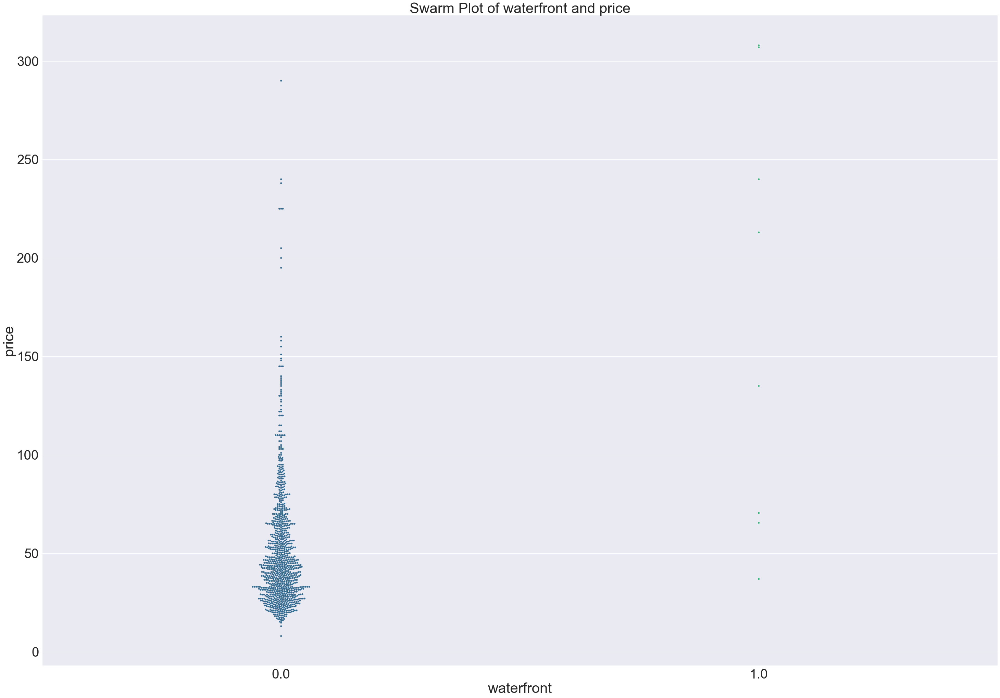

In [98]:
sns.swarmplot( x = "waterfront" , y = "price" , data = df , palette="viridis")
plt.title("Swarm Plot of waterfront and price")

Text(0.5, 1.0, 'Swarm Plot of view and price')

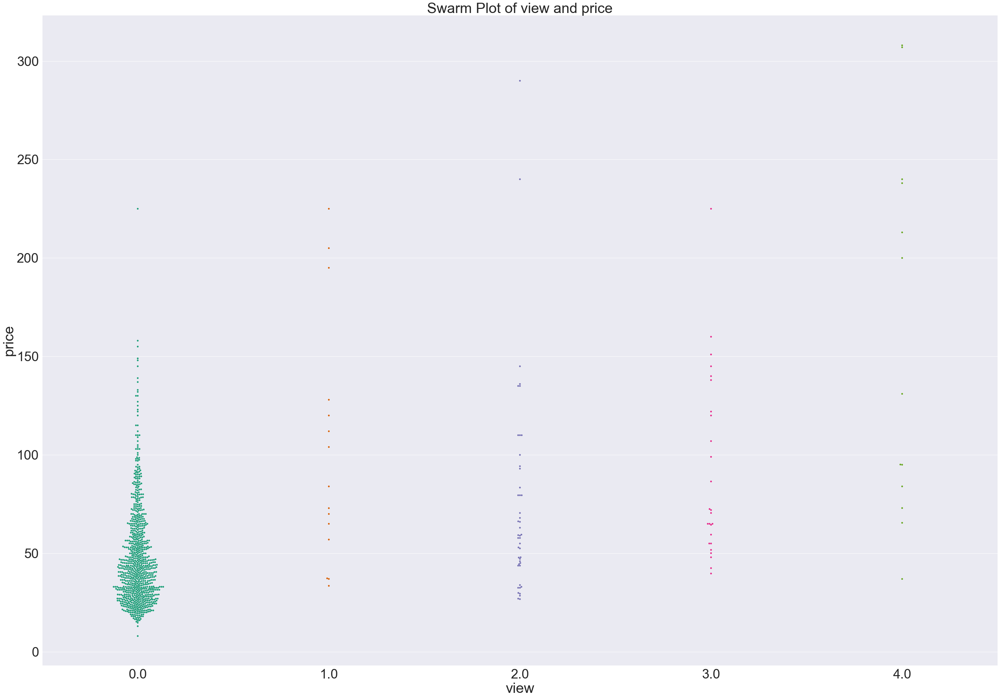

In [99]:
sns.swarmplot( x = "view" , y = "price" , data = df , palette="Dark2")
plt.title("Swarm Plot of view and price")

Text(0.5, 1.0, 'Swarm Plot of grade and price')

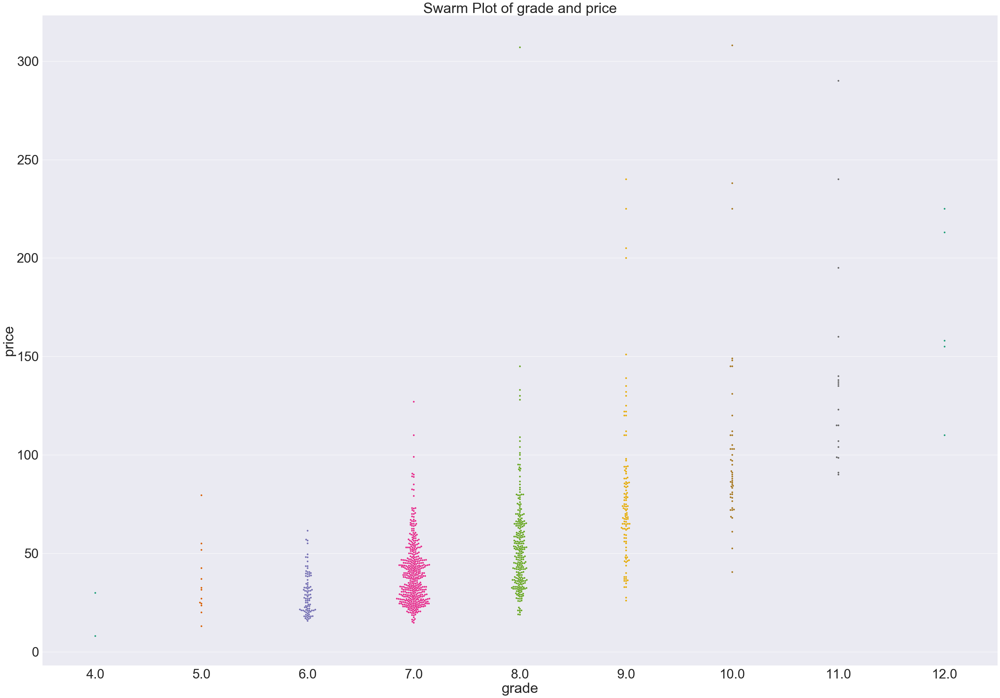

In [100]:
sns.swarmplot( x = "grade" , y = "price" , data = df , palette="Dark2")
plt.title("Swarm Plot of grade and price")

(array([  0,   1,   2,   3,   4,   5,   6,   7,   8,   9,  10,  11,  12,
         13,  14,  15,  16,  17,  18,  19,  20,  21,  22,  23,  24,  25,
         26,  27,  28,  29,  30,  31,  32,  33,  34,  35,  36,  37,  38,
         39,  40,  41,  42,  43,  44,  45,  46,  47,  48,  49,  50,  51,
         52,  53,  54,  55,  56,  57,  58,  59,  60,  61,  62,  63,  64,
         65,  66,  67,  68,  69,  70,  71,  72,  73,  74,  75,  76,  77,
         78,  79,  80,  81,  82,  83,  84,  85,  86,  87,  88,  89,  90,
         91,  92,  93,  94,  95,  96,  97,  98,  99, 100, 101, 102, 103,
        104, 105, 106, 107, 108, 109, 110, 111, 112, 113]),
 <a list of 114 Text xticklabel objects>)

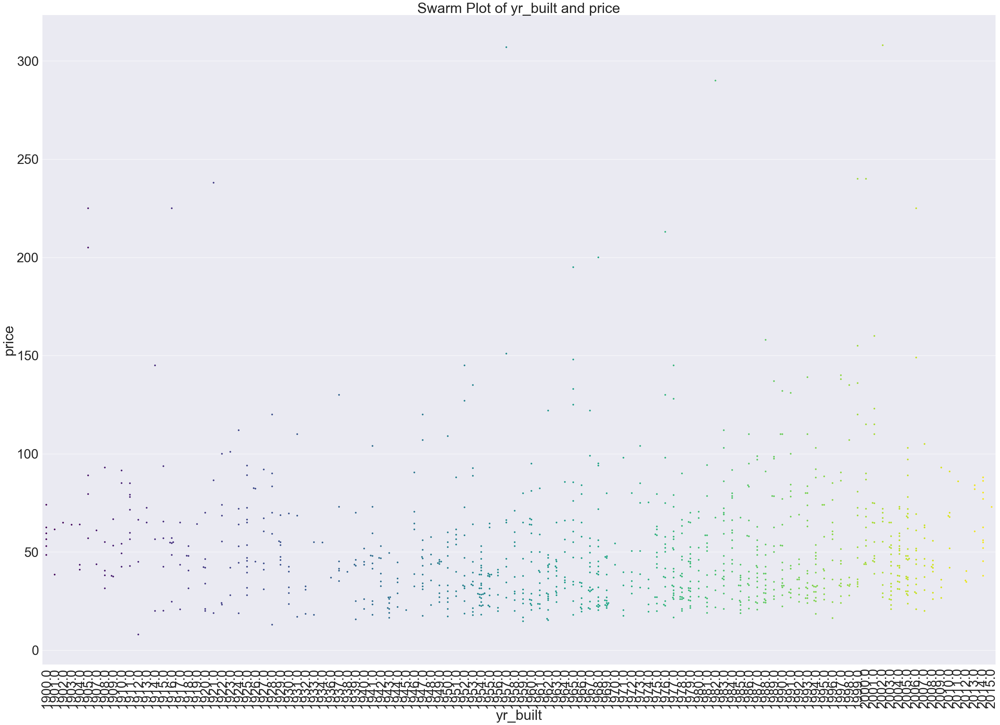

In [101]:
sns.swarmplot( x = "yr_built" , y = "price" , data = df , palette="viridis")
plt.title("Swarm Plot of yr_built and price")
plt.xticks(rotation = 90)

(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
        17, 18, 19, 20, 21, 22, 23, 24]),
 <a list of 25 Text xticklabel objects>)

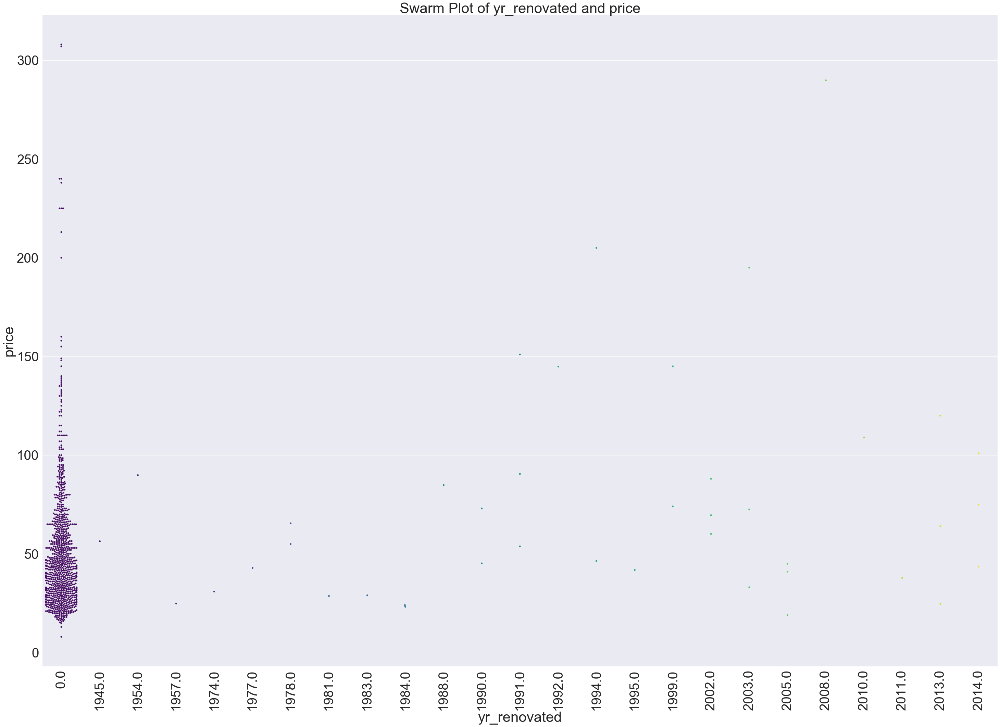

In [102]:
sns.swarmplot( x = "yr_renovated" , y = "price" , data = df , palette="viridis")
plt.title("Swarm Plot of yr_renovated and price")
plt.xticks(rotation = 90)

Text(0.5, 1.0, 'Box Plot of bedrooms and price Based on floors ')

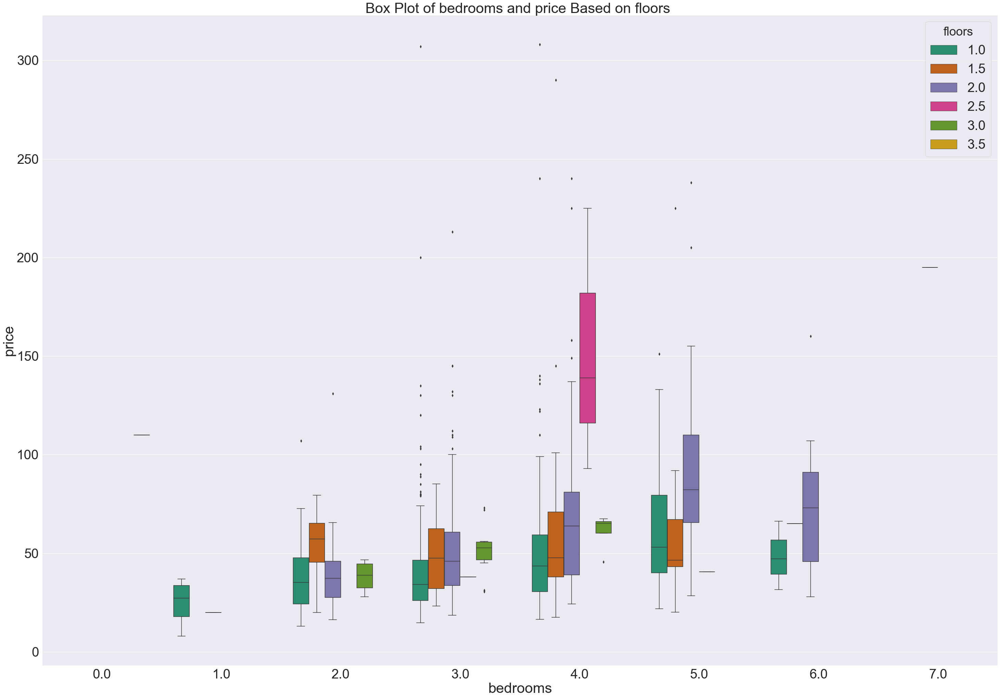

In [103]:
sns.boxplot( x = "bedrooms" , y = "price" , data = df ,hue = "floors" ,  palette="Dark2" , dodge=True)
plt.title("Box Plot of bedrooms and price Based on floors ")

Text(0.5, 1.0, 'Box Plot of bathrooms and price Based on floors ')

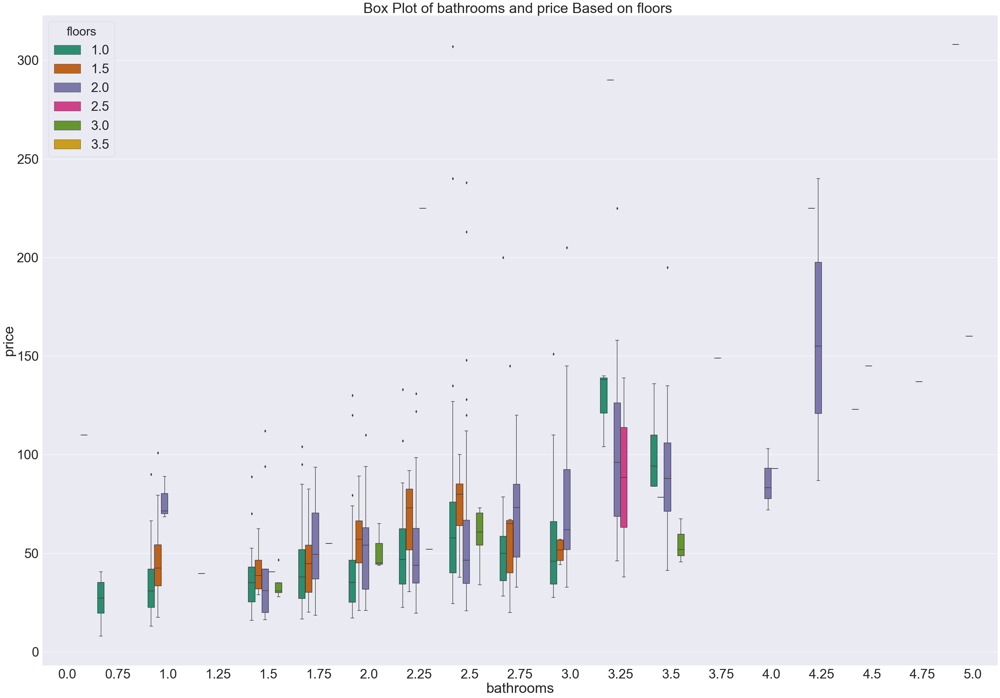

In [104]:
sns.boxplot( x = "bathrooms" , y = "price" , data = df ,hue = "floors" ,  palette="Dark2" , dodge=True)
plt.title("Box Plot of bathrooms and price Based on floors ")

Text(0.5, 1.0, 'Box Plot of floors and price Based on waterfront ')

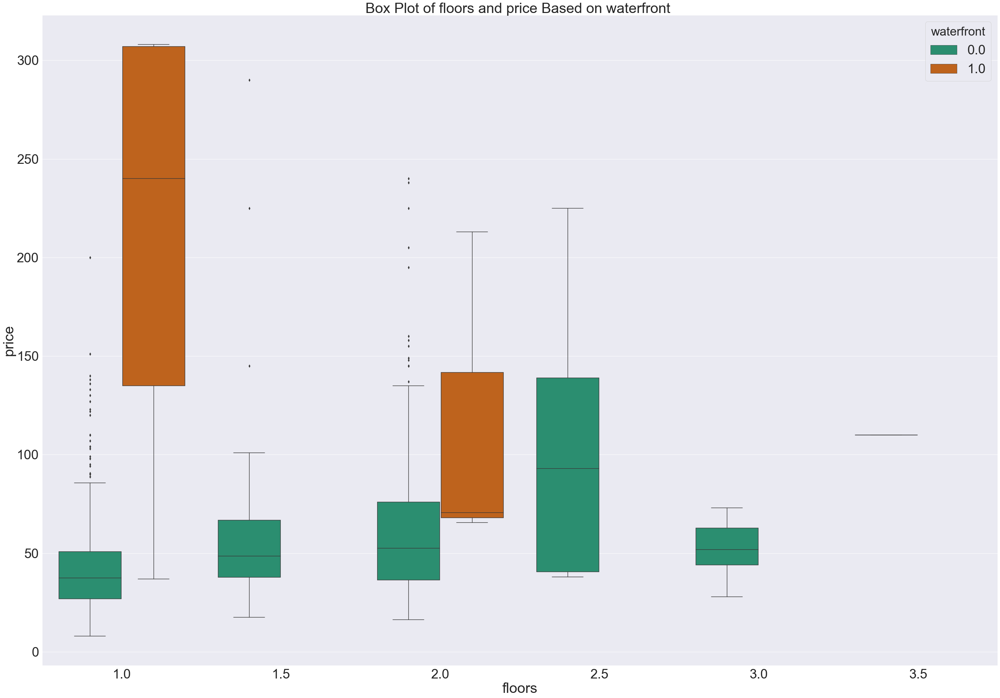

In [105]:
sns.boxplot( x = "floors" , y = "price" , data = df ,hue = "waterfront" ,  palette="Dark2" , dodge=True)
plt.title("Box Plot of floors and price Based on waterfront ")

Text(0.5, 1.0, 'Box Plot of waterfront and price Based on floors ')

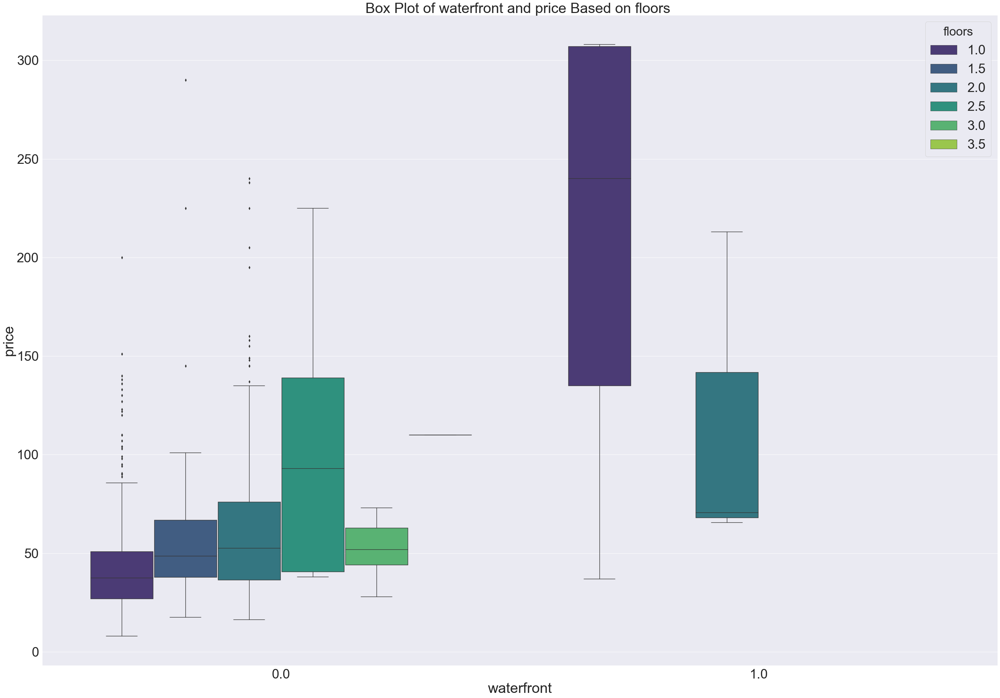

In [106]:
sns.boxplot( x = "waterfront" , y = "price" , data = df ,hue = "floors" ,  palette="viridis" , dodge=True)
plt.title("Box Plot of waterfront and price Based on floors ")

Text(0.5, 1.0, 'Box Plot of view and price Based on floors ')

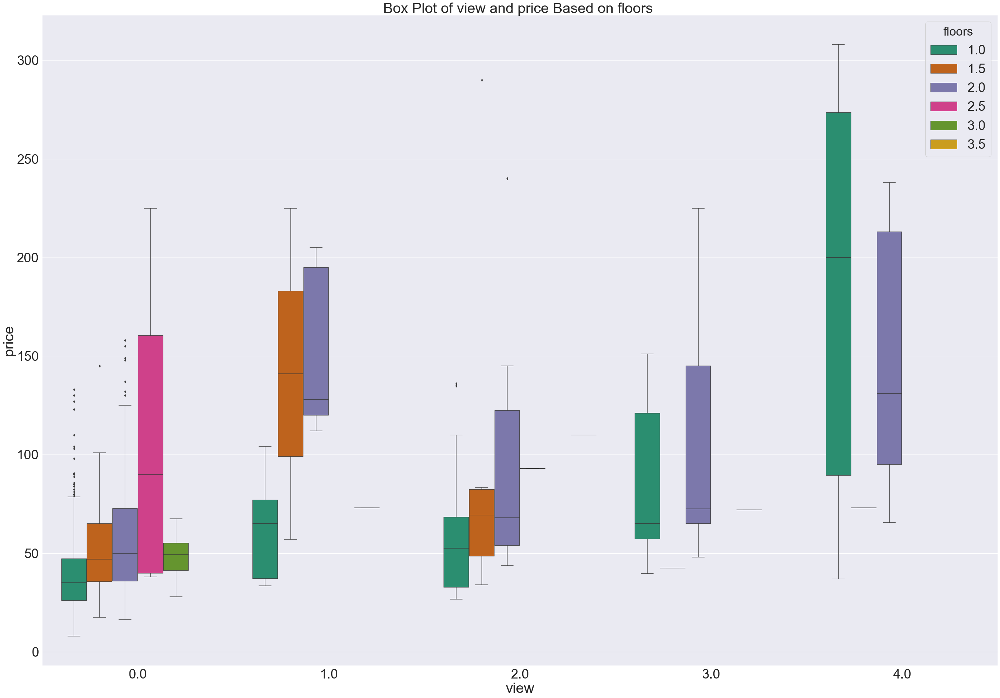

In [107]:
sns.boxplot( x = "view" , y = "price" , data = df ,hue = "floors" ,  palette="Dark2" , dodge=True)
plt.title("Box Plot of view and price Based on floors ")

Text(0.5, 1.0, 'Box Plot of floors and price Based on view ')

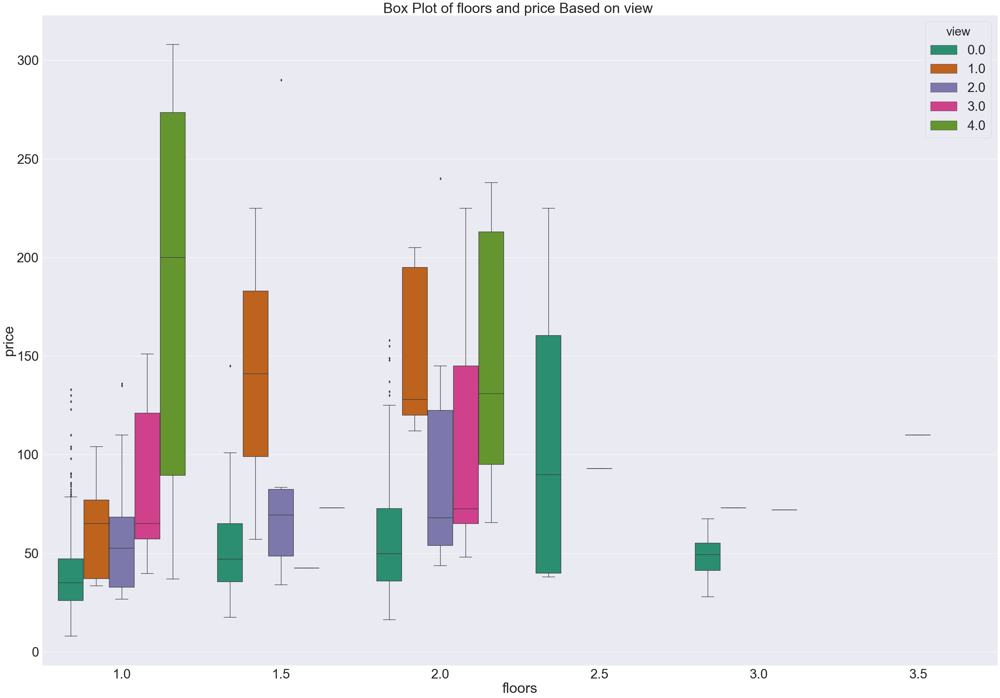

In [108]:
sns.boxplot( x = "floors" , y = "price" , data = df ,hue = "view" ,  palette="Dark2" , dodge=True)
plt.title("Box Plot of floors and price Based on view ")

Text(0.5, 1.0, 'Box Plot of floors and price Based on view ')

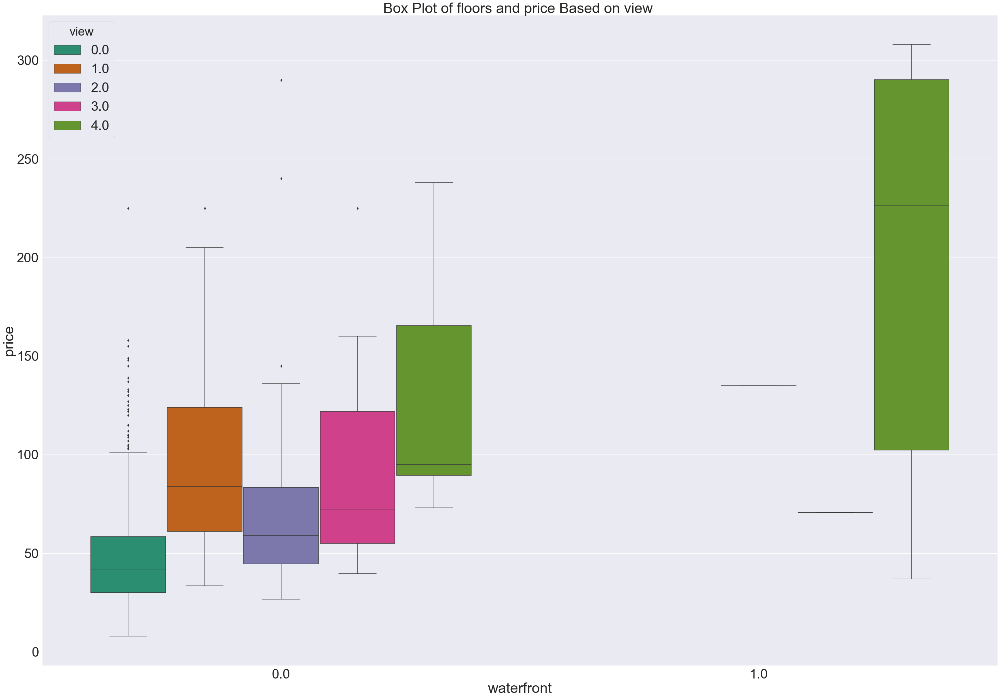

In [109]:
sns.boxplot( x = "waterfront" , y = "price" , data = df ,hue = "view" ,  palette="Dark2" , dodge=True)
plt.title("Box Plot of floors and price Based on view ")

Text(0.5, 1.0, 'Box Plot of view and price Based on waterfront ')

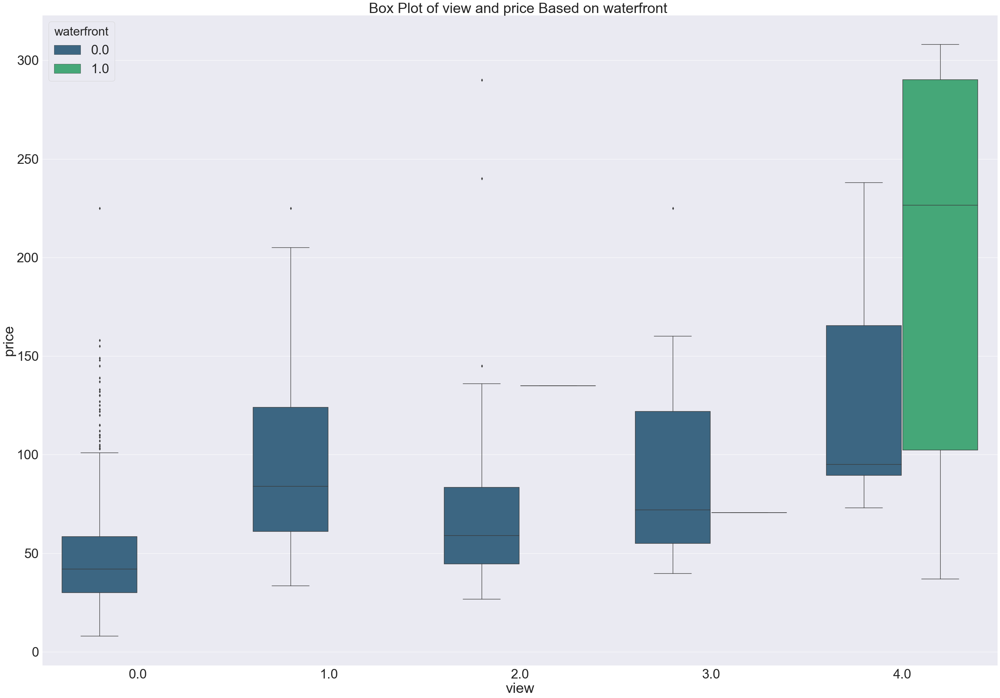

In [110]:
sns.boxplot( x = "view" , y = "price" , data = df ,hue = "waterfront" ,  palette="viridis" , dodge=True)
plt.title("Box Plot of view and price Based on waterfront ")

Text(0.5, 1.0, 'Count Plot of bedrooms Based on floors ')

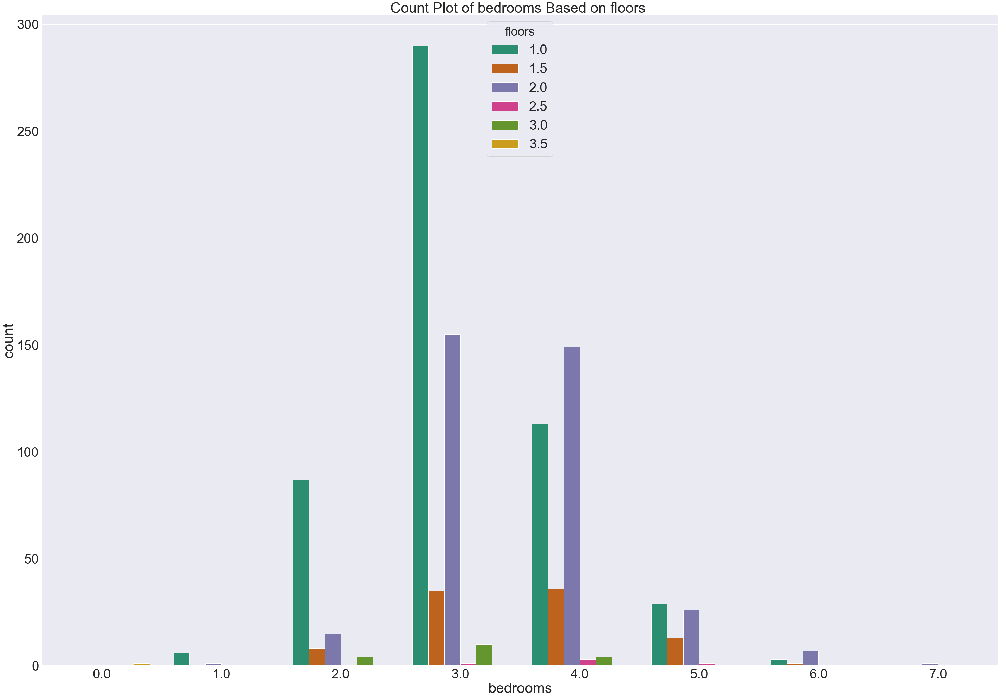

In [111]:
sns.countplot( x = "bedrooms"  , data = df , hue="floors" , palette="Dark2")
plt.title("Count Plot of bedrooms Based on floors ")

Text(0.5, 1.0, 'Count Plot of bathrooms Based on floors ')

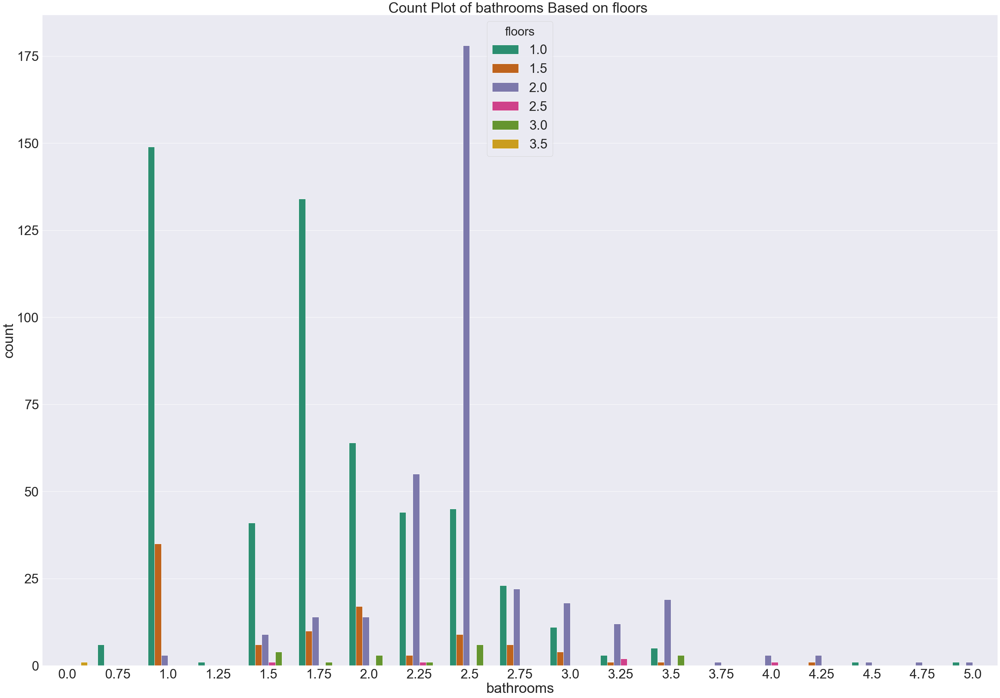

In [112]:
sns.countplot( x = "bathrooms"  , data = df , hue="floors" , palette="Dark2")
plt.title("Count Plot of bathrooms Based on floors ")

Text(0.5, 1.0, 'Count Plot of waterfront Based on floors ')

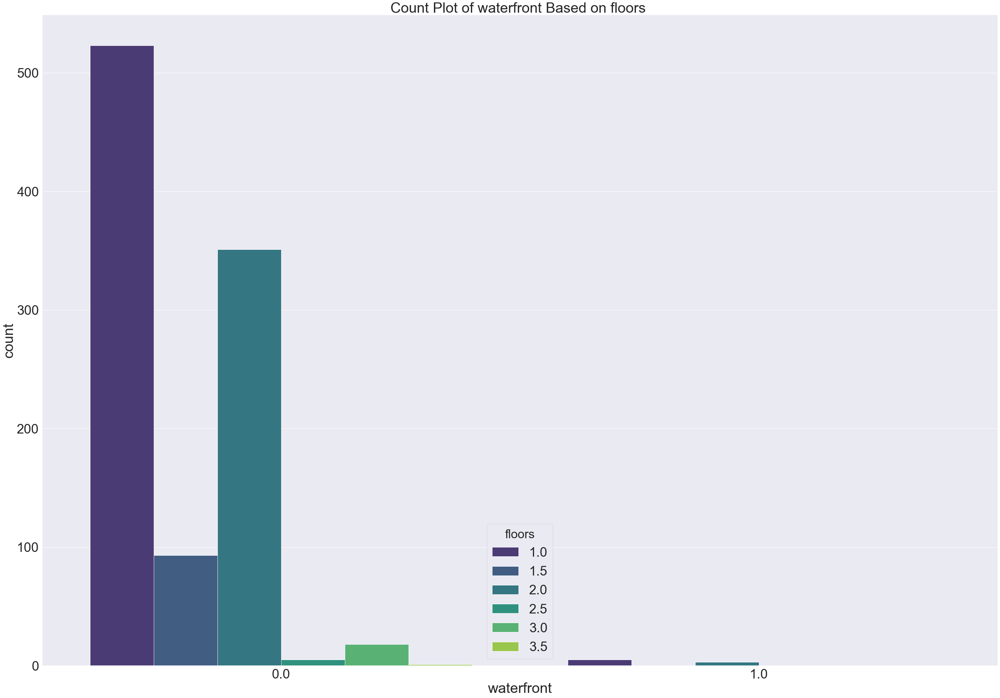

In [113]:
sns.countplot( x = "waterfront"  , data = df , hue="floors" , palette="viridis")
plt.title("Count Plot of waterfront Based on floors ")

Text(0.5, 1.0, 'Count Plot of gender Based on floors ')

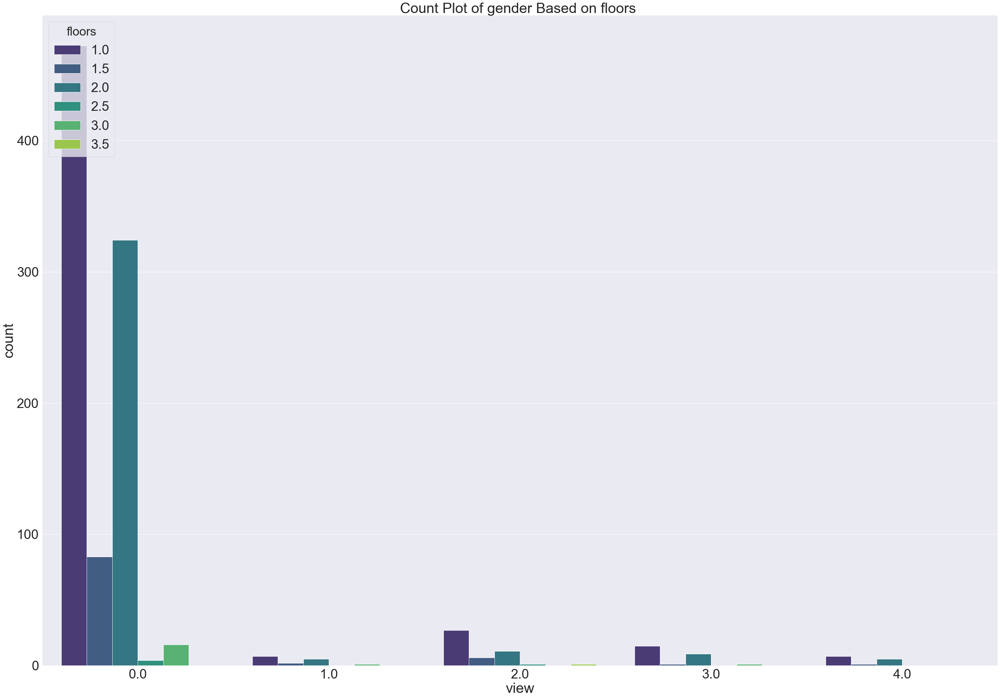

In [114]:
sns.countplot( x = "view"  , data = df , hue="floors" , palette="viridis")
plt.title("Count Plot of gender Based on floors ")

Text(0.5, 1.0, 'Count Plot of bedrooms Based on view ')

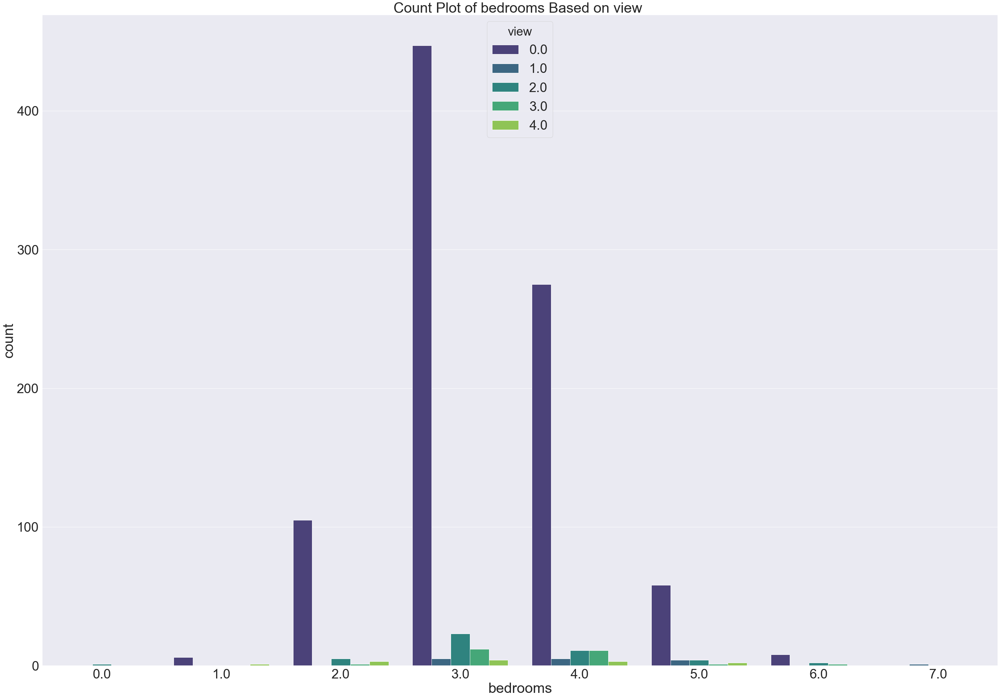

In [115]:
sns.countplot( x = "bedrooms"  , data = df , hue="view" , palette="viridis")
plt.title("Count Plot of bedrooms Based on view ")

Text(0.5, 1.0, 'Count Plot of bathrooms Based on view ')

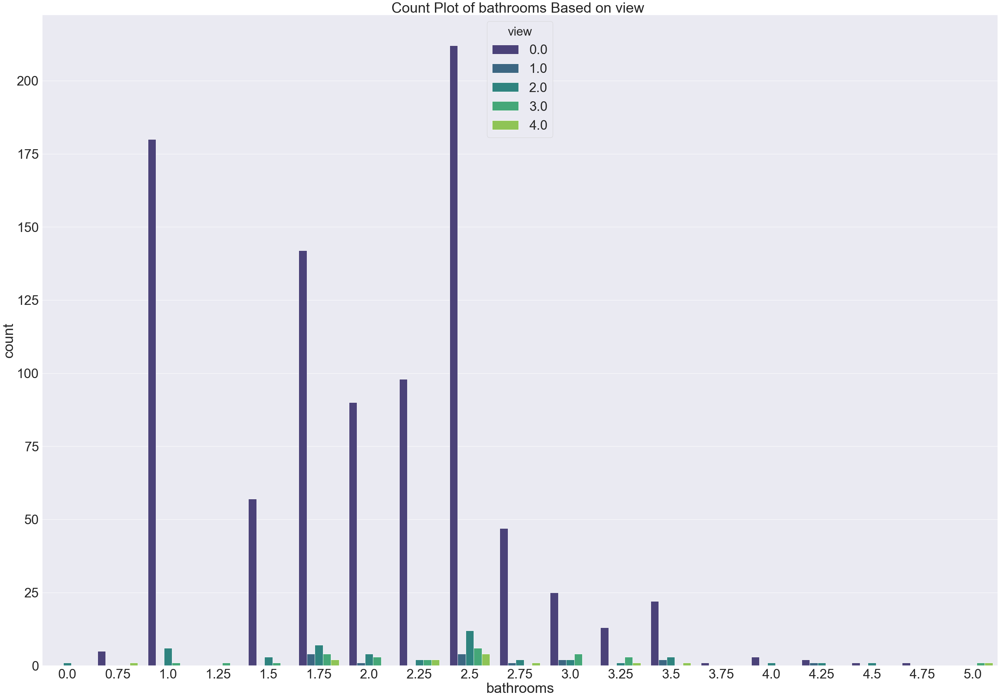

In [116]:
sns.countplot( x = "bathrooms"  , data = df , hue="view" , palette="viridis")
plt.title("Count Plot of bathrooms Based on view ")

Text(0.5, 1.0, 'Count Plot of waterfront Based on view ')

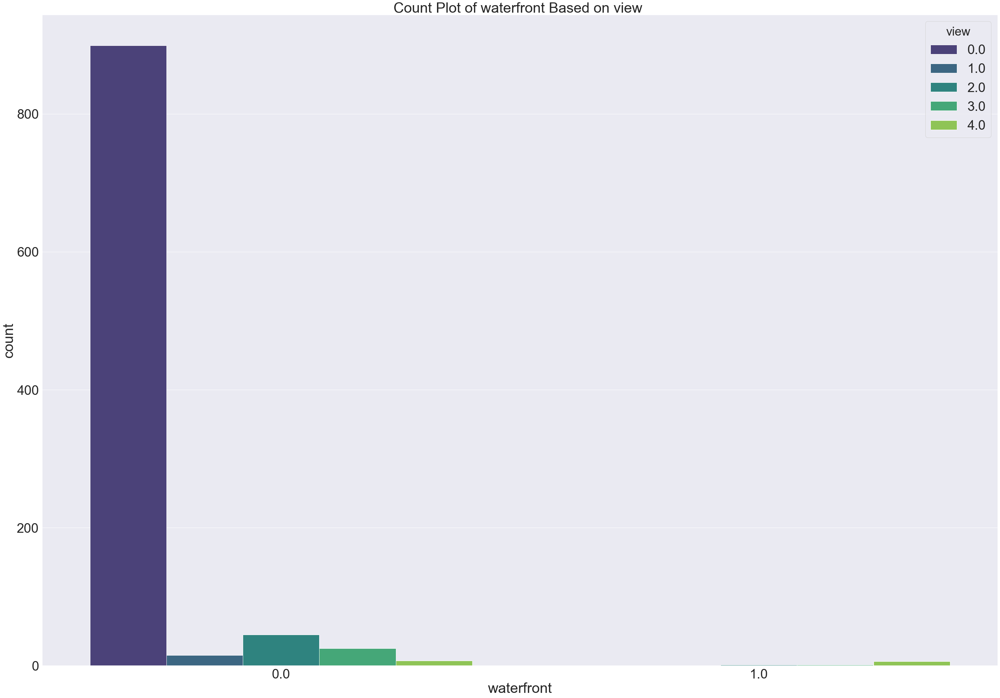

In [117]:
sns.countplot( x = "waterfront"  , data = df , hue="view" , palette="viridis")
plt.title("Count Plot of waterfront Based on view ")

Text(0.5, 1.0, 'Count Plot of bedrooms Based on waterfront ')

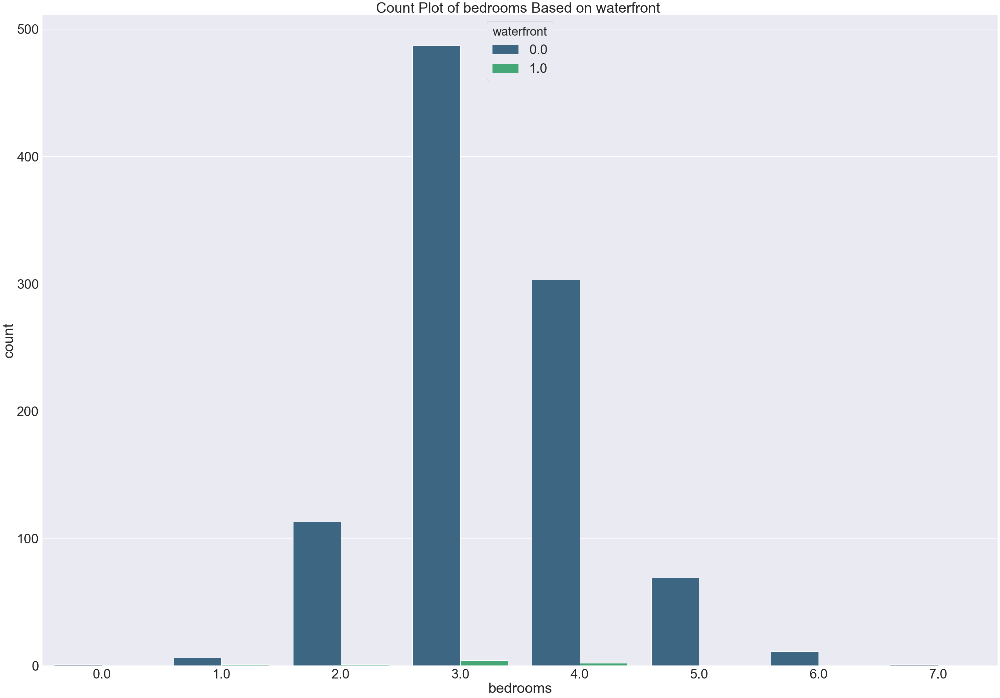

In [118]:
sns.countplot( x = "bedrooms"  , data = df , hue="waterfront" , palette="viridis")
plt.title("Count Plot of bedrooms Based on waterfront ")

Text(0.5, 1.0, 'Count Plot of bathrooms Based on waterfront ')

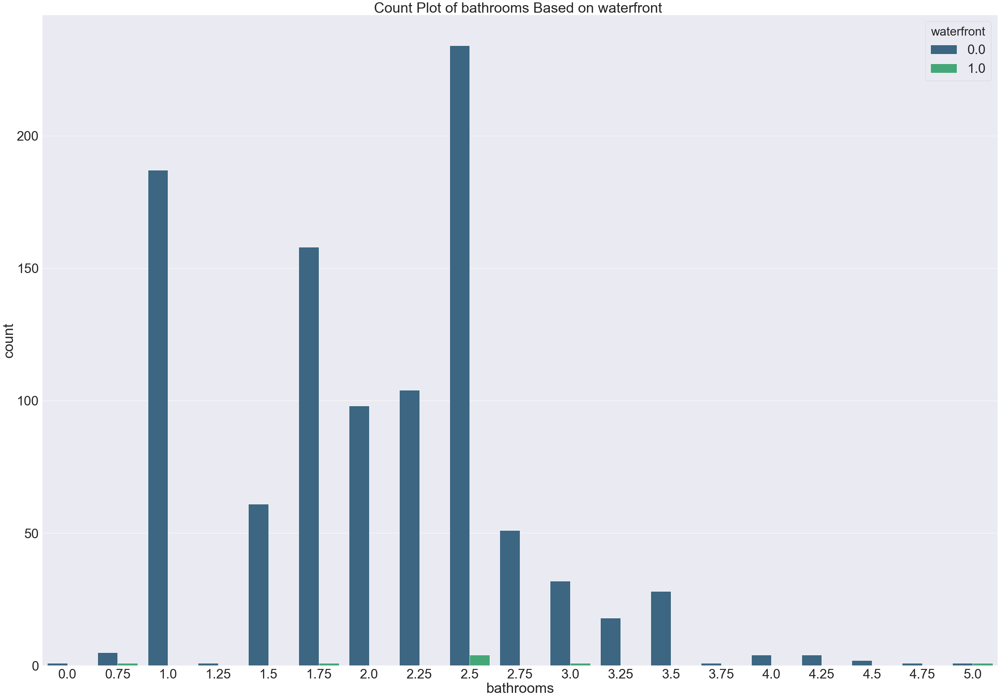

In [119]:
sns.countplot( x = "bathrooms"  , data = df , hue="waterfront" , palette="viridis")
plt.title("Count Plot of bathrooms Based on waterfront ")

Text(0.5, 1.0, 'Count Plot of view')

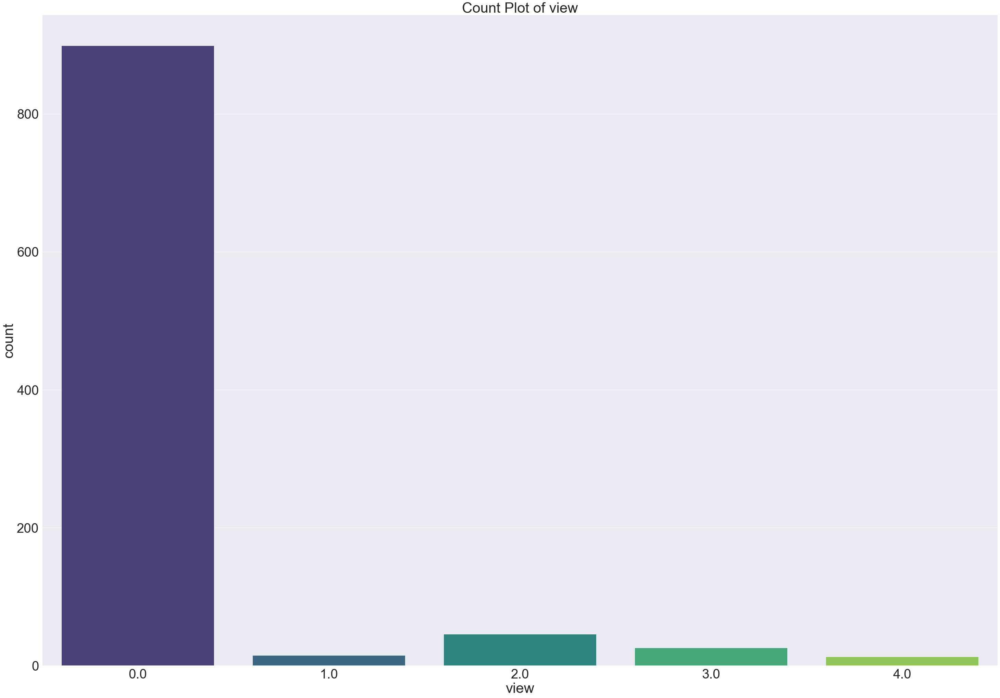

In [120]:
sns.countplot( x = "view"  , data = df , palette="viridis")
plt.title("Count Plot of view")

Text(0.5, 1.0, 'Count Plot of bedrooms ')

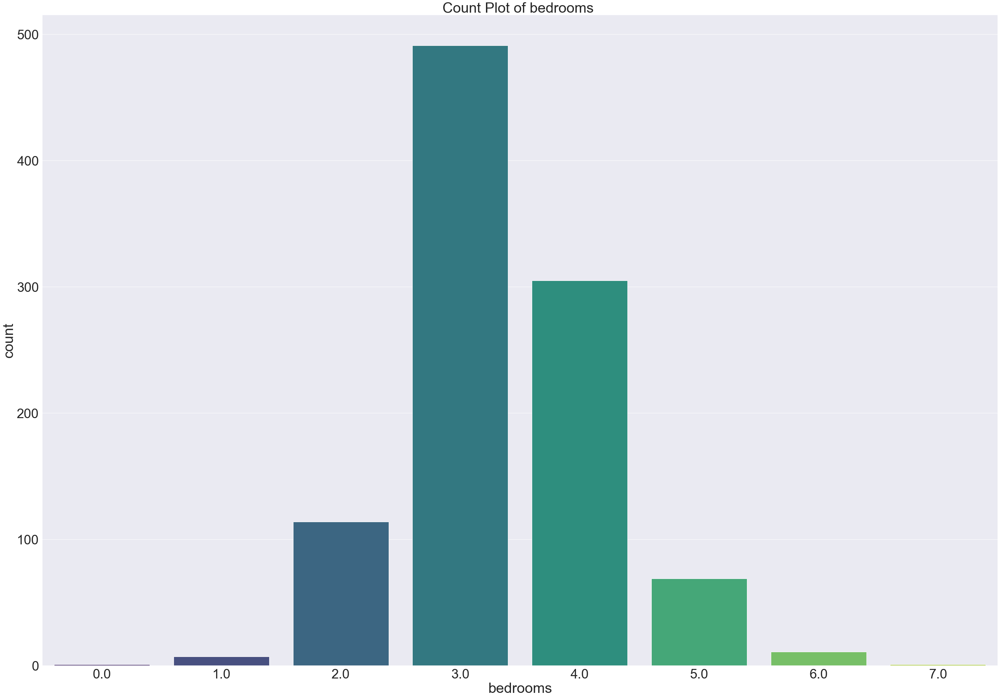

In [121]:
sns.countplot( x = "bedrooms"  , data = df , palette="viridis")
plt.title("Count Plot of bedrooms ")

Text(0.5, 1.0, 'Count Plot of bathrooms ')

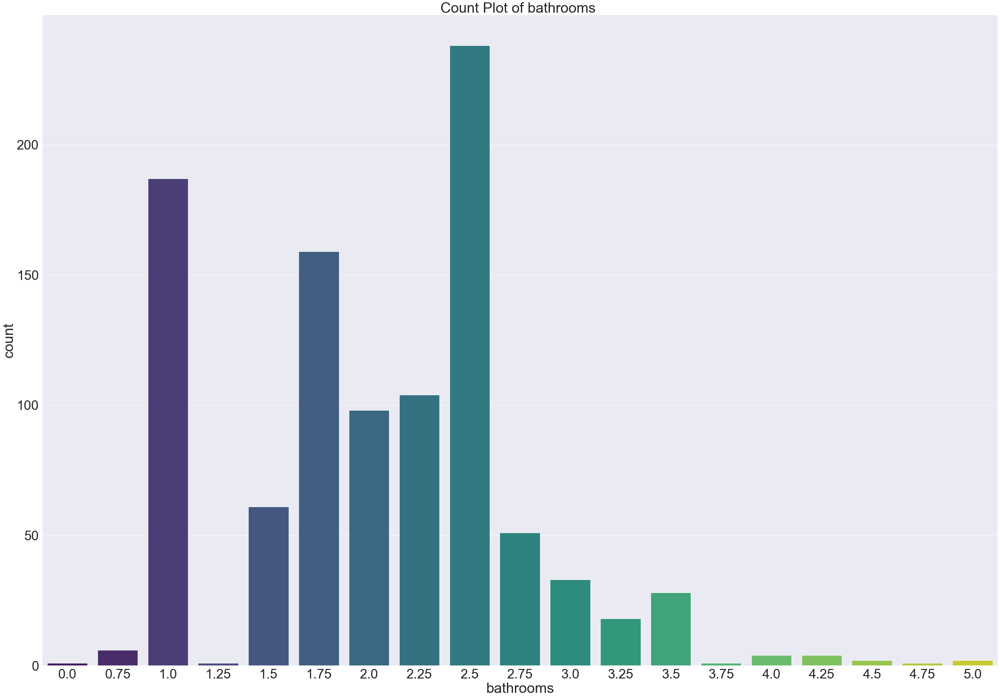

In [122]:
sns.countplot( x = "bathrooms"  , data = df , palette="viridis")
plt.title("Count Plot of bathrooms ")

Text(0.5, 1.0, 'Count Plot of waterfront ')

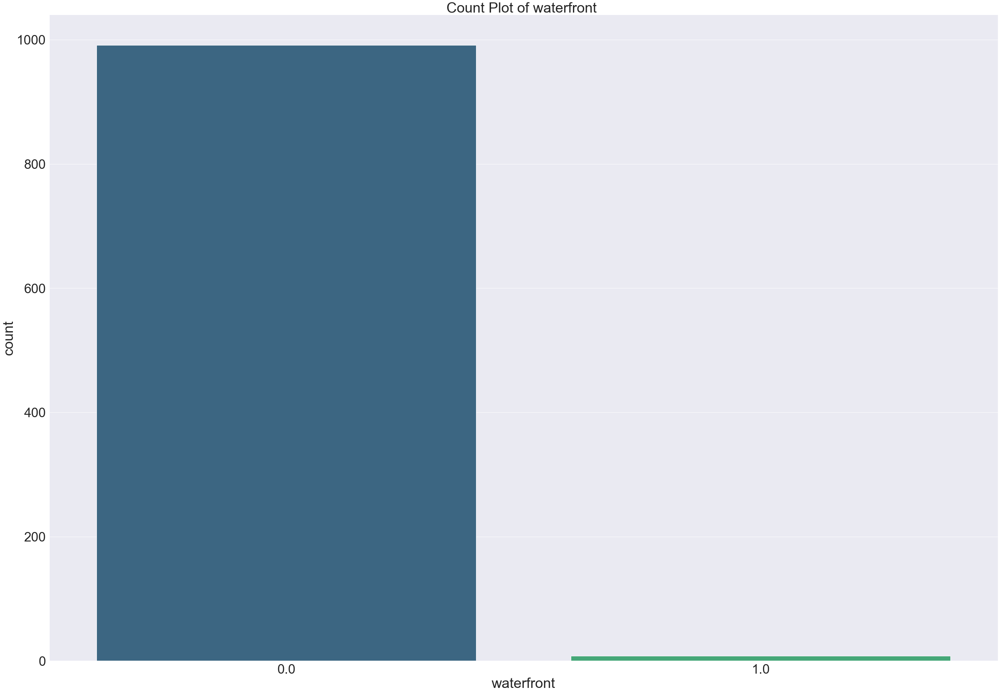

In [123]:
sns.countplot( x = "waterfront"  , data = df , palette="viridis")
plt.title("Count Plot of waterfront ")

Text(0.5, 1.0, 'Count Plot floors')

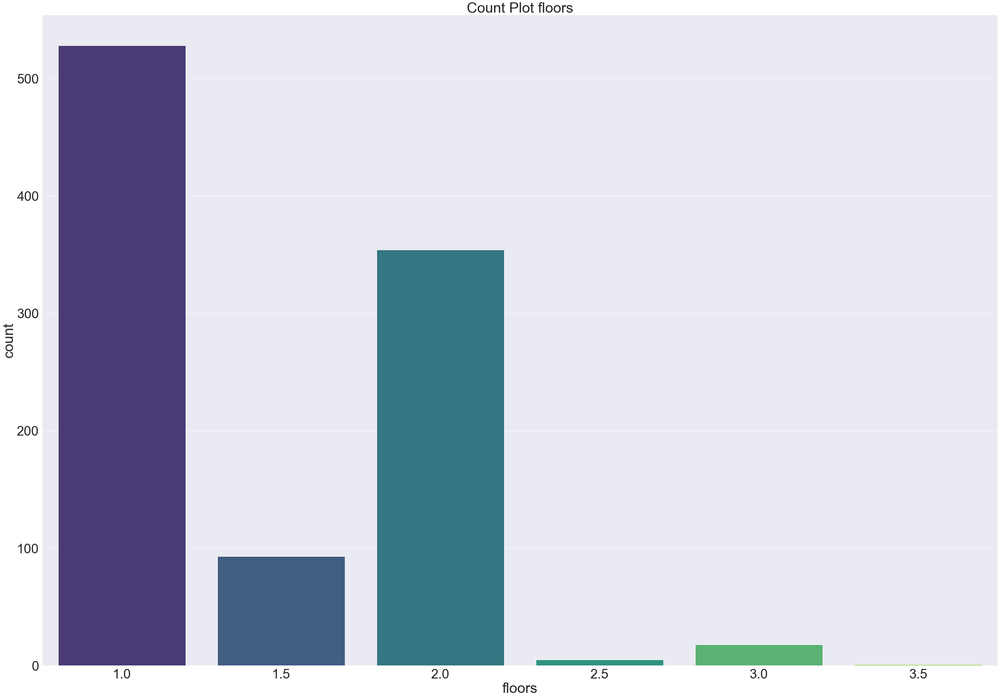

In [124]:
sns.countplot( x = "floors"  , data = df , palette="viridis")
plt.title("Count Plot floors")

(array([  0,   1,   2,   3,   4,   5,   6,   7,   8,   9,  10,  11,  12,
         13,  14,  15,  16,  17,  18,  19,  20,  21,  22,  23,  24,  25,
         26,  27,  28,  29,  30,  31,  32,  33,  34,  35,  36,  37,  38,
         39,  40,  41,  42,  43,  44,  45,  46,  47,  48,  49,  50,  51,
         52,  53,  54,  55,  56,  57,  58,  59,  60,  61,  62,  63,  64,
         65,  66,  67,  68,  69,  70,  71,  72,  73,  74,  75,  76,  77,
         78,  79,  80,  81,  82,  83,  84,  85,  86,  87,  88,  89,  90,
         91,  92,  93,  94,  95,  96,  97,  98,  99, 100, 101, 102, 103,
        104, 105, 106, 107, 108, 109, 110, 111, 112, 113]),
 <a list of 114 Text xticklabel objects>)

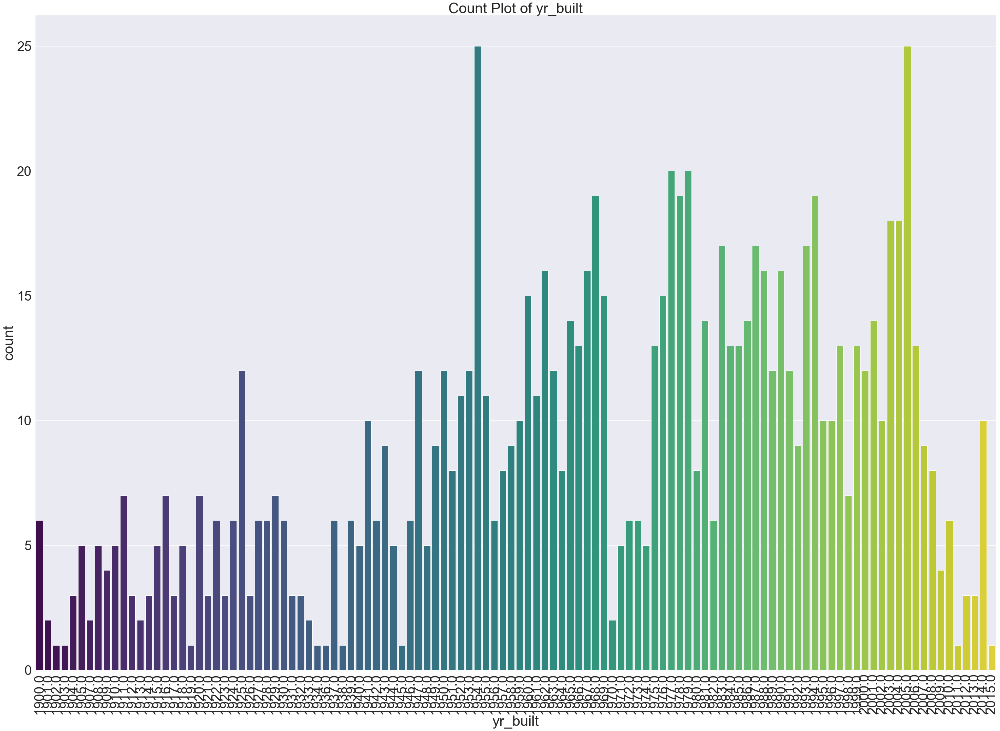

In [125]:
sns.countplot( x = "yr_built"  , data = df , palette="viridis")
plt.title("Count Plot of yr_built")
plt.xticks(rotation = 90)

(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
        17, 18, 19, 20, 21, 22, 23, 24]),
 <a list of 25 Text xticklabel objects>)

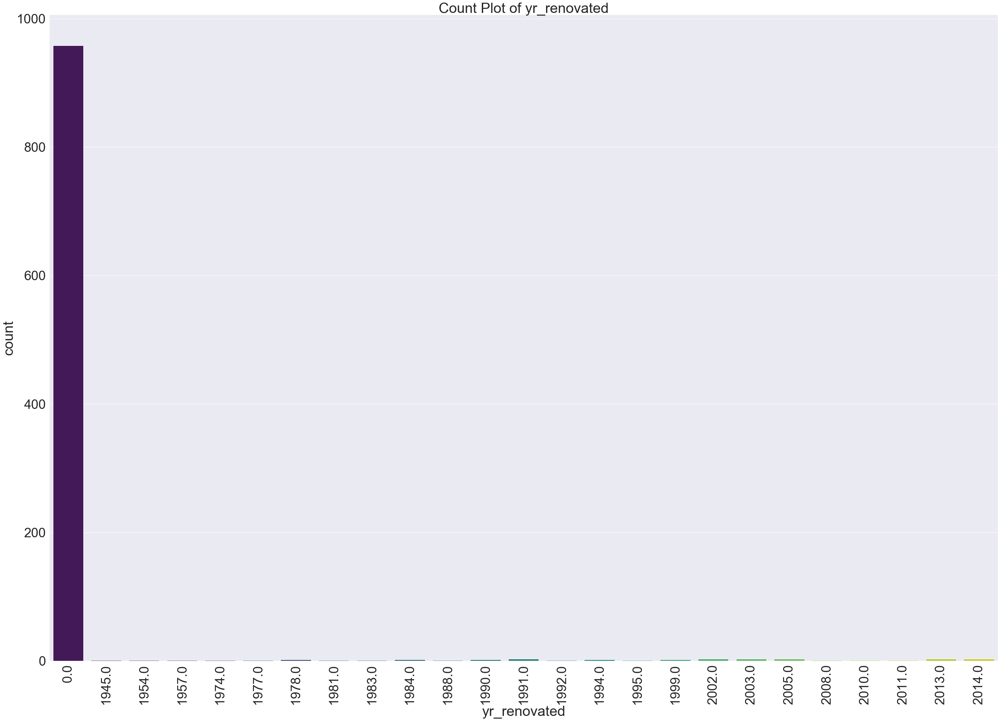

In [126]:
sns.countplot( x = "yr_renovated"  , data = df , palette="viridis")
plt.title("Count Plot of yr_renovated")
plt.xticks(rotation = 90)

(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
        17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33,
        34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50,
        51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67,
        68]), <a list of 69 Text xticklabel objects>)

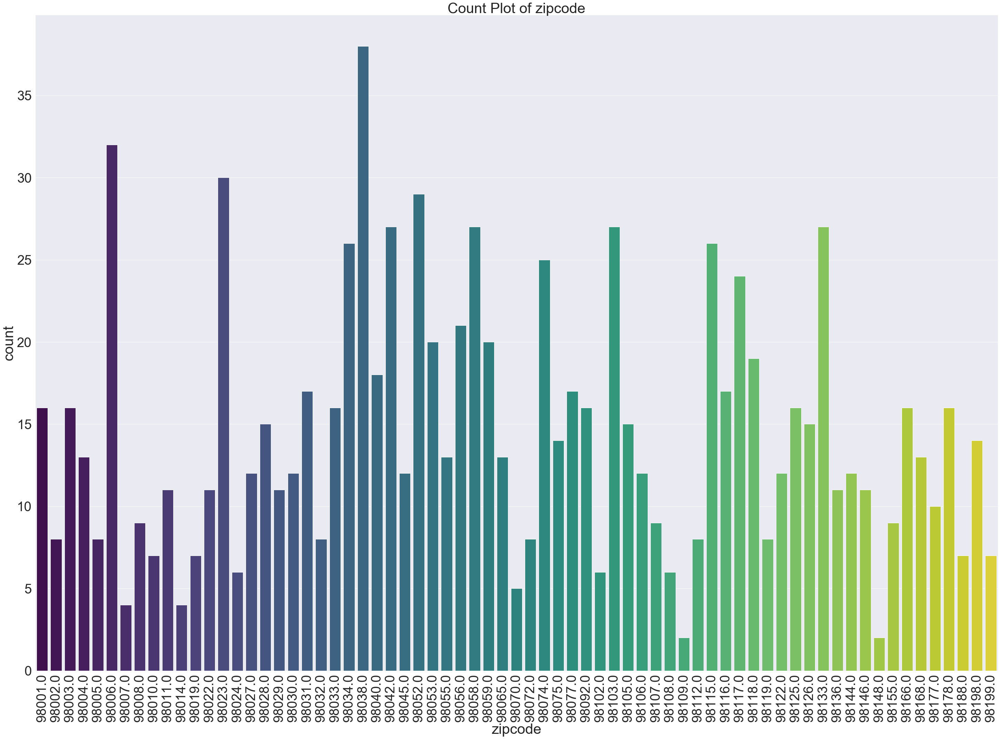

In [127]:
sns.countplot( x = "zipcode"  , data = df , palette="viridis")
plt.title("Count Plot of zipcode")
plt.xticks(rotation = 90)

Text(0.5, 1.0, 'Count Plot of grade')

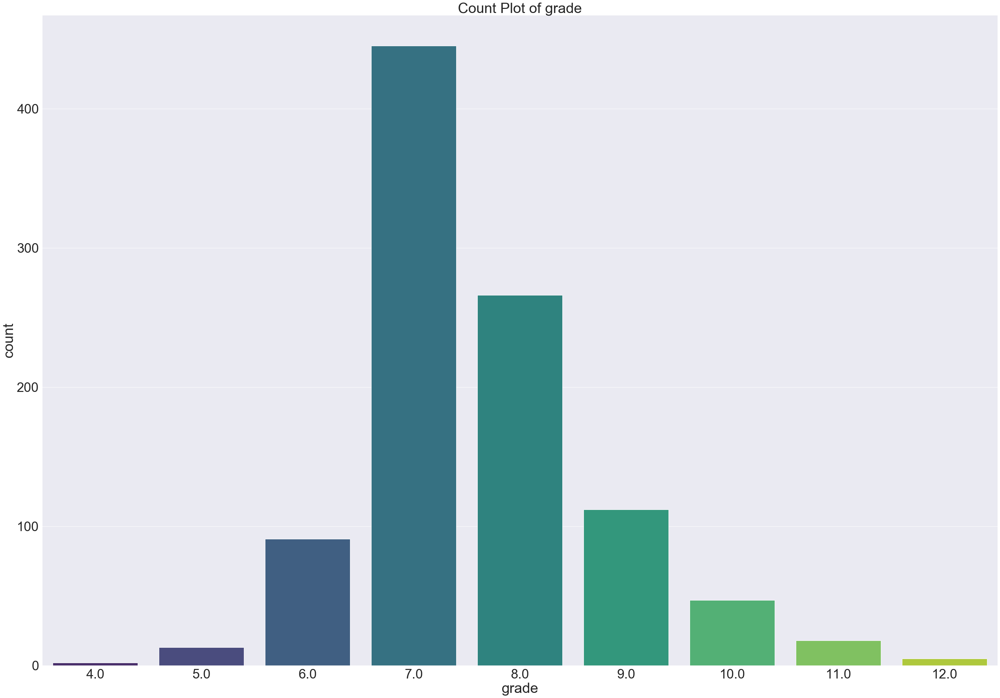

In [128]:
sns.countplot( x = "grade"  , data = df , palette="viridis")
plt.title("Count Plot of grade")

Text(0.5, 1.0, 'Count Plot of condition')

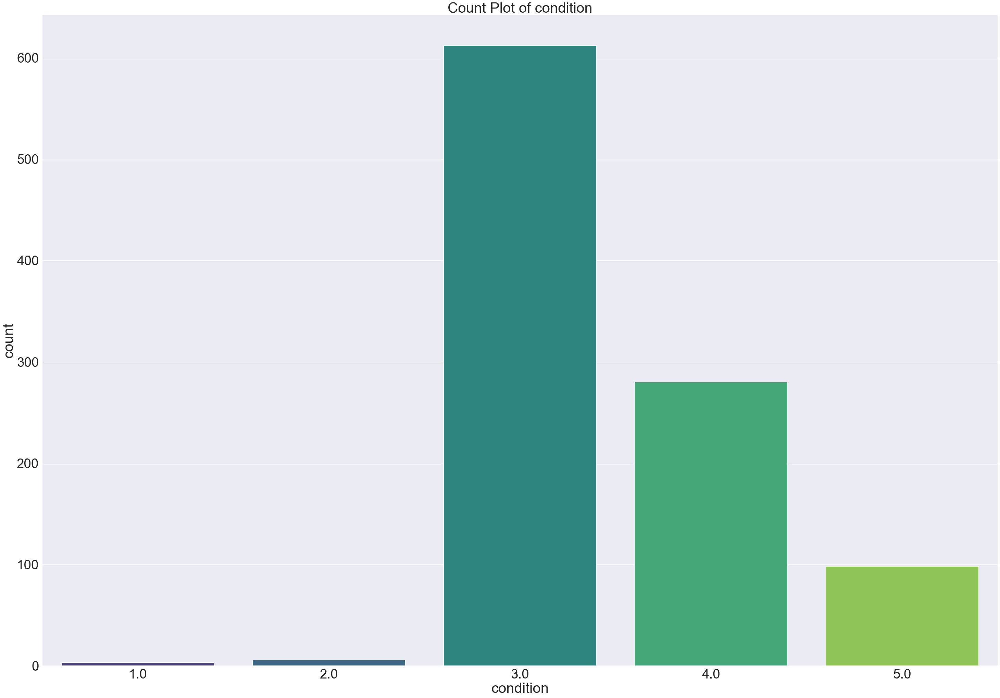

In [129]:
sns.countplot( x = "condition"  , data = df , palette="viridis")
plt.title("Count Plot of condition")

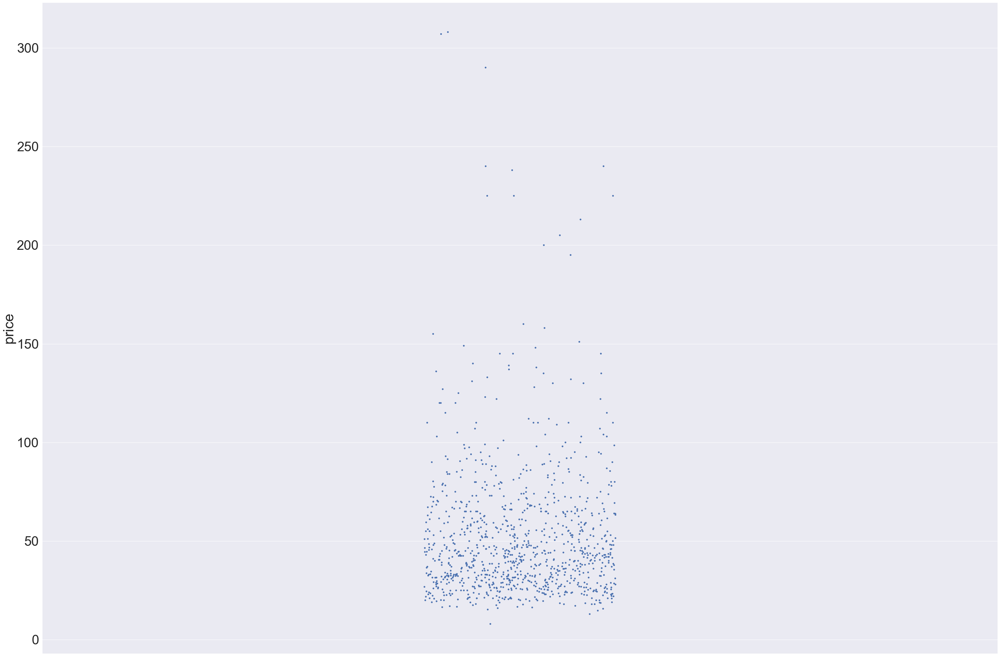

In [130]:
sns.stripplot(y ="price" , data = df ) 

In [131]:
df.columns

Index(['bedrooms', 'bathrooms', 'sqft_living', 'sqft_lot', 'floors',
       'waterfront', 'view', 'condition', 'grade', 'sqft_above',
       'sqft_basement', 'yr_built', 'yr_renovated', 'zipcode', 'lat', 'long',
       'sqft_living15', 'price'],
      dtype='object')

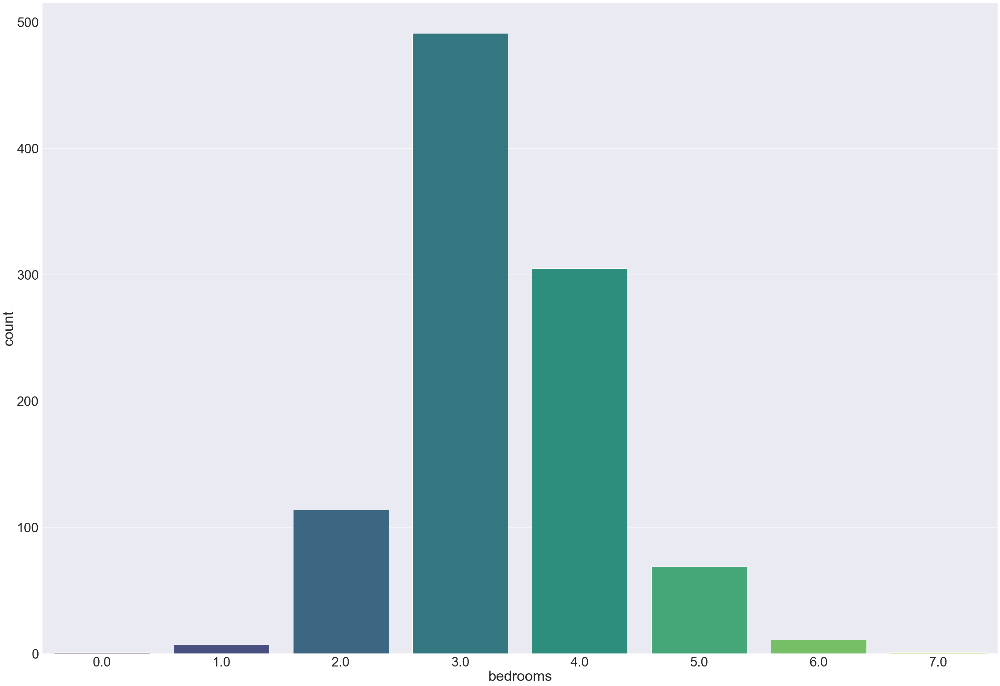

In [132]:
sns.countplot("bedrooms" , data = df , palette="viridis")

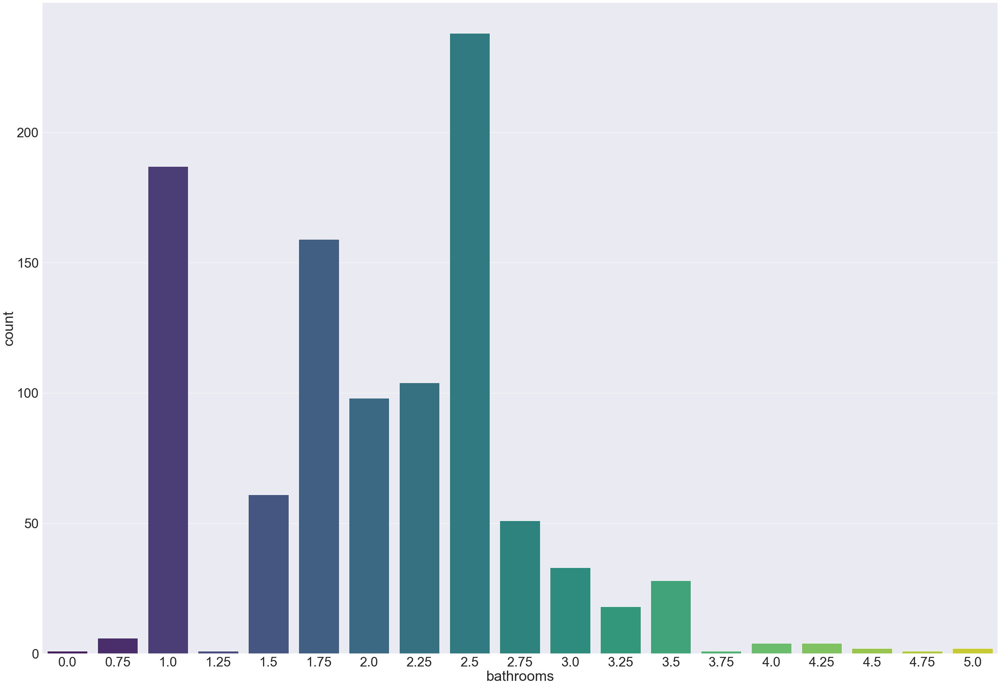

In [133]:
sns.countplot("bathrooms" , data = df , palette="viridis")

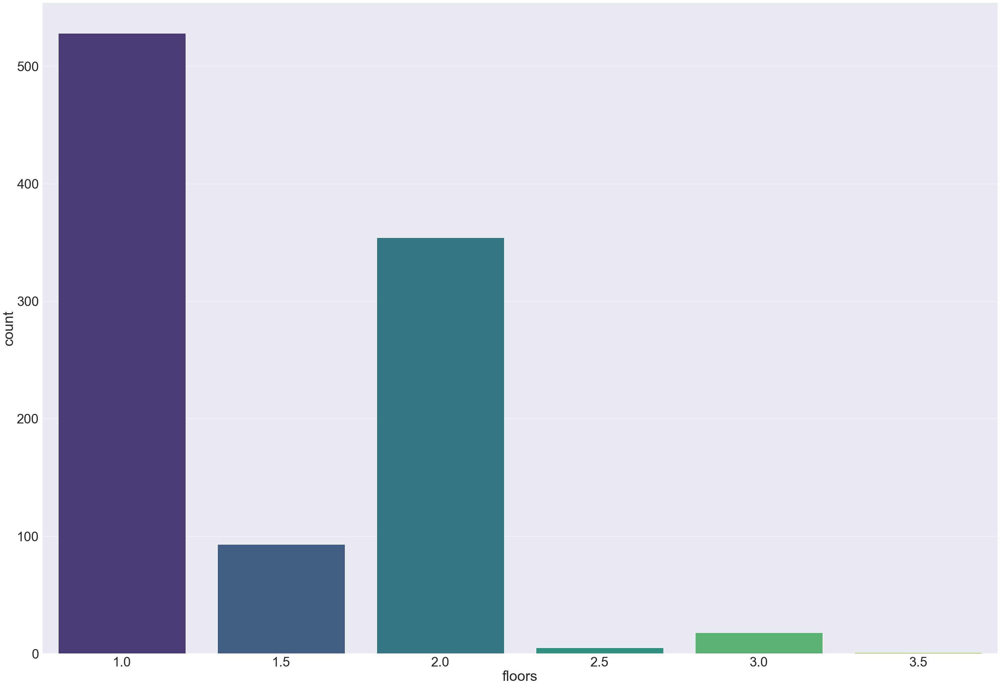

In [134]:
sns.countplot("floors" , data = df , palette="viridis")

(array([  0,   1,   2,   3,   4,   5,   6,   7,   8,   9,  10,  11,  12,
         13,  14,  15,  16,  17,  18,  19,  20,  21,  22,  23,  24,  25,
         26,  27,  28,  29,  30,  31,  32,  33,  34,  35,  36,  37,  38,
         39,  40,  41,  42,  43,  44,  45,  46,  47,  48,  49,  50,  51,
         52,  53,  54,  55,  56,  57,  58,  59,  60,  61,  62,  63,  64,
         65,  66,  67,  68,  69,  70,  71,  72,  73,  74,  75,  76,  77,
         78,  79,  80,  81,  82,  83,  84,  85,  86,  87,  88,  89,  90,
         91,  92,  93,  94,  95,  96,  97,  98,  99, 100, 101, 102, 103,
        104, 105, 106, 107, 108, 109, 110, 111, 112, 113]),
 <a list of 114 Text xticklabel objects>)

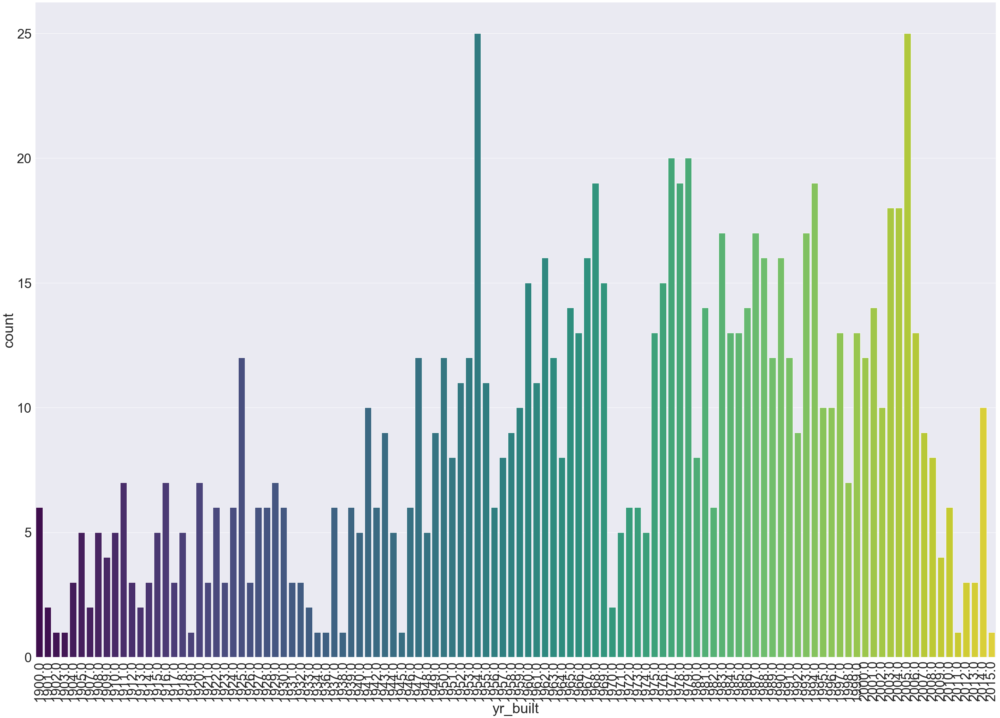

In [135]:
sns.countplot("yr_built" , data = df , palette="viridis")
plt.xticks(rotation = 90)

(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
        17, 18, 19, 20, 21, 22, 23, 24]),
 <a list of 25 Text xticklabel objects>)

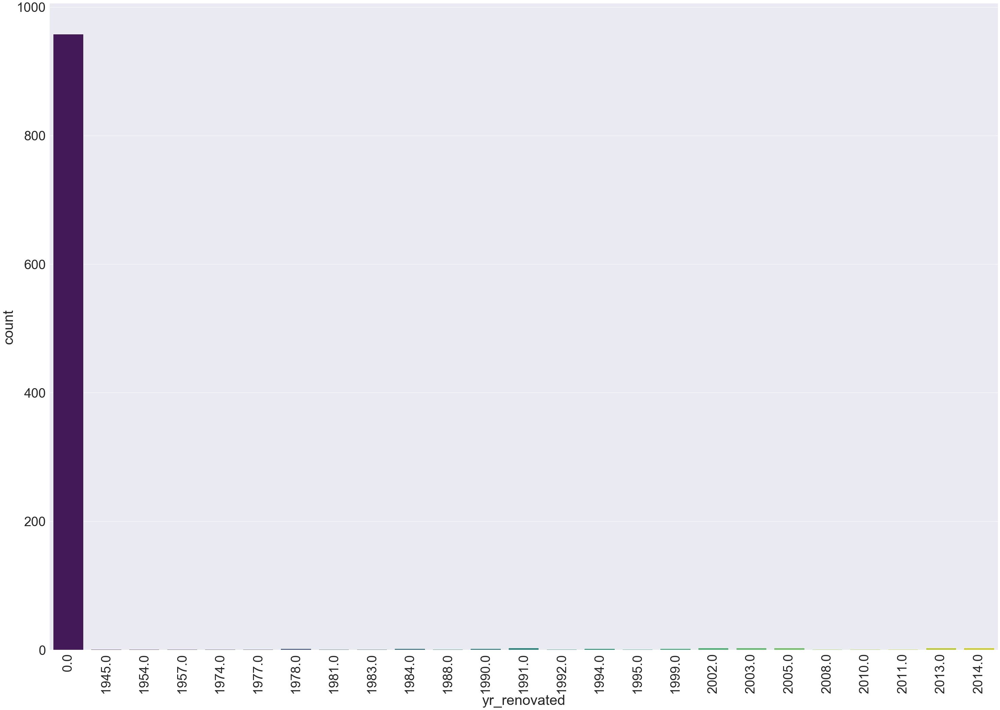

In [136]:
sns.countplot("yr_renovated" , data = df , palette="viridis")
plt.xticks(rotation = 90)

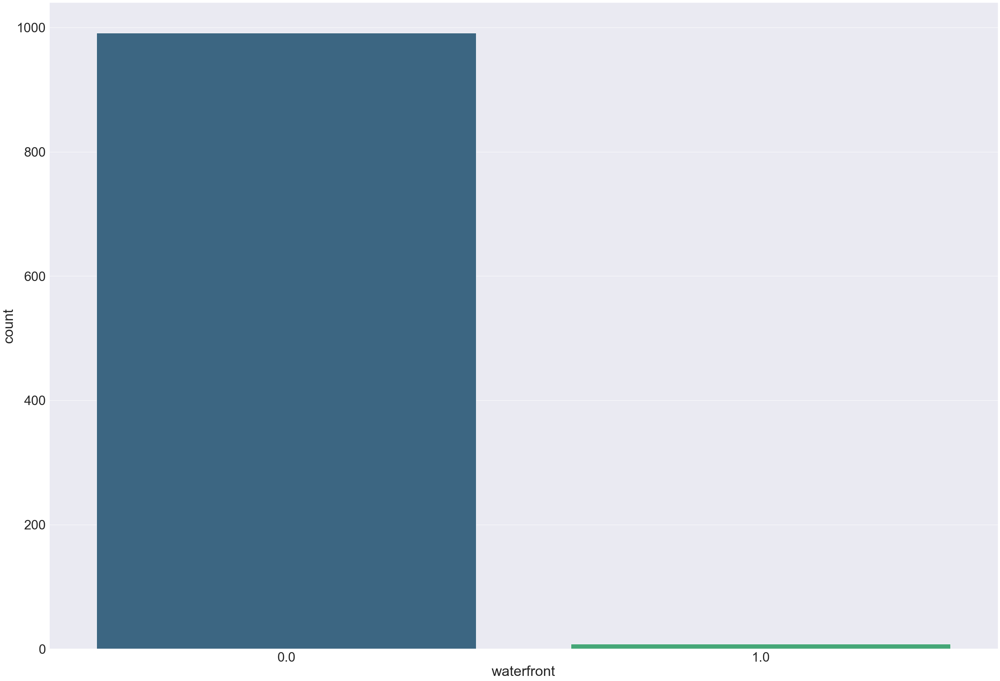

In [137]:
sns.countplot("waterfront" , data = df , palette="viridis")

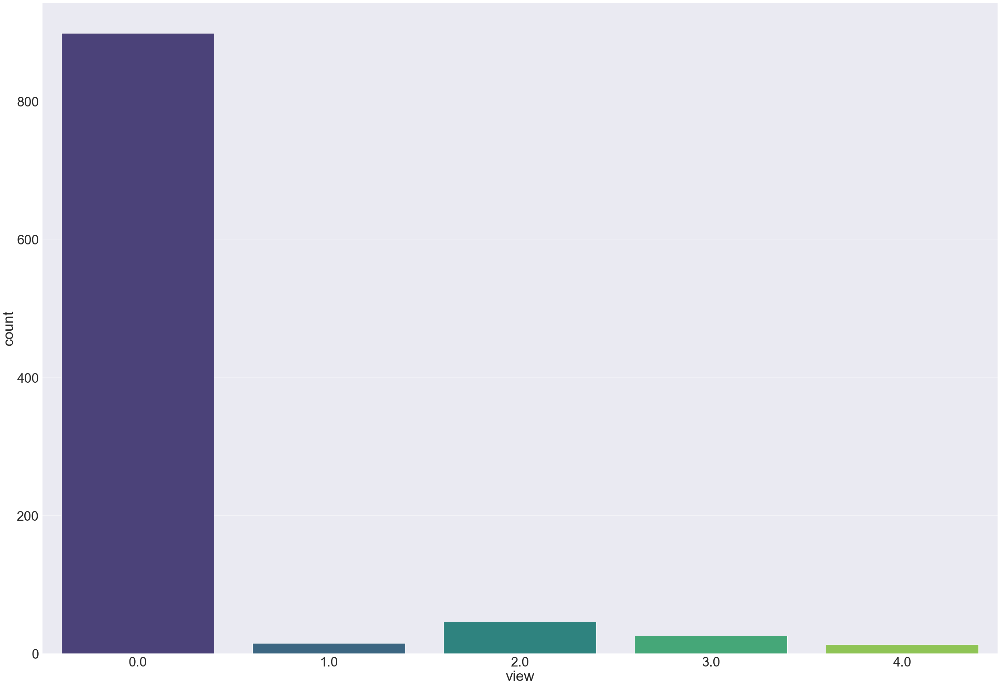

In [138]:
sns.countplot("view" , data = df , palette="viridis")

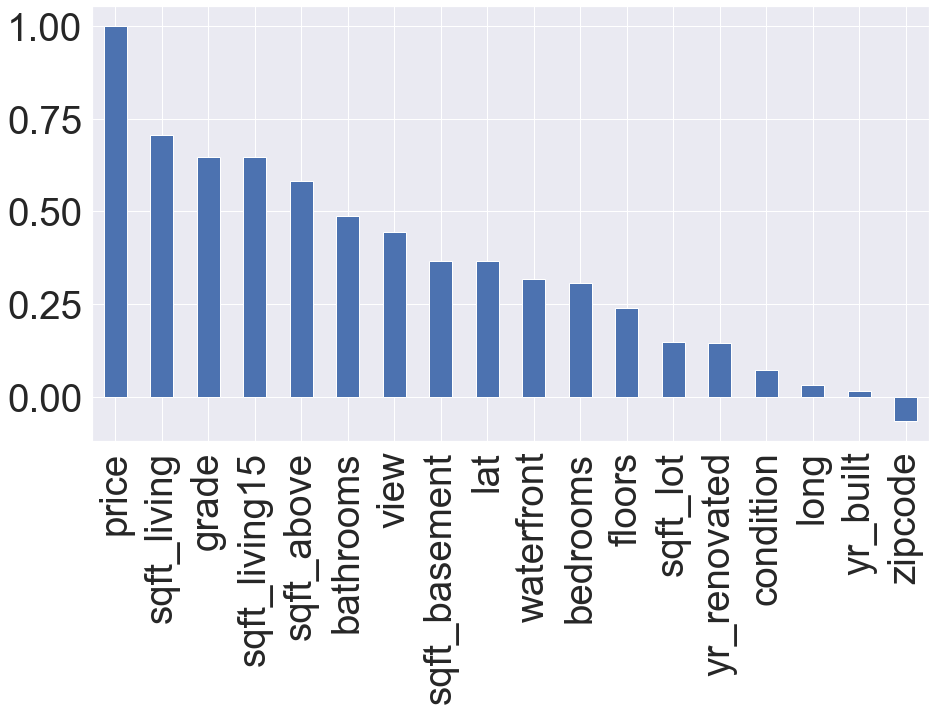

In [139]:
#Get Correlation of "Churn" with other variables:
#sns.set( rc = {"figure.figsize" : [10 , 10]} , font_scale=1.5)

plt.figure(figsize=(15,8))
df.corr()['price'].sort_values(ascending = False).plot(kind='bar'  )

# (5) :: ETL (Extract Transform Load) ::

* Its one of the most important phase in the data scientist life cycle which ::
    * Feature_Engineering Process.
        * Extract New Usefull Features from old useless Feature which not enough to Trian Model.
    * Transform data.
        * Data in the real state not come cleaned it comes Dirty data includes.
            * non_Logic_data_values.
            * Noisy and Errors Values.
            * Missig_data_Values.
            * Duplicatiers and Reapet data.
            * Outliers data_Values.
            * Categorical_Text_data.

# 1- Transform data Values.

* 2 :: *Cleancing data* ::
     * Data in the real state dont comes cleaned is come dirty may include ::
         * non_logic_data_values.
         * Noisy and Errors.
         * Duplicaties data.
         * Missing_data_Values.
            

* 1 :: Identify Duplicaties and Reapets data and drop them

In [140]:
# Identify data include uplicaties or reapet data
df.duplicated().sum()

0

In [141]:
# Drop reapet or Redendant data.
df.drop_duplicates()

,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,price
0,3.0,1.00,1180.0,5650.0,1.0,0.0,0.0,3.0,7.0,1180.0,0.0,1955.0,0.0,98178.0,47.5112,-122.257,1340.0,22.190
1,3.0,2.25,2570.0,7242.0,2.0,0.0,0.0,3.0,7.0,2170.0,400.0,1951.0,1991.0,98125.0,47.7210,-122.319,1690.0,53.800
2,2.0,1.00,770.0,10000.0,1.0,0.0,0.0,3.0,6.0,770.0,0.0,1933.0,0.0,98028.0,47.7379,-122.233,2720.0,18.000
3,4.0,3.00,1960.0,5000.0,1.0,0.0,0.0,5.0,7.0,1050.0,910.0,1965.0,0.0,98136.0,47.5208,-122.393,1360.0,60.400
4,3.0,2.00,1680.0,8080.0,1.0,0.0,0.0,3.0,8.0,1680.0,0.0,1987.0,0.0,98074.0,47.6168,-122.045,1800.0,51.000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
995,4.0,2.50,1860.0,6325.0,2.0,0.0,0.0,4.0,7.0,1860.0,0.0,1991.0,0.0,98038.0,47.3492,-122.030,1860.0,29.100
996,2.0,2.75,1590.0,20917.0,1.5,0.0,0.0,3.0,5.0,1590.0,0.0,1920.0,0.0,98001.0,47.2786,-122.250,1310.0,19.995
997,2.0,1.00,850.0,2340.0,1.0,0.0,0.0,3.0,7.0,850.0,0.0,1922.0,0.0,98105.0,47.6707,-122.328,1300.0,55.350
998,2.0,1.00,1030.0,4188.0,1.0,0.0,0.0,3.0,8.0,1030.0,0.0,1981.0,0.0,98038.0,47.3738,-122.057,1450.0,18.995


* Missing data Values

In [142]:
# Identifing Missing data Value.
df.isnull().sum()

bedrooms         1
bathrooms        1
sqft_living      1
sqft_lot         1
floors           1
waterfront       1
view             1
condition        1
grade            1
sqft_above       1
sqft_basement    1
yr_built         1
yr_renovated     1
zipcode          1
lat              1
long             1
sqft_living15    1
price            1
dtype: int64

* Imputing Numerical_Missing_data_Value.

In [143]:
Total_missing_data = df.isnull().sum().sort_values(ascending =False)
Precentage_Missing_data = (df.isnull().sum()/df.isnull().count()).sort_values(ascending = False)
Missing_data = pd.concat([Total_missing_data , Precentage_Missing_data] , axis = 1 , keys =["Total" , "Precet"])
print(f"The Tatal_missing_data ::\n {Total_missing_data}\n=======\nThe Precentage_Missing_data :: \
\n{Precentage_Missing_data}")

The Tatal_missing_data ::
 price            1
sqft_living15    1
bathrooms        1
sqft_living      1
sqft_lot         1
floors           1
waterfront       1
view             1
condition        1
grade            1
sqft_above       1
sqft_basement    1
yr_built         1
yr_renovated     1
zipcode          1
lat              1
long             1
bedrooms         1
dtype: int64
The Precentage_Missing_data :: 
price            0.001
sqft_living15    0.001
bathrooms        0.001
sqft_living      0.001
sqft_lot         0.001
floors           0.001
waterfront       0.001
view             0.001
condition        0.001
grade            0.001
sqft_above       0.001
sqft_basement    0.001
yr_built         0.001
yr_renovated     0.001
zipcode          0.001
lat              0.001
long             0.001
bedrooms         0.001
dtype: float64


In [144]:
Missing_data

,Total,Precet
price,1,0.001
sqft_living15,1,0.001
bathrooms,1,0.001
sqft_living,1,0.001
sqft_lot,1,0.001
floors,1,0.001
waterfront,1,0.001
view,1,0.001
condition,1,0.001
grade,1,0.001


* Handling Missing data Values.

In [145]:
#Imputing NaN_data_Values int Numerical_Features into Mean
numerical_col = ["price" , "sqft_above" , "sqft_lot" , "sqft_living", "sqft_basement"]
from sklearn.impute import SimpleImputer , KNNImputer 
imp1 = SimpleImputer(strategy="mean")
imp2 = KNNImputer()
for col in numerical_col :
    df[col] = imp1.fit_transform(df)
    #df[col].fillna(df[col].mean() , inplace=True)

* Filling Categorical_Missing_data_Values.

In [146]:
#Imputing NaN_data_Values int Categorical_Features into Mode which most_Frequant
cat_cols = ["bedrooms" , "bathrooms" ,"floors" ,"waterfront" ,"view" ,"condition" , 
            "grade" ,"yr_built" ,"yr_renovated" , "zipcode" , "lat" , "sqft_living15" ,"long"]
for col in cat_cols :
    df[col].fillna(df[col].mode()[0] , inplace=True)

In [147]:
# Investigaty data not include any missing values
df.isnull().sum()

bedrooms         0
bathrooms        0
sqft_living      0
sqft_lot         0
floors           0
waterfront       0
view             0
condition        0
grade            0
sqft_above       0
sqft_basement    0
yr_built         0
yr_renovated     0
zipcode          0
lat              0
long             0
sqft_living15    0
price            0
dtype: int64

* 2 :: non_logic_data_values

In [148]:
# Present all columns Name , unique_numbers and value_counts of that columns.
# identify non_logic_data_values
for col in df.columns :
    print(f"The Col ({col})\n\nThe unique_Values of :: ({col}) :: {df[col].unique()}\n\nThe value_Counts \
f ({col}) :: \n{df[col].value_counts()}\n-------------\n------------------")

The Col (bedrooms)

The unique_Values of :: (bedrooms) :: [3. 2. 4. 5. 1. 6. 7. 0.]

The value_Counts f (bedrooms) :: 
3.0    492
4.0    305
2.0    114
5.0     69
6.0     11
1.0      7
0.0      1
7.0      1
Name: bedrooms, dtype: int64
-------------
------------------
The Col (bathrooms)

The unique_Values of :: (bathrooms) :: [1.   2.25 3.   2.   4.5  1.5  2.5  1.75 2.75 3.25 4.   3.5  0.75 4.75
 5.   4.25 3.75 0.   1.25]

The value_Counts f (bathrooms) :: 
2.50    239
1.00    187
1.75    159
2.25    104
2.00     98
1.50     61
2.75     51
3.00     33
3.50     28
3.25     18
0.75      6
4.00      4
4.25      4
4.50      2
5.00      2
0.00      1
4.75      1
3.75      1
1.25      1
Name: bathrooms, dtype: int64
-------------
------------------
The Col (sqft_living)

The unique_Values of :: (sqft_living) :: [3.         2.         4.         5.         1.         6.
 7.         0.         3.34934935]

The value_Counts f (sqft_living) :: 
3.000000    491
4.000000    305
2.000000    114
5.

In [149]:
# Solve the data_fractions values into integer values.
for col in df.columns :
    df[col] = df[col].apply(lambda x : round(x))

In [150]:
df

,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,price
0,3,1,3,3,1,0,0,3,7,3,3,1955,0,98178,48,-122,1340,3
1,3,2,3,3,2,0,0,3,7,3,3,1951,1991,98125,48,-122,1690,3
2,2,1,2,2,1,0,0,3,6,2,2,1933,0,98028,48,-122,2720,2
3,4,3,4,4,1,0,0,5,7,4,4,1965,0,98136,48,-122,1360,4
4,3,2,3,3,1,0,0,3,8,3,3,1987,0,98074,48,-122,1800,3
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
995,4,2,4,4,2,0,0,4,7,4,4,1991,0,98038,47,-122,1860,4
996,2,3,2,2,2,0,0,3,5,2,2,1920,0,98001,47,-122,1310,2
997,2,1,2,2,1,0,0,3,7,2,2,1922,0,98105,48,-122,1300,2
998,2,1,2,2,1,0,0,3,8,2,2,1981,0,98038,47,-122,1450,2


In [151]:
# Convert Nonlofgic_data_values which have Negative values into intger Values.
df["long"] = df["long"].apply(lambda x : abs(x))

In [152]:
df

,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,price
0,3,1,3,3,1,0,0,3,7,3,3,1955,0,98178,48,122,1340,3
1,3,2,3,3,2,0,0,3,7,3,3,1951,1991,98125,48,122,1690,3
2,2,1,2,2,1,0,0,3,6,2,2,1933,0,98028,48,122,2720,2
3,4,3,4,4,1,0,0,5,7,4,4,1965,0,98136,48,122,1360,4
4,3,2,3,3,1,0,0,3,8,3,3,1987,0,98074,48,122,1800,3
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
995,4,2,4,4,2,0,0,4,7,4,4,1991,0,98038,47,122,1860,4
996,2,3,2,2,2,0,0,3,5,2,2,1920,0,98001,47,122,1310,2
997,2,1,2,2,1,0,0,3,7,2,2,1922,0,98105,48,122,1300,2
998,2,1,2,2,1,0,0,3,8,2,2,1981,0,98038,47,122,1450,2


In [153]:
# Convert non_logic_data values on (bedrooms ,bedrooms ) which its values equal zero into Most frequant
df["bedrooms"] = df["bedrooms"].apply(lambda x : df["bedrooms"].mode()[0] if x == 0 else x)
df["bathrooms"] = df['bathrooms'].apply(lambda x : df["bathrooms"].mode()[0] if x == 0 else x)


In [154]:
df

,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,price
0,3,1,3,3,1,0,0,3,7,3,3,1955,0,98178,48,122,1340,3
1,3,2,3,3,2,0,0,3,7,3,3,1951,1991,98125,48,122,1690,3
2,2,1,2,2,1,0,0,3,6,2,2,1933,0,98028,48,122,2720,2
3,4,3,4,4,1,0,0,5,7,4,4,1965,0,98136,48,122,1360,4
4,3,2,3,3,1,0,0,3,8,3,3,1987,0,98074,48,122,1800,3
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
995,4,2,4,4,2,0,0,4,7,4,4,1991,0,98038,47,122,1860,4
996,2,3,2,2,2,0,0,3,5,2,2,1920,0,98001,47,122,1310,2
997,2,1,2,2,1,0,0,3,7,2,2,1922,0,98105,48,122,1300,2
998,2,1,2,2,1,0,0,3,8,2,2,1981,0,98038,47,122,1450,2


Text(0.5, 1.0, 'Distribution Plot of sqft_living')

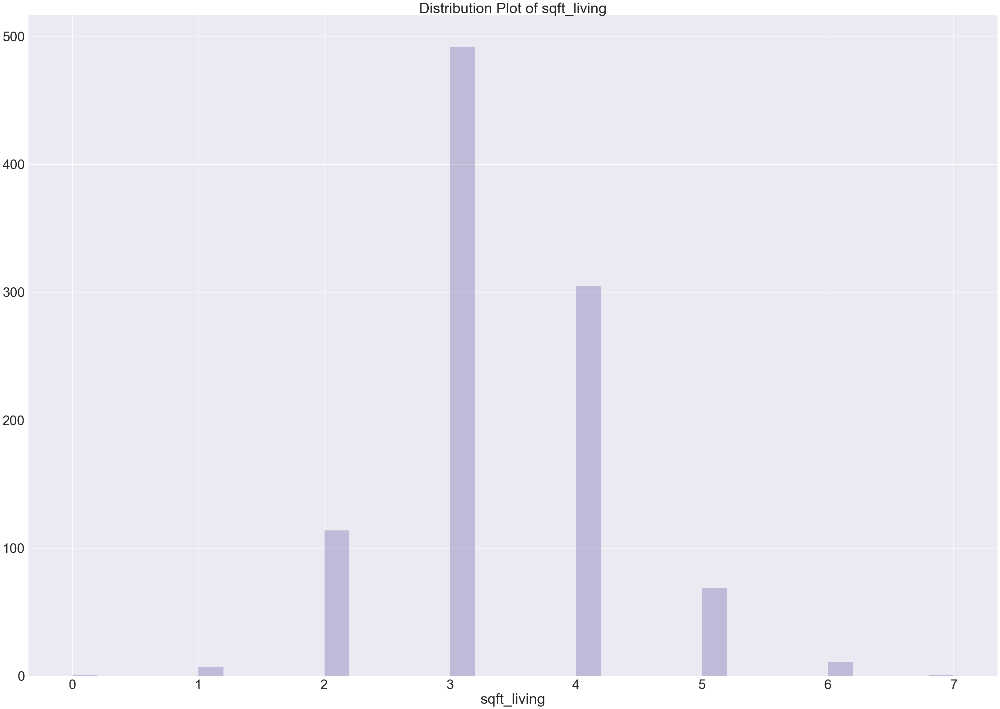

In [155]:
sns.distplot(df["sqft_living"] , kde=False , color="m")
plt.title("Distribution Plot of sqft_living")

Text(0.5, 1.0, 'Kde Plot of sqft_living')

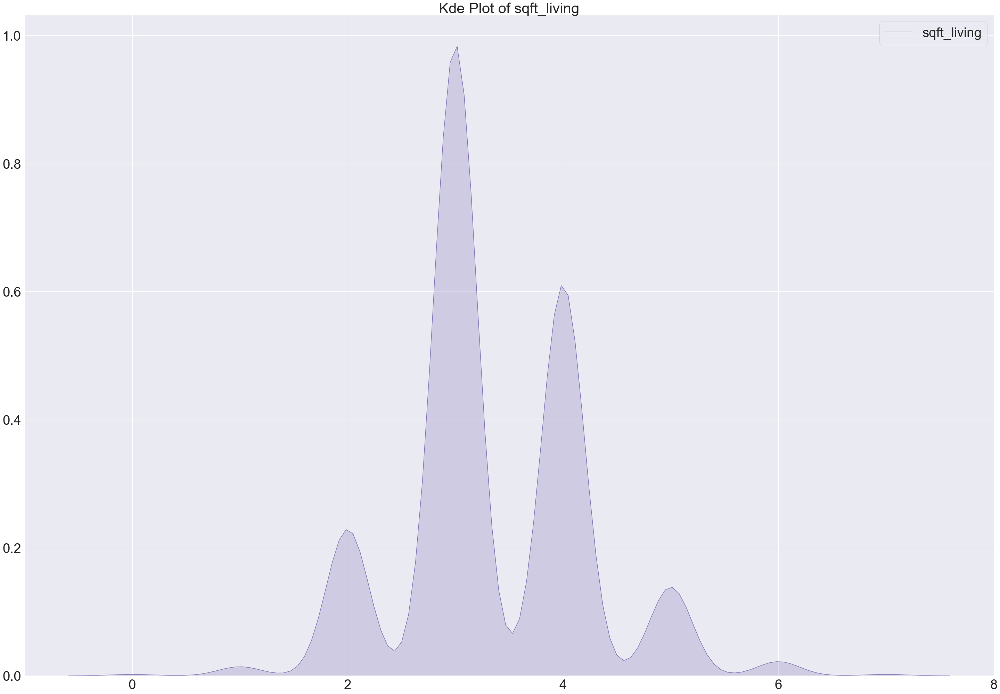

In [156]:
sns.kdeplot(df["sqft_living"] , shade=True , color="m")
plt.title("Kde Plot of sqft_living")

Text(0.5, 1.0, 'Distribution Plot of sqft_lot')

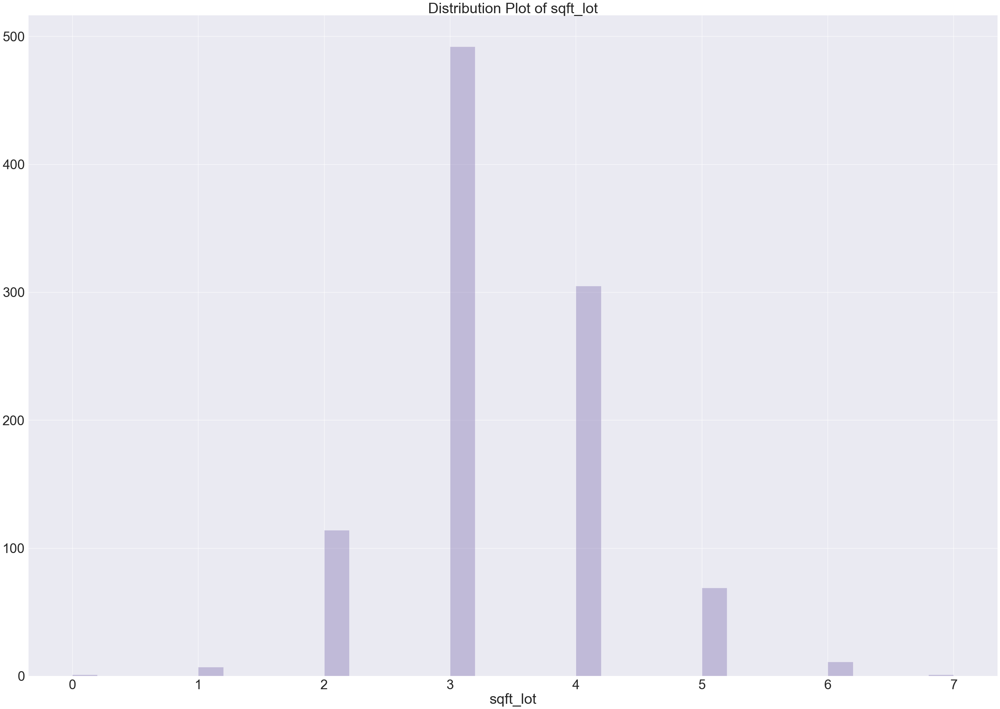

In [157]:
sns.distplot(df["sqft_lot"] , kde=False , color="m")
plt.title("Distribution Plot of sqft_lot")

Text(0.5, 1.0, 'Kde Plot of sqft_lot')

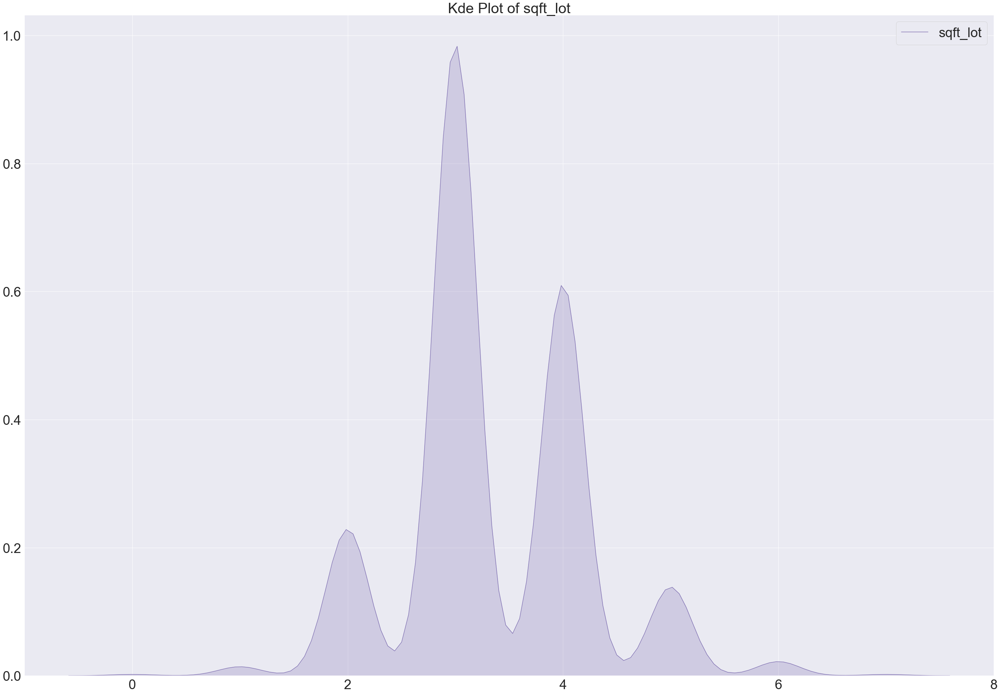

In [158]:
sns.kdeplot(df["sqft_lot"] , shade=True , color="m")
plt.title("Kde Plot of sqft_lot")

Text(0.5, 1.0, 'Distribution Plot of price')

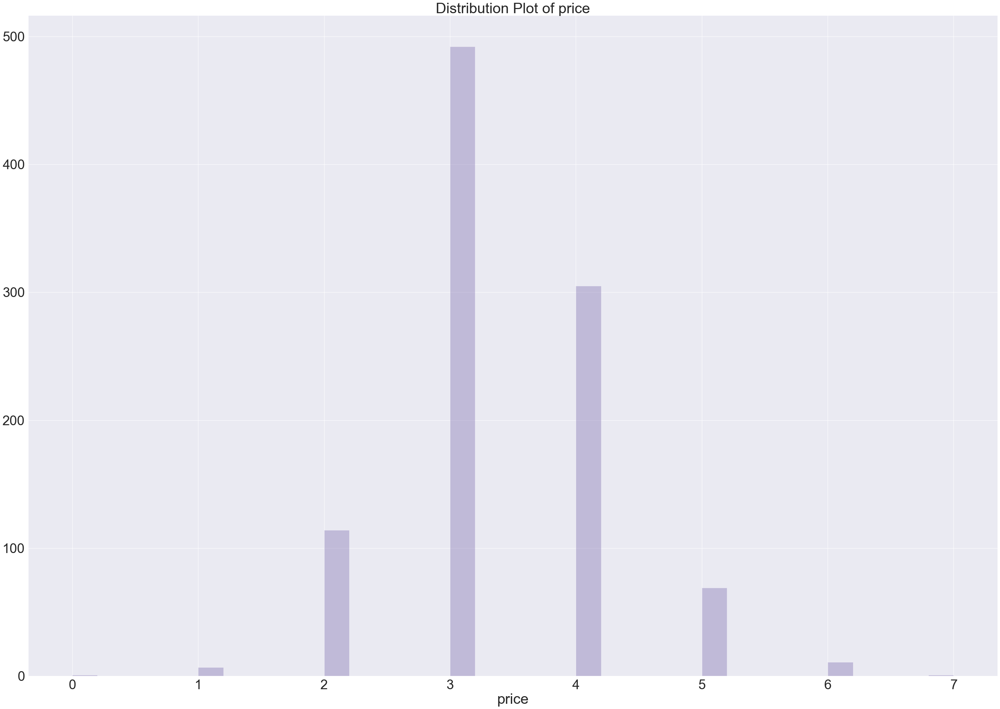

In [159]:
sns.distplot(df["price"] , kde=False , color="m")
plt.title("Distribution Plot of price")

Text(0.5, 1.0, 'Kde Plot of price')

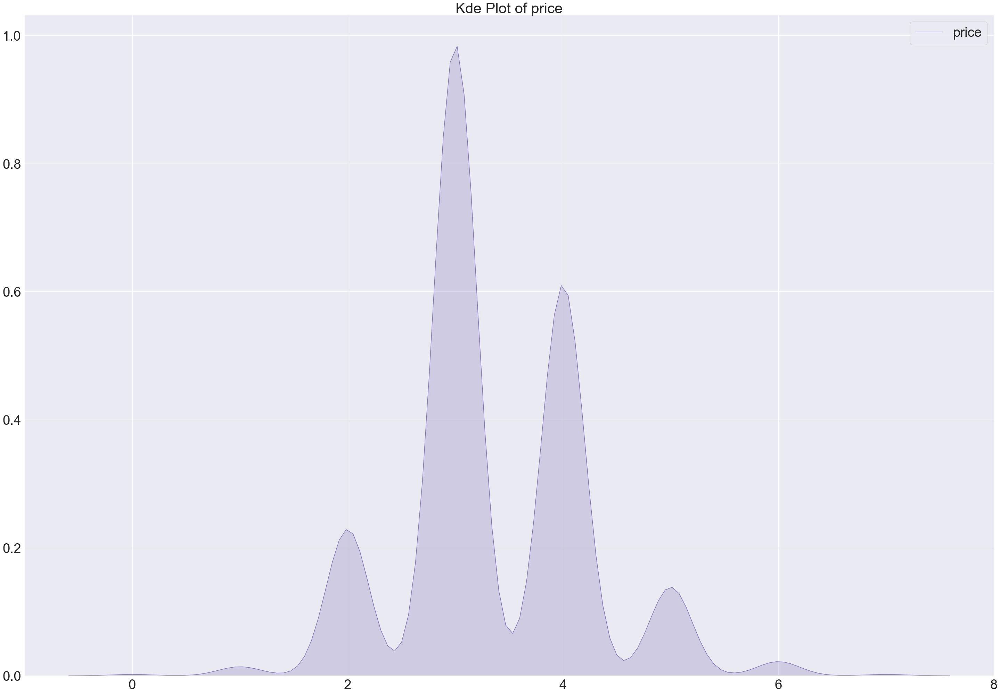

In [160]:
sns.kdeplot(df["price"] , shade=True , color="m")
plt.title("Kde Plot of price")

In [161]:
# Investigateing data is Cleaned
for col in df.columns :
    print(f"The Col ({col})\n\nThe unique_Values of :: ({col}) :: {df[col].unique()}\n\nThe value_Counts \
f ({col}) :: \n{df[col].value_counts()}\n-------------\n------------------")

The Col (bedrooms)

The unique_Values of :: (bedrooms) :: [3 2 4 5 1 6 7]

The value_Counts f (bedrooms) :: 
3    493
4    305
2    114
5     69
6     11
1      7
7      1
Name: bedrooms, dtype: int64
-------------
------------------
The Col (bathrooms)

The unique_Values of :: (bathrooms) :: [1 2 3 4 5]

The value_Counts f (bathrooms) :: 
2    662
1    194
3    102
4     39
5      3
Name: bathrooms, dtype: int64
-------------
------------------
The Col (sqft_living)

The unique_Values of :: (sqft_living) :: [3 2 4 5 1 6 7 0]

The value_Counts f (sqft_living) :: 
3    492
4    305
2    114
5     69
6     11
1      7
7      1
0      1
Name: sqft_living, dtype: int64
-------------
------------------
The Col (sqft_lot)

The unique_Values of :: (sqft_lot) :: [3 2 4 5 1 6 7 0]

The value_Counts f (sqft_lot) :: 
3    492
4    305
2    114
5     69
6     11
1      7
7      1
0      1
Name: sqft_lot, dtype: int64
-------------
------------------
The Col (floors)

The unique_Values of :: (floor

# 2- Feature_Engineering Process

* Feature Engineering Process ::
    * Its one of the Most important phase on data Scientist Life_cycle which we generate new useefull Features from old Features Useless and not enough to Train Model.
    

In [162]:
df

,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,price
0,3,1,3,3,1,0,0,3,7,3,3,1955,0,98178,48,122,1340,3
1,3,2,3,3,2,0,0,3,7,3,3,1951,1991,98125,48,122,1690,3
2,2,1,2,2,1,0,0,3,6,2,2,1933,0,98028,48,122,2720,2
3,4,3,4,4,1,0,0,5,7,4,4,1965,0,98136,48,122,1360,4
4,3,2,3,3,1,0,0,3,8,3,3,1987,0,98074,48,122,1800,3
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
995,4,2,4,4,2,0,0,4,7,4,4,1991,0,98038,47,122,1860,4
996,2,3,2,2,2,0,0,3,5,2,2,1920,0,98001,47,122,1310,2
997,2,1,2,2,1,0,0,3,7,2,2,1922,0,98105,48,122,1300,2
998,2,1,2,2,1,0,0,3,8,2,2,1981,0,98038,47,122,1450,2


* From the Result above we can see some Observations ::
    * From The Zipcode Features We cann generate some usefull Features.
    * From The Lat and Long Features We Can generate some usefull Features also.

* Generate new usefull features from zipcode column

In [163]:
# Import Zipcode Liberary
import zipcodes as ZIP
# Create fun to generating new Usefull Features
def zipcode_data (Zip) :
    Zip = str(Zip)
    res = ZIP.matching(Zip)[0]
    city    = res["city"]
    country = res["country"]
    state   = res["state"]
    # tery to get that new Features and if not found value return nan
    try :
        return pd.Series((city , country , state))
    except :
        return np.nan
    

In [164]:
# Apply zipcode_data func on zipcode Column.
df[["City" , "Country" , "state"]] = df["zipcode"].apply(zipcode_data)

In [165]:
# present the new_features
df[["City" , "Country" , "state"]]

,City,Country,state
0,Seattle,US,WA
1,Seattle,US,WA
2,Kenmore,US,WA
3,Seattle,US,WA
4,Sammamish,US,WA
...,...,...,...
995,Maple Valley,US,WA
996,Auburn,US,WA
997,Seattle,US,WA
998,Maple Valley,US,WA


(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
        17, 18, 19, 20, 21, 22]), <a list of 23 Text xticklabel objects>)

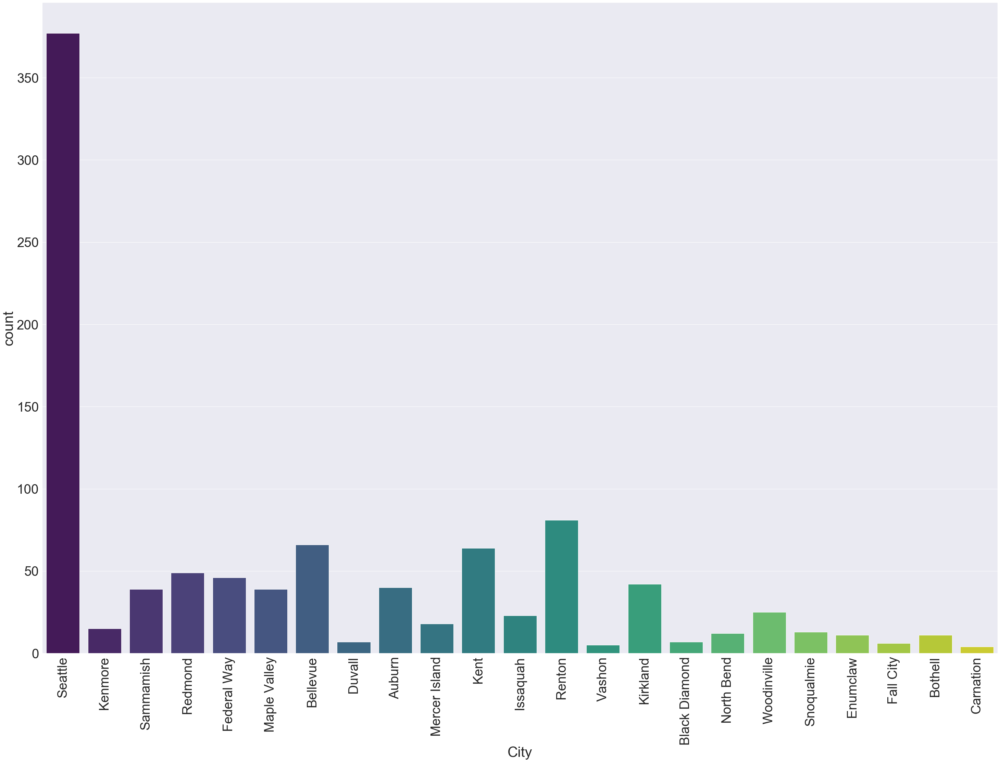

In [166]:
sns.countplot( "City" , data =df , palette="viridis")
plt.xticks(rotation = 90)

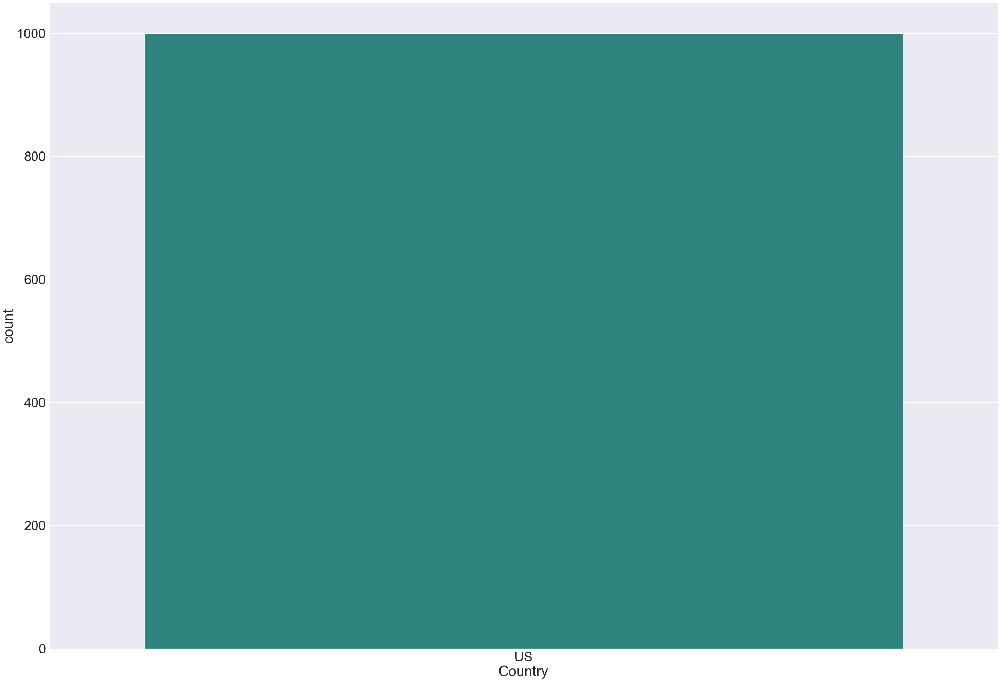

In [167]:
sns.countplot( "Country" , data =df , palette="viridis")


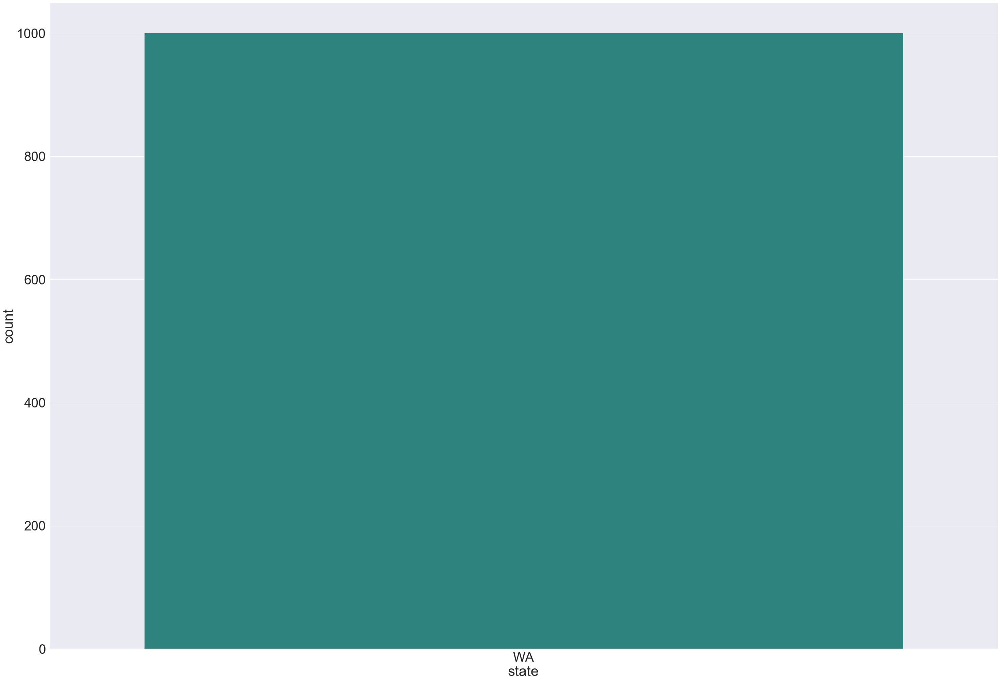

In [168]:
sns.countplot( "state" , data =df , palette="viridis")


* generate Adress from latitude and Longitude Features

In [169]:
from geopy.geocoders import Nominatim as NomI
def Address_data (lat , long) :
    lat  = str(lat)
    long = str(long)
    gecode   = NomI(user_agent = "Turkey")
    location = gecode.reverse(lat , long)
    Address = location.address
    try :
        return Address
    except :
        return np.nan
    

In [170]:
df.columns

Index(['bedrooms', 'bathrooms', 'sqft_living', 'sqft_lot', 'floors',
       'waterfront', 'view', 'condition', 'grade', 'sqft_above',
       'sqft_basement', 'yr_built', 'yr_renovated', 'zipcode', 'lat', 'long',
       'sqft_living15', 'price', 'City', 'Country', 'state'],
      dtype='object')

In [171]:
df.drop(['City', 'Country', 'state'] , axis=1 , inplace=True)

* 3 :: *Data_Preprocessing* ::
    * Data may include ::
        * Outliers values.
        * Impalanced classes.
        * Text data.

* Outliers data values

Text(0.5, 1.0, 'Present Outliers values')

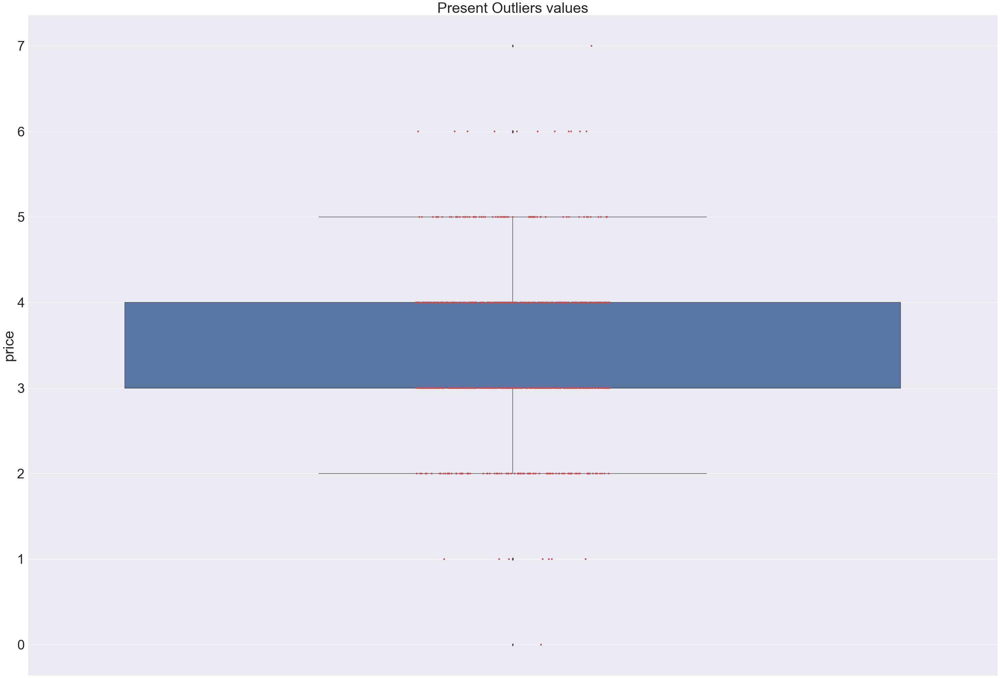

In [172]:
# identify Prices include outliers data_values
sns.boxplot(y = "price"  , data = df )
sns.stripplot(y = "price"  , data = df , color = "r" )
plt.title("Present Outliers values")


In [173]:
# Handling Outliers Values of data
from datasist.structdata import detect_outliers
outliers = detect_outliers(df ,0 , df.columns)
df.drop(outliers , inplace = True)

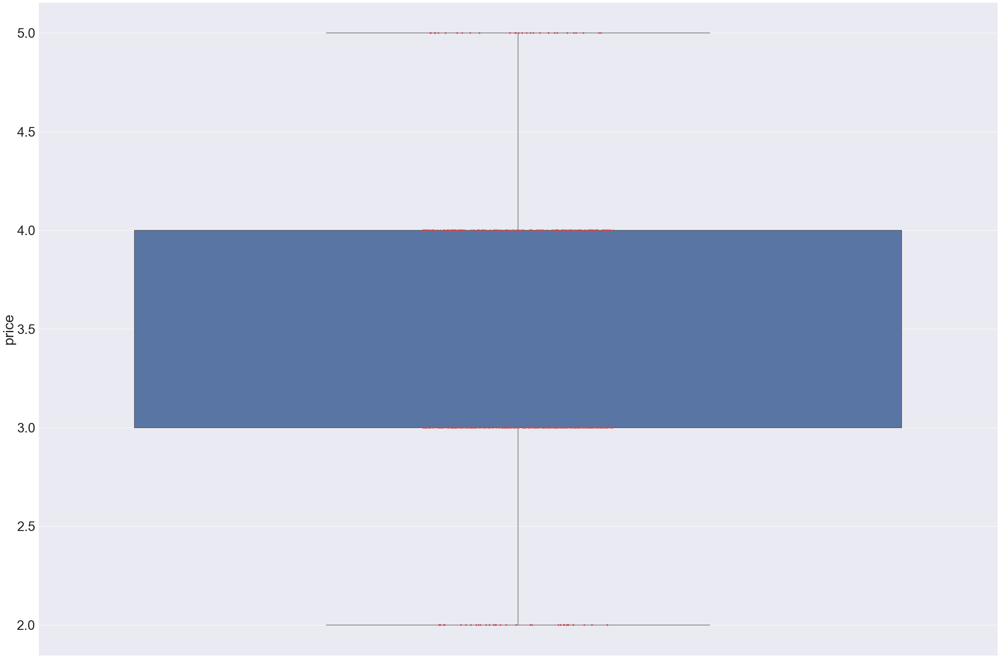

In [174]:
sns.boxplot(y = "price"  , data = df )
sns.stripplot(y = "price"  , data = df , color = "r" )

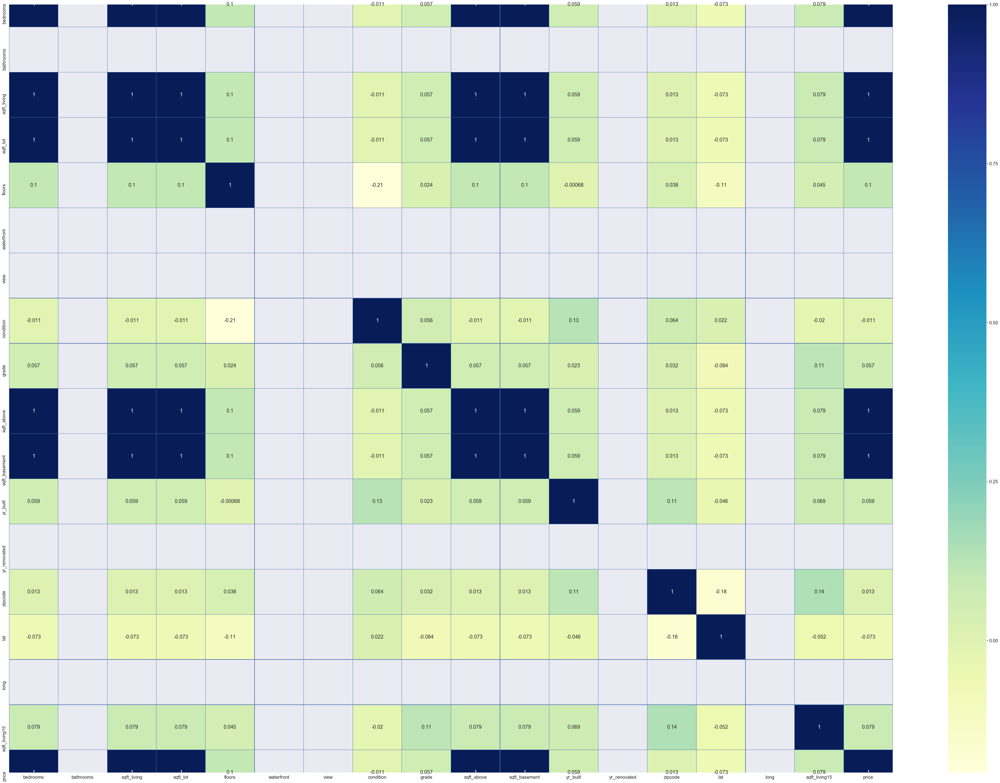

In [175]:
sns.set( rc = {"figure.figsize" : [70 , 50]} , font_scale=1.5)
corr = df.apply(lambda x: pd.factorize(x)[0]).corr()
ax = sns.heatmap(corr, xticklabels=corr.columns, yticklabels=corr.columns, 
                 linewidths=.2, cmap="YlGnBu", annot=True , linecolor="b")

* Skwenss_data ::
    * Its one of the most important Technical_Method To identify the ditribution of data symetric or have Skwenss To left or Right.
    * That Skwenss leat Model Bias Towards single columns.
    * But we want data in Normal distribution .

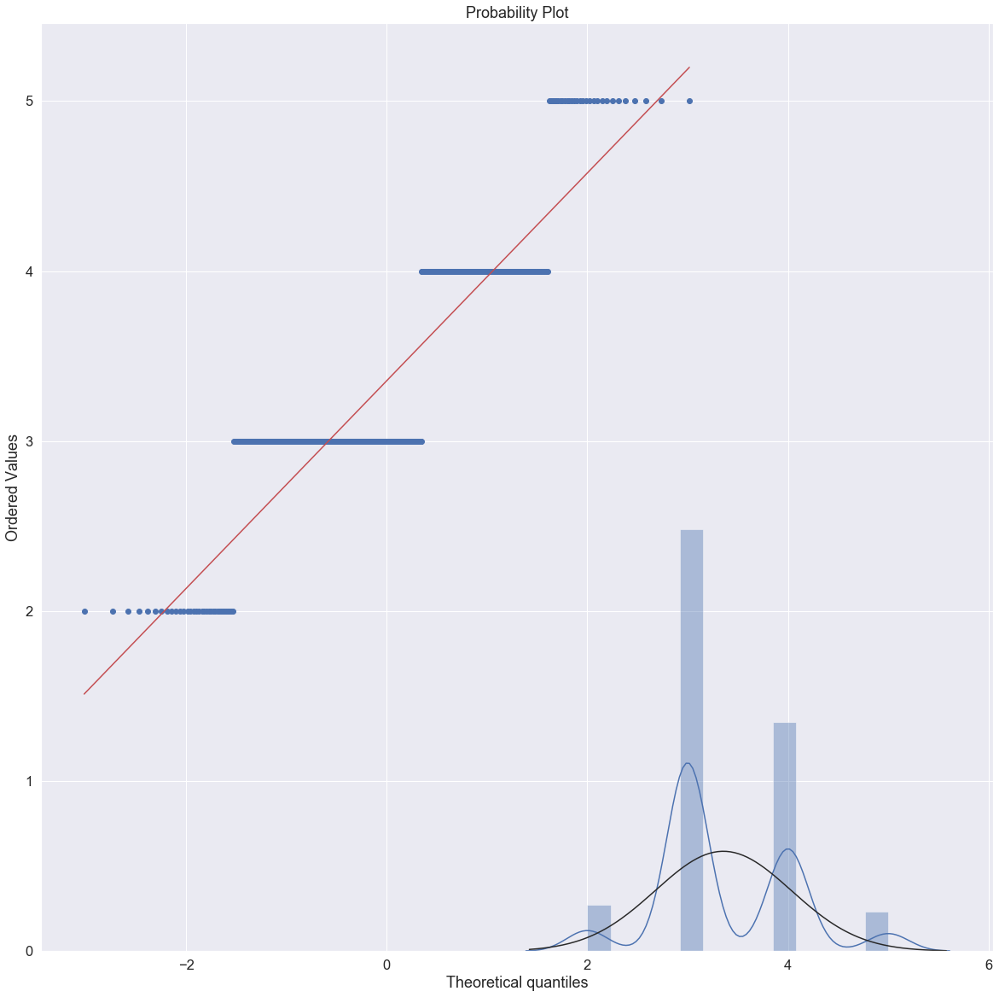

In [179]:
# Identify data of Price in the Normal_distribution or not ::
sns.set( rc = {"figure.figsize" : [20 , 20]} , font_scale=1.5)
sns.distplot(df["price"] , fit = norm)
res = stats.probplot(df["price"] , plot = plt)

* Handling Categorical_Text_data :: 
    * Its one of the Most common Issue which consider us on data_preprocessing Phase.

* Text_data ::
    * Encoding_categorical_data Using ::
        * one Hot Encoding.
        * dummies Variables Encoding.
    

* dummies Variables Encoding ::
    * Its one of the most efficient Technical_Method which use to convert Categorical_Text data into Numerical data 
    
        * Becouse the ML Model not Understanding the Textular data it Understanding Numerical data only.
        * And That Techince less the Time of The Model Training.

In [181]:
df

,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,price
4,3,2,3,3,1,0,0,3,8,3,3,1987,0,98074,48,122,1800,3
6,3,2,3,3,2,0,0,3,7,3,3,1995,0,98003,47,122,2238,3
7,3,2,3,3,1,0,0,3,7,3,3,1963,0,98198,47,122,1650,3
9,3,2,3,3,2,0,0,3,7,3,3,2003,0,98038,47,122,2390,3
10,3,2,3,3,1,0,0,3,8,3,3,1965,0,98007,48,122,2210,3
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
990,4,2,4,4,1,0,0,4,8,4,4,1960,0,98005,48,122,2260,4
991,4,2,4,4,1,0,0,4,8,4,4,1952,0,98115,48,122,1520,4
993,3,2,3,3,1,0,0,3,7,3,3,1988,0,98003,47,122,1590,3
995,4,2,4,4,2,0,0,4,7,4,4,1991,0,98038,47,122,1860,4


In [182]:
df = pd.get_dummies(df  , drop_first=True)

# (6) :: Prepration data for Train and Test Model :
*******************************************************************************
* Its one of the most important on data scientist life_cycly ..
    * Split data into Input Features and Output which our Target.
    * Split data into Training for Learning Model and Testing data for Estimate Model.
    

In [183]:
# split data into input features and Output(Target)
x = df.drop(["price"] ,  axis=1)
y = df["price"]

In [184]:
y

4      3
6      3
7      3
9      3
10     3
      ..
990    4
991    4
993    3
995    4
999    3
Name: price, Length: 543, dtype: int64

In [185]:
# Import reProcessing Technices as Spliter and scaler Technices
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler


In [186]:
# Spliting data into Trai and Test data
x_train , x_test , y_train , y_test = train_test_split(x , y , test_size=0.2 , shuffle=True , random_state=20)


# (7) :: Scalling data in the normal distribution .
*******************************************************
* Its on of the Most important phase of data scientist Life_cycle.
    * Features of data may have diffirent scalling values The increase Time of Model Training so that we Normalize data on the normal_distribution To make all scallr of the data Features on the Normal_distribution.

In [187]:
# Scalling data in the Normal_dstribution that process define as data Normalization
scaller = StandardScaler()
x_train= scaller.fit_transform(x_train)
x_test = scaller.transform(x_test)

In [188]:
for col in df.columns :
    print(f"The col :: ({col})\n\nThe value_counts :: \n{df[col].value_counts()}\n-----------\n-----------")

The col :: (bedrooms)

The value_counts :: 
3    311
4    169
2     34
5     29
Name: bedrooms, dtype: int64
-----------
-----------
The col :: (bathrooms)

The value_counts :: 
2    543
Name: bathrooms, dtype: int64
-----------
-----------
The col :: (sqft_living)

The value_counts :: 
3    311
4    169
2     34
5     29
Name: sqft_living, dtype: int64
-----------
-----------
The col :: (sqft_lot)

The value_counts :: 
3    311
4    169
2     34
5     29
Name: sqft_lot, dtype: int64
-----------
-----------
The col :: (floors)

The value_counts :: 
1    278
2    252
3     13
Name: floors, dtype: int64
-----------
-----------
The col :: (waterfront)

The value_counts :: 
0    543
Name: waterfront, dtype: int64
-----------
-----------
The col :: (view)

The value_counts :: 
0    543
Name: view, dtype: int64
-----------
-----------
The col :: (condition)

The value_counts :: 
3    333
4    154
5     54
2      2
Name: condition, dtype: int64
-----------
-----------
The col :: (grade)

The 

# (8) :: Bulding Models For Regression

In [189]:
# Importing ML Models For Regression.
from sklearn.linear_model import LinearRegression , Ridge 
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor
from sklearn.svm import SVR
from xgboost import XGBRegressor 

* Cearting dictionry of all Models we Use to identify the Performance and accuracy of them and Select the Most efficient Model With high Performance ang High Accuracy.

In [190]:
# Loding_ML_Models in dictionary .
Models = {"LR"  : LinearRegression() , 
          "DT"  : DecisionTreeRegressor() , 
          "RF"  : RandomForestRegressor() ,
          "XGB" : XGBRegressor() ,
          "SvR" : SVR() ,
          "Ridge" : Ridge() 
          
    
}

In [191]:
# Comparing among ML_Models and select the most efficient Model with high Performance and high accuracy
for Name , Model in Models.items() :
    print(f"The Mode :: {Name}\n")
    Model.fit(x_train , y_train)
    Train_score = Model.score(x_train , y_train)
    Test_score = Model.score(x_test , y_test)
    print(f"The Training_Score :: {Train_score}\n")
    print(f"The Testing_Score :: {Test_score}\n")
    print("*" * 80)

The Mode :: LR

The Training_Score :: 1.0

The Testing_Score :: 1.0

********************************************************************************
The Mode :: DT

The Training_Score :: 1.0

The Testing_Score :: 1.0

********************************************************************************
The Mode :: RF

The Training_Score :: 1.0

The Testing_Score :: 1.0

********************************************************************************
The Mode :: XGB

The Training_Score :: 0.9999999926195483

The Testing_Score :: 0.9999999930266376

********************************************************************************
The Mode :: SvR

The Training_Score :: 0.9920438266518415

The Testing_Score :: 0.9835323806381997

********************************************************************************
The Mode :: Ridge

The Training_Score :: 0.999999744420563

The Testing_Score :: 0.9999997432669587

********************************************************************************


# (9) :: Select most efficient model with high Performance and accuracy

In [192]:
# Bulid SVR Model For regression
SVR_Model = SVR()
SVR_Model.fit(x_train , y_train)
y_pred = SVR_Model.predict(x_test)
Training_Score = SVR_Model.score(x_train , y_train)
Testing_Score  = SVR_Model.score(x_test , y_test)
print(f"The Training_Score :: {Training_Score}\nTesting_Score :: {Testing_Score}")

The Training_Score :: 0.9920438266518415
Testing_Score :: 0.9835323806381997


# (10) :: Estimate and Evaluate model accuracy

In [193]:
# estimate and Evaluate Model ::
from sklearn.metrics import mean_absolute_error , mean_squared_error , median_absolute_error , r2_score
MAE = mean_absolute_error(y_test , y_pred , multioutput="uniform_average")
MSE = mean_squared_error(y_pred , y_test , multioutput="uniform_average")
Med_AE = median_absolute_error(y_pred , y_test , multioutput="uniform_average")
r2_square = r2_score(y_pred , y_test , multioutput="uniform_average")
print(f"The MAE :: {MAE}\nThe MSE :: {MSE}\nThe Med_AE :: {Med_AE}\nThe r2_square :: {r2_square} ")

The MAE :: 0.06485453054457375
The MSE :: 0.007149228235684347
The Med_AE :: 0.05358671259276582
The r2_square :: 0.9823459553100341 


# (11) :: Loading the scaler and Model as file :: 
*****************************
* To not Lunch the kernal and notebook from scratch hen we need to Predict New_House_Price

In [194]:
import joblib
scaler = joblib.dump(scaller , "scaler.h5")
Model  = joblib.dump(SVR_Model , "SVR_Model.h5")

# (12) :: Prediction New_house value

In [195]:
x.columns

Index(['bedrooms', 'bathrooms', 'sqft_living', 'sqft_lot', 'floors',
       'waterfront', 'view', 'condition', 'grade', 'sqft_above',
       'sqft_basement', 'yr_built', 'yr_renovated', 'zipcode', 'lat', 'long',
       'sqft_living15'],
      dtype='object')

In [196]:
df

,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,price
4,3,2,3,3,1,0,0,3,8,3,3,1987,0,98074,48,122,1800,3
6,3,2,3,3,2,0,0,3,7,3,3,1995,0,98003,47,122,2238,3
7,3,2,3,3,1,0,0,3,7,3,3,1963,0,98198,47,122,1650,3
9,3,2,3,3,2,0,0,3,7,3,3,2003,0,98038,47,122,2390,3
10,3,2,3,3,1,0,0,3,8,3,3,1965,0,98007,48,122,2210,3
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
990,4,2,4,4,1,0,0,4,8,4,4,1960,0,98005,48,122,2260,4
991,4,2,4,4,1,0,0,4,8,4,4,1952,0,98115,48,122,1520,4
993,3,2,3,3,1,0,0,3,7,3,3,1988,0,98003,47,122,1590,3
995,4,2,4,4,2,0,0,4,7,4,4,1991,0,98038,47,122,1860,4


In [197]:
custom_data = np.array([ 3 , 1 , 3 , 4 , 2 , 1 , 1 , 3 , 6 , 4 , 4 ,1990 , 0 , 98074 , 47 , 122  ,1800])

In [198]:
custom_data.shape

(17,)

In [199]:
custom_data  = scaller.transform([custom_data])
custom_data

array([[-0.51538528, -1.        , -0.51538528,  0.94655728,  0.92924071,
         1.        ,  1.        , -0.70284681, -2.09493996,  0.94655728,
         0.94655728,  0.5754077 ,  0.        ,  0.17426949, -1.16563101,
         0.        , -0.1942178 ]])

In [200]:
prediction = SVR_Model.predict(custom_data)
prediction

array([3.54015705])

In [201]:
prediction = int(prediction)

In [202]:
prediction

3

# Insert New_data of Client for regression its Churn

* The Sequantial of input Features

* Features Sequantial ::
    * *bedrooms*
    * *bathrooms*
    * *sqft_living*
    * *sqft_lot*
    * *floors*
    * *waterfront*
    * *view*
    * *condition*
    * *grade*
    * *sqft_above*
    * *sqft_basement*
    * *yr_built*
    * *yr_renovated*
    * *zipcode*
    * *lat*
    * *long*
    * *sqft_living15*

In [203]:
from sklearn.svm import SVR


# Cearte Function For Regression House Price ::

In [204]:
def Prediction_House_Price () :
    Bedrooms = int(input("Enter Number of bedrooms PLZ :: "))
    Bathrooms = int(input("Enter Number of Bathrooms PLZ :: "))
    Sqft_living = int(input("Enter Number of Sqft_living PLZ :: "))
    Sqft_lot = int(input("Enter Number of Sqft_lot PLZ :: "))
    Floors = int(input("Enter Number of Floors PLZ :: "))
    Waterfront = int(input("Enter Number of Waterfront PLZ :: "))
    View = int(input("Enter Number of View PLZ :: "))
    Condition = int(input("Enter Number of Condition PLZ :: "))
    Grade = int(input("Enter Number of Grade PLZ :: "))
    Sqft_above = int(input("Enter Number of Sqft_above PLZ :: "))
    Sqft_basement = int(input("Enter Number of Sqft_basement PLZ :: "))
    yearr_built = int(input("Enter Number of yr_built PLZ :: "))
    yearr_renovated = int(input("Enter Number of yr_renovated PLZ :: "))
    Zipcode = int(input("Enter Number of Zipcode PLZ :: "))
    Lat = int(input("Enter Number of Lat PLZ :: "))
    Long = int(input("Enter Number of Long PLZ :: "))
    Sqft_living15 = int(input("Enter Number of Sqft_living15 PLZ :: "))
    
    prediction_feature = {"Bedrooms" : Bedrooms , "Bathrooms" : Bathrooms , "Sqft_living" : Sqft_living ,\
                        "Sqft_lot" : Sqft_lot , "Floors" : Floors , "Waterfront" : Waterfront ,\
                        "View" : View , "Condition" : Condition , "Grade" : Grade ,\
                        "Sqft_above" : Sqft_above ,"Sqft_basement" : Sqft_basement ,\
                        "yearr_built" :yearr_built , "yearr_renovated"  : yearr_renovated ,\
                        "Zipcode" : Zipcode , "Lat" :Lat , "Long" : Long ,\
                        "Sqft_living15" : Sqft_living15 
                       
                       }
    
    
    #SVR_Model.fit(x_train , y_train)
    custom_data_values = np.array(list(prediction_feature.values()))
    custom_data_values = scaller.transform([custom_data_values])
    prediction_Price = SVR_Model(custom_data_values)
    print(f"The Prediction_Price of House :: {prediction_Price}\n-------------\n")
    print("Thx To use our Prediction App My Client (^ _ ^)")
    
    